# The Goal of this Project

*In this project, your goal is to write a software pipeline to identify cars in a video from a front-facing camera on a car.* 

## Project Steps
1. Gather training examples
2. Perform Feature Engineering
3. Train and evaluate different classifiers
4. Perspective Spatial Transform (window search)
5. Classify
6. Filter false-positives
7. Show live detection on video

In [1]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import cv2
import glob

# Divide up into cars and notcars
cars = glob.glob('./training/vehicles/GTI_*/*.png')
# cars.extend(glob.glob('./training/vehicles/GTI_*/*.jpg'))
# cars.extend(glob.glob('./training/vehicles/KIT*/*.png'))
notcars = glob.glob('./training/non-vehicles/GTI/*.png')
# notcars.extend(glob.glob('./training/non-vehicles/Ex*/*.png'))


In [2]:
# fnames = glob.glob('./training/vehicles/GTI_*/*.jpg')
# for fname in fnames:
#     ima = cv2.imread(fname)
#     ima = cv2.resize(ima, (64,64))
#     cv2.imwrite(fname, ima)
# glob.glob('./training/vehicles/GTI_*/*.jpg')

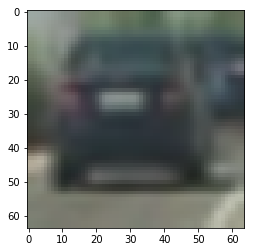

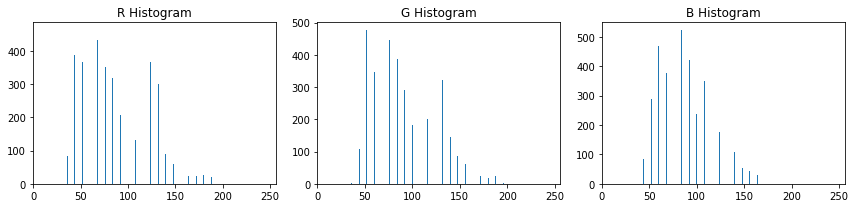

In [3]:
# Define a function to compute color histogram features  
def color_hist(img, nbins=32, bins_range=(0, 256)):
    # Compute the histogram of the RGB channels separately
    rhist = np.histogram(img[:,:,0], bins=nbins, range=bins_range)
    ghist = np.histogram(img[:,:,1], bins=nbins, range=bins_range)
    bhist = np.histogram(img[:,:,2], bins=nbins, range=bins_range)
    # Generating bin centers
    bin_edges = rhist[1]
    bin_centers = (bin_edges[1:]  + bin_edges[0:len(bin_edges)-1])/2
    # Concatenate the histograms into a single feature vector
    hist_features = np.concatenate((rhist[0], ghist[0], bhist[0]))
    # Return the individual histograms, bin_centers and feature vector
    return rhist, ghist, bhist, bin_centers, hist_features
    
img = cv2.imread(cars[0])
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
rh, gh, bh, bincen, feature_vec = color_hist(img, nbins=32, bins_range=(0, 256))

# Plot a figure with all three bar charts
if rh is not None:
    fig = plt.figure(figsize=(12,3))
    plt.subplot(131)
    plt.bar(bincen, rh[0])
    plt.xlim(0, 256)
    plt.title('R Histogram')
    plt.subplot(132)
    plt.bar(bincen, gh[0])
    plt.xlim(0, 256)
    plt.title('G Histogram')
    plt.subplot(133)
    plt.bar(bincen, bh[0])
    plt.xlim(0, 256)
    plt.title('B Histogram')
    fig.tight_layout()
else:
    print('Your function is returning None for at least one variable...')

Text(0.5,1,'Spatially Binned Features')

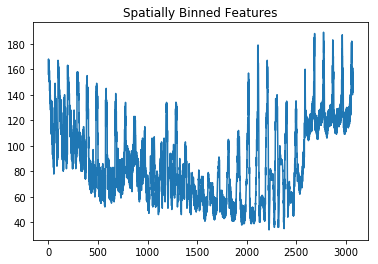

In [4]:
# Define a function to compute color histogram features  
# Pass the color_space flag as 3-letter all caps string
# like 'HSV' or 'LUV' etc.

# Define a function to compute color histogram features  
# Pass the color_space flag as 3-letter all caps string
# like 'HSV' or 'LUV' etc.
def bin_spatial(img, size=(32, 32)):
             
    # Use cv2.resize().ravel() to create the feature vector
    features = cv2.resize(img, size).ravel() 
    # Return the feature vector
    return features
    
feature_vec = bin_spatial(img, size=(32, 32))

# Plot features
plt.plot(feature_vec)
plt.title('Spatially Binned Features')

In [5]:
from skimage.feature import hog

# Define a function to return HOG features and visualization
def get_hog_features(img, orient, pix_per_cell, cell_per_block, 
                        vis=False, feature_vec=True):
    # Call with two outputs if vis==True
    if vis == True:
        features, hog_image = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), block_norm= 'L2-Hys',
                                  transform_sqrt=True, 
                                  visualise=vis, feature_vector=feature_vec)
        return features, hog_image
    # Otherwise call with one output
    else:      
        features = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), block_norm= 'L2-Hys',
                       transform_sqrt=True, 
                       visualise=vis, feature_vector=feature_vec)
        return features

Text(0.5,1,'HOG Visualization')

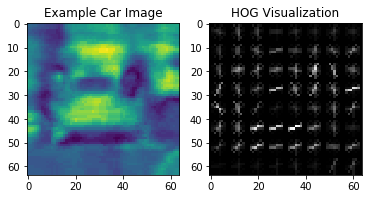

In [6]:
gray = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

# Call our function with vis=True to see an image output
features, hog_image = get_hog_features(gray[:,:,2], orient= 9, 
                        pix_per_cell= 8, cell_per_block= 2, 
                        vis=True, feature_vec=False)

# Plot the examples
fig = plt.figure()
plt.subplot(121)
plt.imshow(gray[:,:,2])
plt.title('Example Car Image')
plt.subplot(122)
plt.imshow(hog_image, cmap='gray')
plt.title('HOG Visualization')

In [7]:
# Define a function to extract features from a single image window
# This function is very similar to extract_features()
# just for a single image rather than list of images
def single_img_features(image, color_space='NON', spatial_size=(32, 32),
                        hist_bins=32, orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel=0,
                        spatial_feat=True, hist_feat=True, hog_feat=True):    
    file_features = []
    # Read in each one by one
#     image = mpimg.imread(file)
    # apply color conversion if other than 'RGB'
    # Convert image to new color space (if specified)
    if color_space != 'NON':
        if color_space == 'HSV':
            feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
        elif color_space == 'LUV':
            feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
        elif color_space == 'HLS':
            feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
        elif color_space == 'YUV':
            feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
        elif color_space == 'YCrCb':
            feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
        # KEEP IN MIND IF YOU DECIDE TO USE THIS FUNCTION LATER
        # IN YOUR PROJECT THAT IF YOU READ THE IMAGE WITH 
        # cv2.imread() INSTEAD YOU START WITH BGR COLOR!
        elif color_space == 'RGB':
            feature_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    else: feature_image = np.copy(image)    

    if spatial_feat == True:
        spatial_features = bin_spatial(feature_image, size=spatial_size)
        file_features.append(spatial_features)
    if hist_feat == True:
        # Apply color_hist()
        rhist, ghist, bhist, bin_centers, hist_features = color_hist(feature_image, nbins=hist_bins)
        file_features.append(hist_features)
    if hog_feat == True:
    # Call get_hog_features() with vis=False, feature_vec=True
        if hog_channel == 'ALL':
            hog_features = []
            for channel in range(feature_image.shape[2]):
                hog_features.append(get_hog_features(feature_image[:,:,channel], 
                                    orient, pix_per_cell, cell_per_block, 
                                    vis=False, feature_vec=True))
            hog_features = np.ravel(hog_features)        
        else:
            hog_features = get_hog_features(feature_image[:,:,hog_channel], orient, 
                        pix_per_cell, cell_per_block, vis=False, feature_vec=True)
        # Append the new feature vector to the features list
        file_features.append(hog_features)
#         print(file_features)
    return np.concatenate(file_features)

In [8]:
# Define a function to extract features from a list of images
# Have this function call bin_spatial() and color_hist()
def extract_features(imgs, color_space='NON', spatial_size=(32, 32),
                        hist_bins=32, orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel=0,
                        spatial_feat=True, hist_feat=True, hog_feat=True):
    # Create a list to append feature vectors to
    features = []
    # Iterate through the list of images
    for file in imgs:
        
        image = mpimg.imread(file)
        
        feature = single_img_features(image, color_space=color_space, spatial_size=spatial_size,
                        hist_bins=hist_bins, orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                        spatial_feat=spatial_feat, hist_feat=hist_feat, hog_feat=hog_feat)
        
        features.append(feature)
        
    # Return list of feature vectors
    return features

In [9]:
color_space = 'HLS' # Can be RGB, HSV, LUV, HLS, YUV, YCrCb
orient = 9  # HOG orientations
pix_per_cell = 8 # HOG pixels per cell
cell_per_block = 2 # HOG cells per block
hog_channel = 'ALL' # Can be 0, 1, 2, or "ALL"
spatial_size = (32, 32) # Spatial binning dimensions
hist_bins = 32    # Number of histogram bins
spatial_feat = True # Spatial features on or off
hist_feat = True # Histogram features on or off
hog_feat = True # HOG features on or off
y_start_stop = [None, None] # Min and max in y to search in slide_window()

car_features = extract_features(cars, color_space=color_space, 
                        spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)
notcar_features = extract_features(notcars[:len(cars)], color_space=color_space, 
                        spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)
print(len(car_features))
print(len(notcar_features))

2826
2826


In [10]:
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler
from sklearn.naive_bayes import GaussianNB
import time
# NOTE: the next import is only valid for scikit-learn version <= 0.17
# for scikit-learn >= 0.18 use:
# from sklearn.model_selection import train_test_split
from sklearn.cross_validation import train_test_split

# Create an array stack of feature vectors
X = np.vstack((car_features, notcar_features)).astype(np.float64)

# Define the labels vector
y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))

if X.shape[0] != y.shape[0]:
    assert("feature and labels don't match")

# Split up data into randomized training and test sets
rand_state = np.random.randint(0, 100)
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2)
    
# Fit a per-column scaler
X_scaler = StandardScaler().fit(X_train)
# Apply the scaler to X
X_train = X_scaler.transform(X_train)
X_test = X_scaler.transform(X_test)

print('Using:',orient,'orientations',pix_per_cell,
    'pixels per cell and', cell_per_block,'cells per block')
print('Feature vector length:', len(X_train[0]))
# Use a linear SVC 
clf_svm = LinearSVC()
clf_gnb = GaussianNB()
# Check the training time for the SVC
t=time.time()
clf_svm.fit(X_train, y_train)
t2 = time.time()
print(round(t2-t, 2), 'Seconds to train SVC...')
# Check the score of the SVC
print('Train Accuracy of SVC = ', round(clf_svm.score(X_train, y_train), 4))
print('Test Accuracy of SVC = ', round(clf_svm.score(X_test, y_test), 4))
t=time.time()
clf_gnb.fit(X_train, y_train)
t2 = time.time()
print(round(t2-t, 2), 'Seconds to train GNB...')
# Check the score of the naieve bayes
print('Train Accuracy of GNB = ', round(clf_gnb.score(X_train, y_train), 4))
print('Test Accuracy of GNB = ', round(clf_gnb.score(X_test, y_test), 4))

C:\Users\hayesmat\AppData\Local\Continuum\anaconda3\lib\site-packages\sklearn\cross_validation.py:41: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


Using: 9 orientations 8 pixels per cell and 2 cells per block
Feature vector length: 8460
2.2 Seconds to train SVC...
Train Accuracy of SVC =  1.0
Test Accuracy of SVC =  0.977
0.78 Seconds to train GNB...
Train Accuracy of GNB =  0.9202
Test Accuracy of GNB =  0.9213


In [11]:
# Define a function that takes an image,
# start and stop positions in both x and y, 
# window size (x and y dimensions),  
# and overlap fraction (for both x and y)
def slide_window(img, x_start_stop=[None, None], y_start_stop=[None, None], 
                    xy_window=(64, 64), xy_overlap=(0.5, 0.5)):
    # If x and/or y start/stop positions not defined, set to image size
    if x_start_stop[0] == None:
        x_start_stop[0] = 0
    if x_start_stop[1] == None:
        x_start_stop[1] = img.shape[1]
    if y_start_stop[0] == None:
        y_start_stop[0] = 0
    if y_start_stop[1] == None:
        y_start_stop[1] = img.shape[0]
    # Compute the span of the region to be searched    
    xspan = x_start_stop[1] - x_start_stop[0]
    yspan = y_start_stop[1] - y_start_stop[0]
    # Compute the number of pixels per step in x/y
    nx_pix_per_step = np.int(xy_window[0]*(1 - xy_overlap[0]))
    ny_pix_per_step = np.int(xy_window[1]*(1 - xy_overlap[1]))
    # Compute the number of windows in x/y
    nx_buffer = np.int(xy_window[0]*(xy_overlap[0]))
    ny_buffer = np.int(xy_window[1]*(xy_overlap[1]))
    nx_windows = np.int((xspan-nx_buffer)/nx_pix_per_step) 
    ny_windows = np.int((yspan-ny_buffer)/ny_pix_per_step) 
    # Initialize a list to append window positions to
    window_list = []
    # Loop through finding x and y window positions
    # Note: you could vectorize this step, but in practice
    # you'll be considering windows one by one with your
    # classifier, so looping makes sense
    for ys in range(ny_windows):
        for xs in range(nx_windows):
            # Calculate window position
            startx = xs*nx_pix_per_step + x_start_stop[0]
            endx = startx + xy_window[0]
            starty = ys*ny_pix_per_step + y_start_stop[0]
            endy = starty + xy_window[1]
            
            # Append window position to list
            window_list.append(((startx, starty), (endx, endy)))
    # Return the list of windows
    return window_list

In [12]:
# Define a function to draw bounding boxes
def draw_boxes(img, bboxes, color=(0, 0, 255), thick=6):
    # Make a copy of the image
    imcopy = np.copy(img)
    # Iterate through the bounding boxes
    for bbox in bboxes:
        # Draw a rectangle given bbox coordinates
        cv2.rectangle(imcopy, bbox[0], bbox[1], color, thick)
    # Return the image copy with boxes drawn
    return imcopy

In [98]:
# image = mpimg.imread('./test_images/test3.jpg')
image = mpimg.imread('../CarND-Advanced-Lane-Lines-master/output_images/input_frame0500.jpg')
# search_dict[0] = [x_start_stop=[440, 840], y_start_stop=[400, (720//4)*3], xy_window=(64, 64), xy_overlap=(0.5, 0.5)] 
# x_start_stop=[None, None], y_start_stop=[400, 600], xy_window=(128, 128), xy_overlap=(0.5, 0.5)
# x_start_stop=[None, None], y_start_stop=[300, None], xy_window=(256, 256), xy_overlap=(0.5, 0.5)


In [103]:
windows_med = slide_window(image, x_start_stop=[480, 1280], y_start_stop=[400, 720], xy_window=(200, 200), xy_overlap=(0.8, 0.8))
windows_far = slide_window(image, x_start_stop=[650, 1050], y_start_stop=[410, 630], xy_window=(100, 100), xy_overlap=(0.8, 0.8))
windows_right = slide_window(image, x_start_stop=[950, None], y_start_stop=[410, None], xy_window=(150, 150), xy_overlap=(0.8, 0.8))
windows_nar = slide_window(image, x_start_stop=[600, 1100], y_start_stop=[370, 550], xy_window=(70, 70), xy_overlap=(0.8, 0.8))

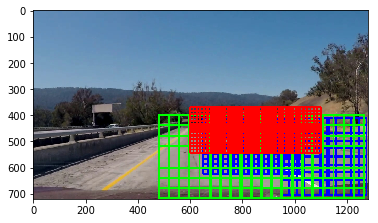

In [107]:
window_img = image
window_img = draw_boxes(window_img, windows_far, color=(0, 0, 255), thick=6)
window_img = draw_boxes(window_img, windows_right, color=(0, 0, 255), thick=6)
window_img = draw_boxes(window_img, windows_med, color=(0, 255, 0), thick=6)
window_img = draw_boxes(window_img, windows_nar, color=(255, 0, 0), thick=6)
plt.imshow(window_img)

524


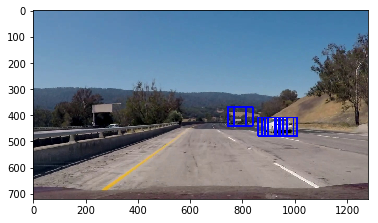

In [108]:
# Define a single function that can extract features using hog sub-sampling and make predictions
def find_cars(img, bboxes):#, scale, svc, X_scaler, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins):
    
    box_fm1 = []
    box_fm2 = []
    # Iterate through the bounding boxes
    for bbox in bboxes:
        
#         print(bbox)
#         print('ytop: '+ str(bbox[0][1]) +' ytop+window: ' + str(bbox[1][1]) + ' xleft: '+ str(bbox[0][0]) +' xleft+window: ' + str(bbox[1][0]))
        
        # Extract the image patch
        subimg = cv2.resize(img[bbox[0][1]:bbox[1][1], bbox[0][0]:bbox[1][0]], (64,64))
        
        #extract features
        features = single_img_features(subimg, color_space='HLS', spatial_size=(32, 32), hist_bins=32, 
                                       hog_channel='ALL', spatial_feat=True, hist_feat=True, hog_feat=True)
        
        # Apply the scaler to the features
        norm_features = X_scaler.transform([features,])
        
        #classify if car present
        if clf_svm.predict(norm_features):# and clf_gnb.predict(norm_features):
            box_fm1.append(bbox)
            box_fm2.extend(bbox)
            
    return box_fm1, box_fm2
            
        
windows = []
windows.extend(windows_far)
windows.extend(windows_right)
windows.extend(windows_med)
windows.extend(windows_nar)
print(len(windows) )       
box_fm1, box_fm2 = find_cars(image, windows)   
window_img = draw_boxes(image, box_fm1, color=(0, 0, 255), thick=6)
plt.imshow(window_img)

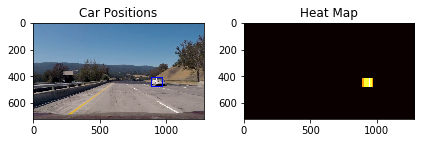

In [109]:
import itertools
from scipy.ndimage.measurements import label
heat = np.zeros_like(image[:,:,0]).astype(np.float)

def add_heat(heatmap, bbox_list):
    # Iterate through list of bboxes
    for box in bbox_list:
#         for box in item:
#         print(box)
        # Add += 1 for all pixels inside each bbox
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1

    # Return updated heatmap
    return heatmap# Iterate through list of bboxes
    
def apply_threshold(heatmap, threshold):
    # Zero out pixels below the threshold
    heatmap[heatmap <= threshold] = 0
    # Return thresholded map
    return heatmap

def draw_labeled_bboxes(img, labels):
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        x_range = np.max(nonzerox)-np.min(nonzerox)
        y_range = np.max(nonzeroy)-np.min(nonzeroy)
        try:
            ratio = float(x_range)/float(y_range)
        except:
            ratio = 4.0
        if ratio < 4.0 and ratio > 1/4.0 and np.min((x_range, y_range)) > 30:
            bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
            # Draw the box on the image
            cv2.rectangle(img, bbox[0], bbox[1], (0,0,255), 6)
    # Return the image
    return img

# Add heat to each box in box list
heat = add_heat(heat,box_fm1)
    
# Apply threshold to help remove false positives
heat = apply_threshold(heat,2)

# Visualize the heatmap when displaying    
heatmap = np.clip(heat, 0, 255)

# Find final boxes from heatmap using label function
labels = label(heatmap)
draw_img = draw_labeled_bboxes(np.copy(image), labels)

# print(labels)

fig = plt.figure()
plt.subplot(121)
plt.imshow(draw_img)
plt.title('Car Positions')
plt.subplot(122)
plt.imshow(heatmap, cmap='hot')
plt.title('Heat Map')
fig.tight_layout()

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0000.jpg


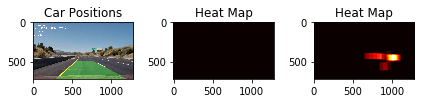

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0001.jpg


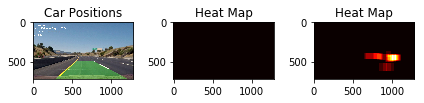

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0002.jpg


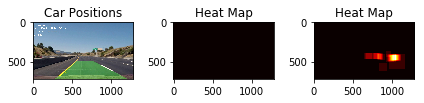

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0003.jpg


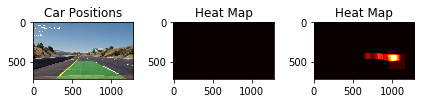

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0004.jpg


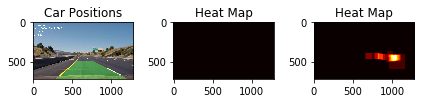

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0005.jpg


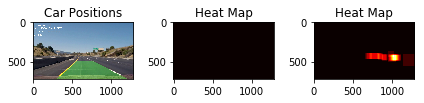

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0006.jpg


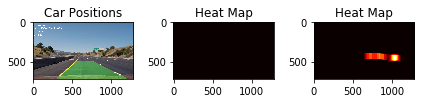

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0007.jpg


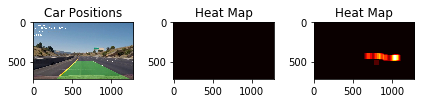

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0008.jpg


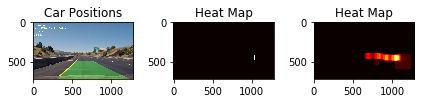

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0009.jpg


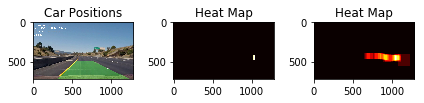

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0010.jpg


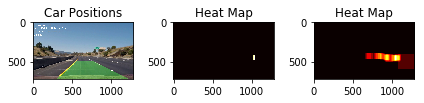

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0011.jpg


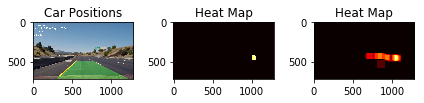

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0012.jpg


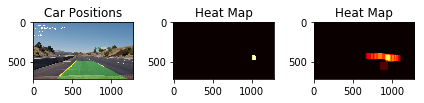

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0013.jpg


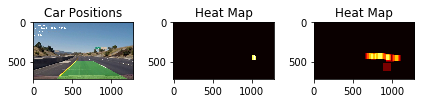

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0014.jpg


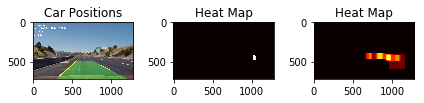

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0015.jpg


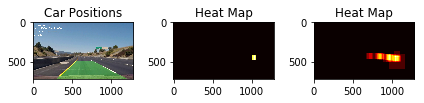

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0016.jpg


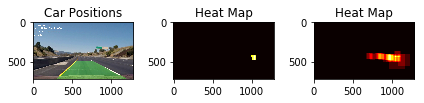

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0017.jpg


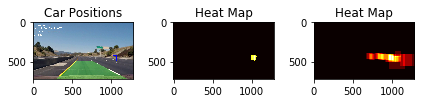

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0018.jpg


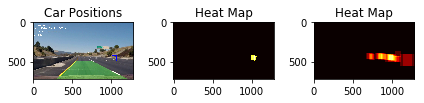

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0019.jpg


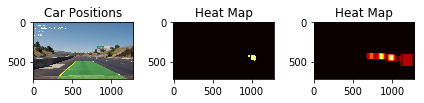

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0020.jpg


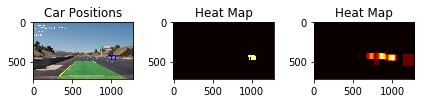

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0021.jpg


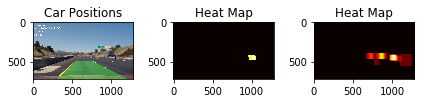

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0022.jpg


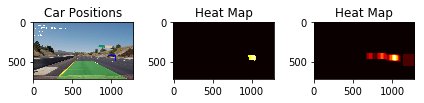

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0023.jpg


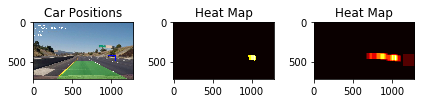

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0024.jpg


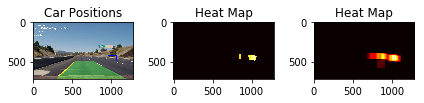

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0025.jpg


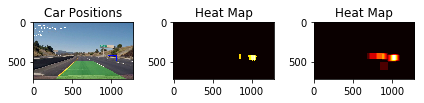

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0026.jpg


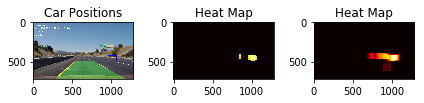

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0027.jpg


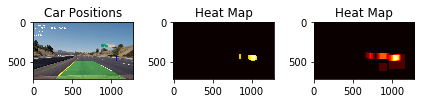

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0028.jpg


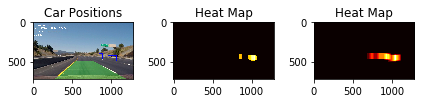

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0029.jpg


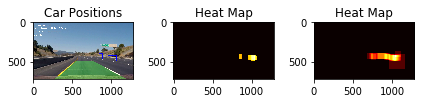

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0030.jpg


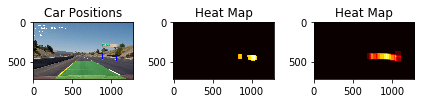

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0031.jpg


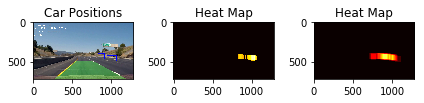

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0032.jpg


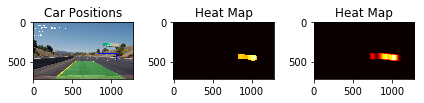

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0033.jpg


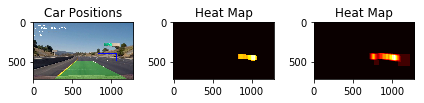

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0034.jpg


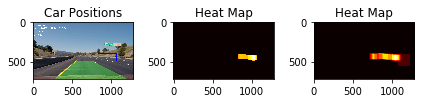

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0035.jpg


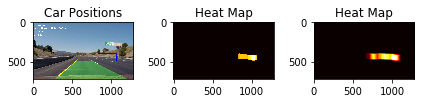

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0036.jpg


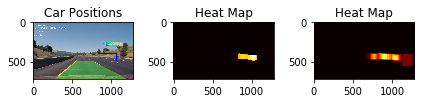

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0037.jpg


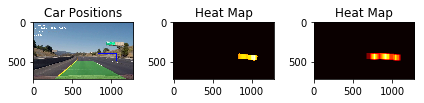

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0038.jpg


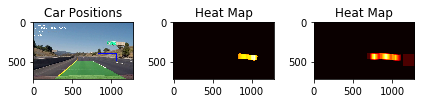

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0039.jpg


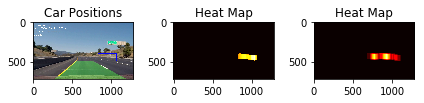

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0040.jpg


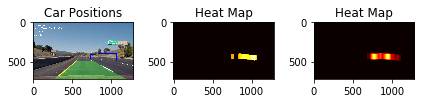

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0041.jpg


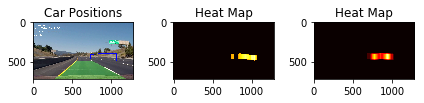

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0042.jpg


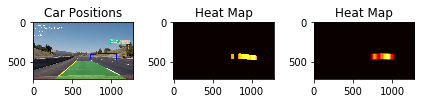

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0043.jpg


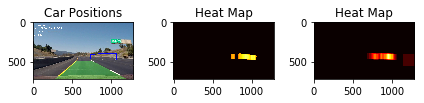

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0044.jpg


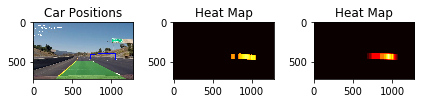

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0045.jpg


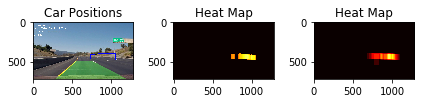

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0046.jpg


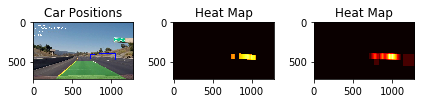

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0047.jpg


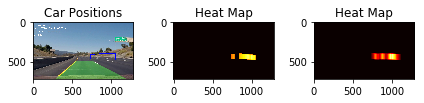

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0048.jpg


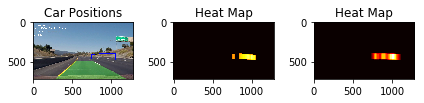

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0049.jpg


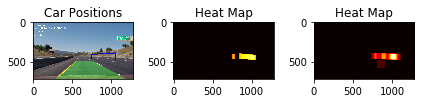

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0050.jpg


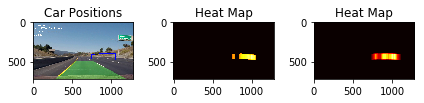

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0051.jpg


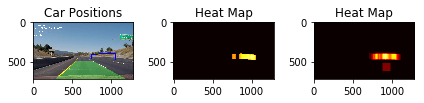

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0052.jpg


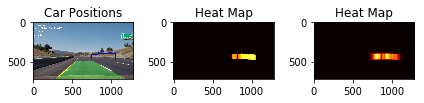

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0053.jpg


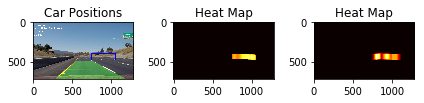

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0054.jpg


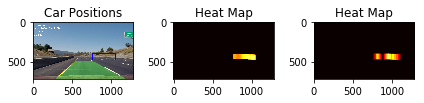

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0055.jpg


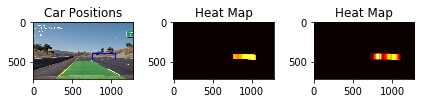

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0056.jpg


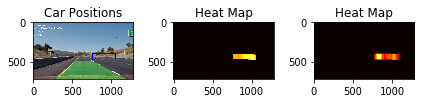

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0057.jpg


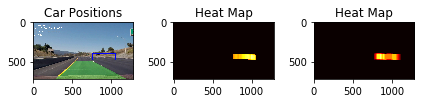

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0058.jpg


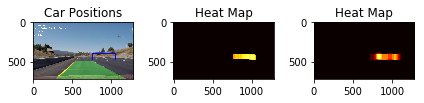

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0059.jpg


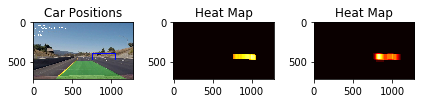

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0060.jpg


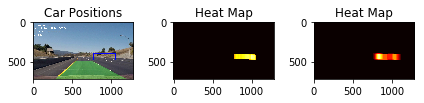

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0061.jpg


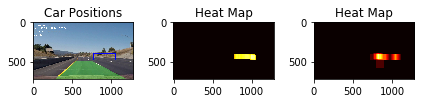

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0062.jpg


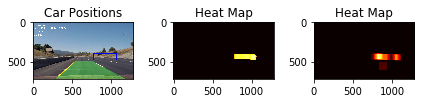

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0063.jpg


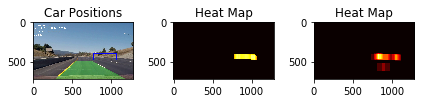

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0064.jpg


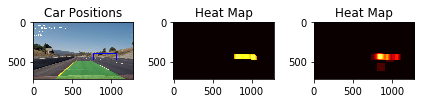

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0065.jpg


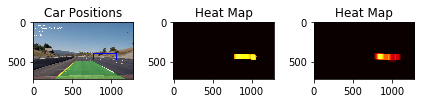

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0066.jpg


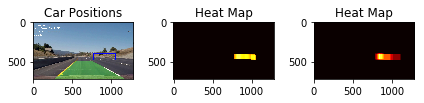

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0067.jpg


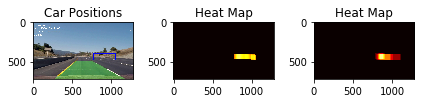

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0068.jpg


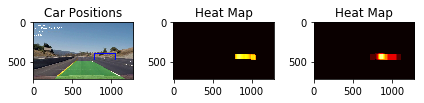

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0069.jpg


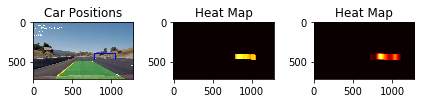

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0070.jpg


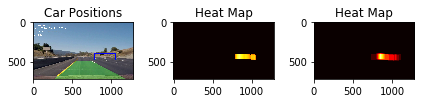

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0071.jpg


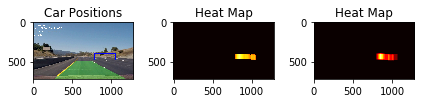

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0072.jpg


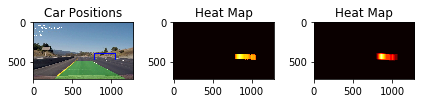

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0073.jpg


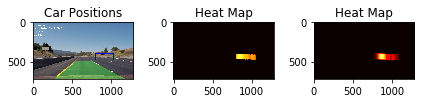

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0074.jpg


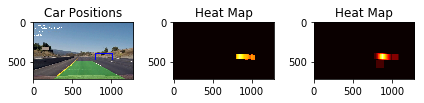

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0075.jpg


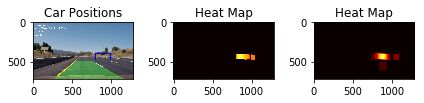

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0076.jpg


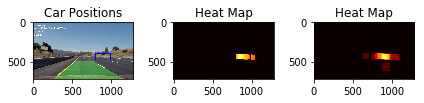

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0077.jpg


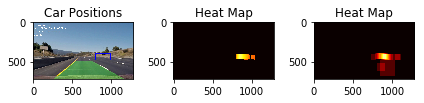

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0078.jpg


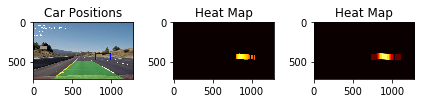

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0079.jpg


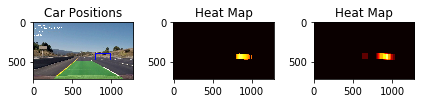

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0080.jpg


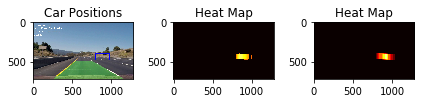

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0081.jpg


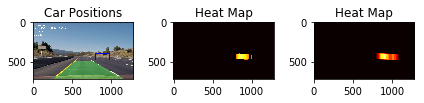

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0082.jpg


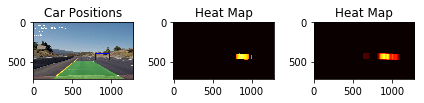

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0083.jpg


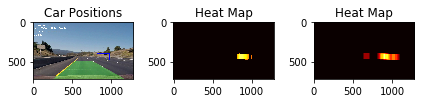

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0084.jpg


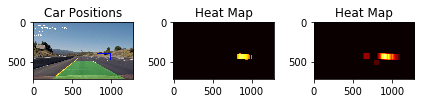

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0085.jpg


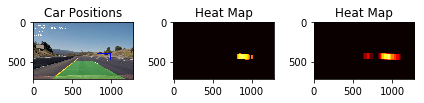

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0086.jpg


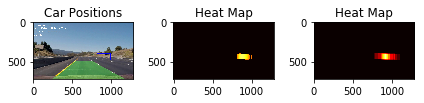

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0087.jpg


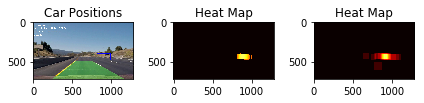

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0088.jpg


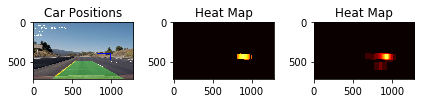

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0089.jpg


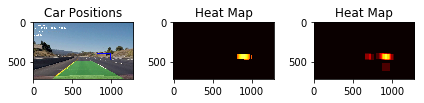

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0090.jpg


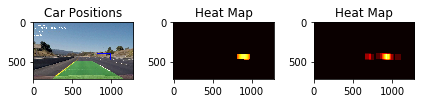

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0091.jpg


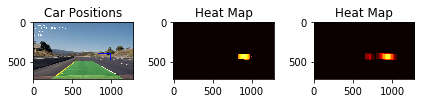

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0092.jpg


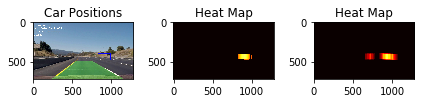

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0093.jpg


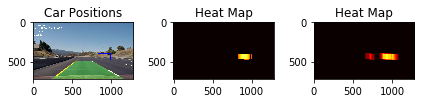

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0094.jpg


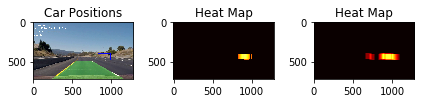

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0095.jpg


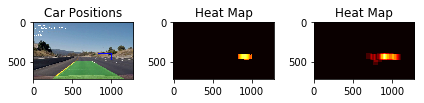

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0096.jpg


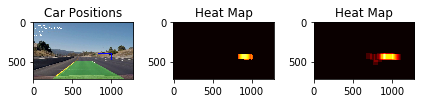

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0097.jpg


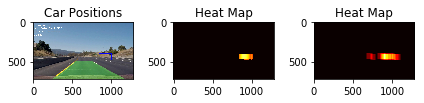

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0098.jpg


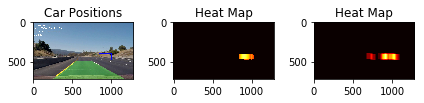

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0099.jpg


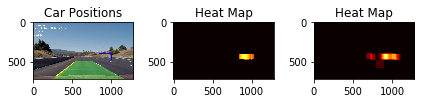

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0100.jpg


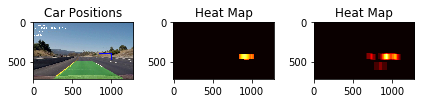

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0101.jpg


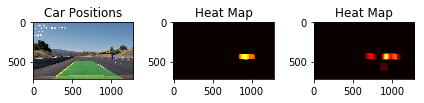

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0102.jpg


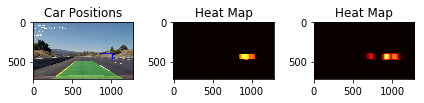

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0103.jpg


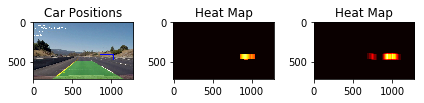

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0104.jpg


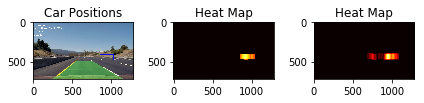

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0105.jpg


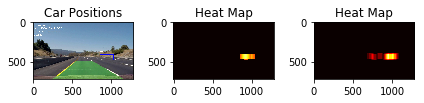

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0106.jpg


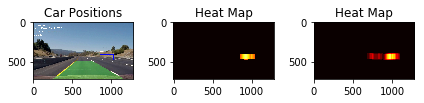

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0107.jpg


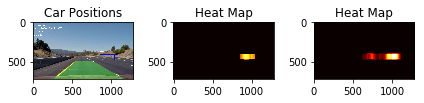

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0108.jpg


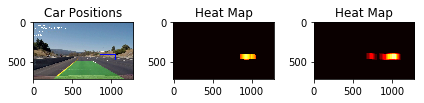

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0109.jpg


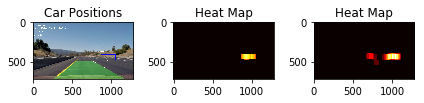

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0110.jpg


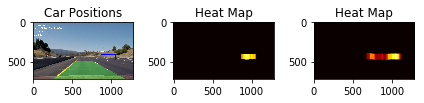

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0111.jpg


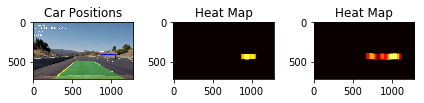

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0112.jpg


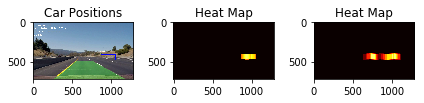

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0113.jpg


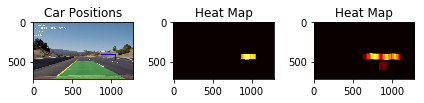

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0114.jpg


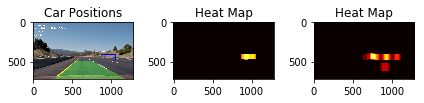

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0115.jpg


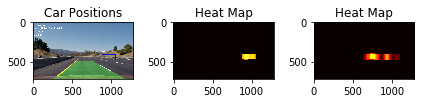

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0116.jpg


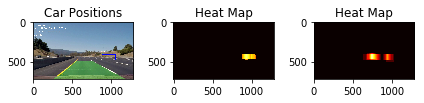

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0117.jpg


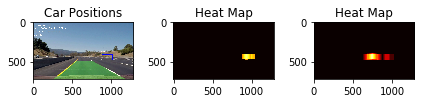

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0118.jpg


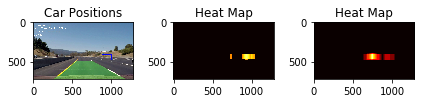

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0119.jpg


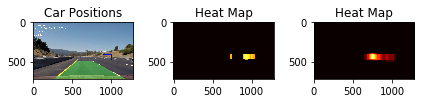

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0120.jpg


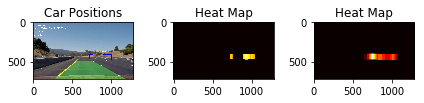

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0121.jpg


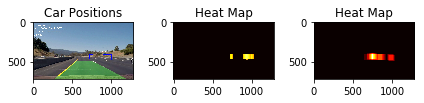

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0122.jpg


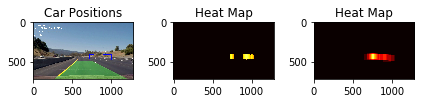

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0123.jpg


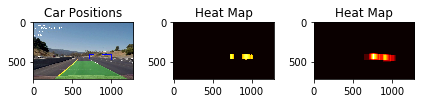

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0124.jpg


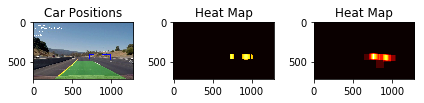

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0125.jpg


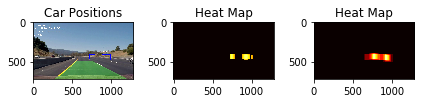

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0126.jpg


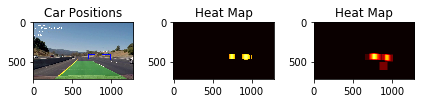

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0127.jpg


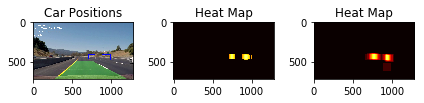

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0128.jpg


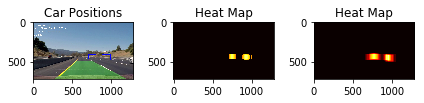

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0129.jpg


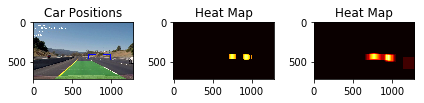

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0130.jpg


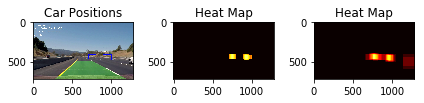

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0131.jpg


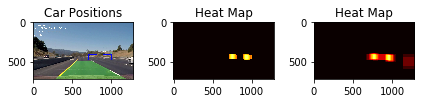

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0132.jpg


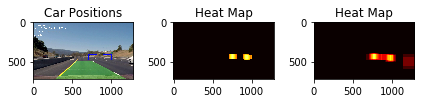

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0133.jpg


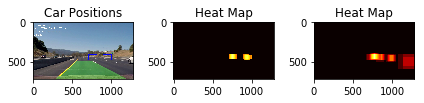

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0134.jpg


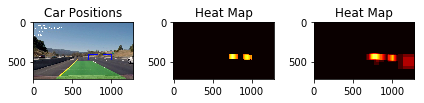

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0135.jpg


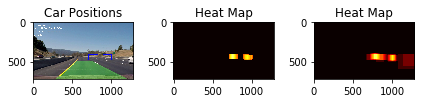

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0136.jpg


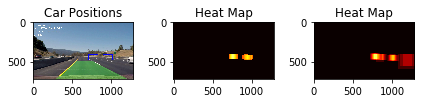

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0137.jpg


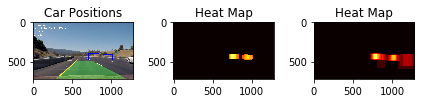

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0138.jpg


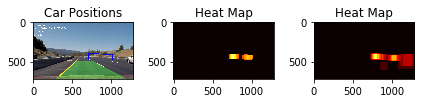

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0139.jpg


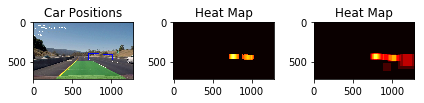

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0140.jpg


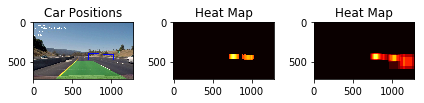

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0141.jpg


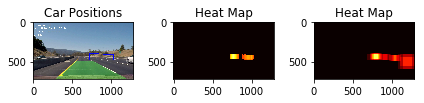

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0142.jpg


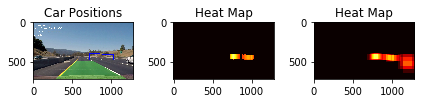

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0143.jpg


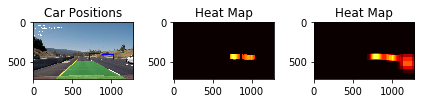

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0144.jpg


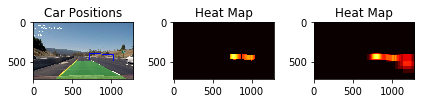

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0145.jpg


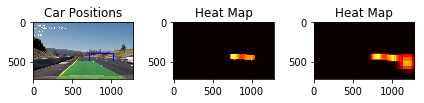

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0146.jpg


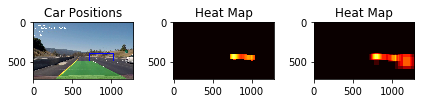

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0147.jpg


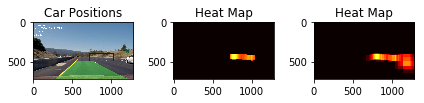

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0148.jpg


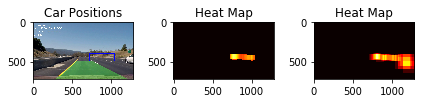

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0149.jpg


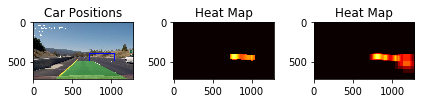

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0150.jpg


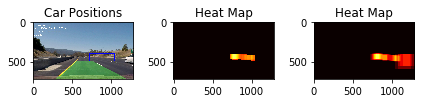

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0151.jpg


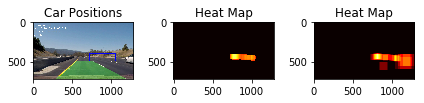

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0152.jpg


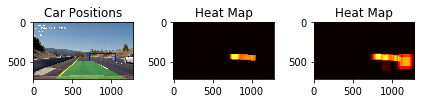

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0153.jpg


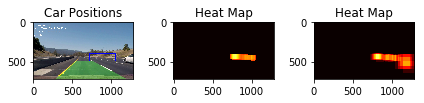

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0154.jpg


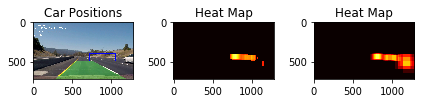

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0155.jpg


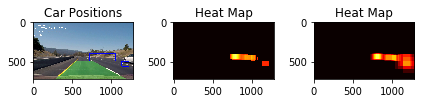

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0156.jpg


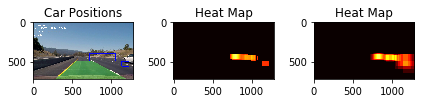

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0157.jpg


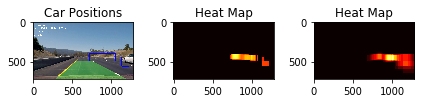

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0158.jpg


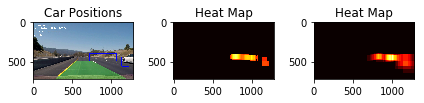

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0159.jpg


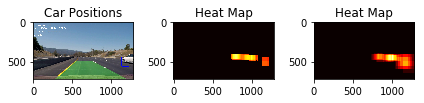

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0160.jpg


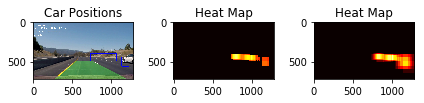

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0161.jpg


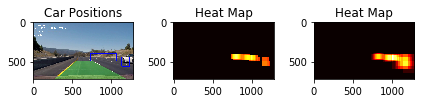

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0162.jpg


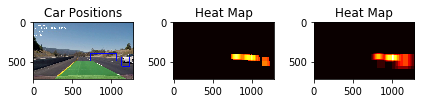

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0163.jpg


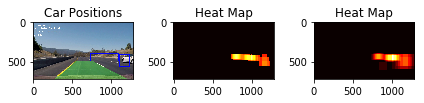

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0164.jpg


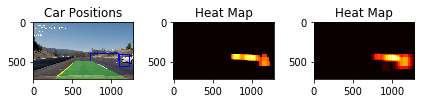

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0165.jpg


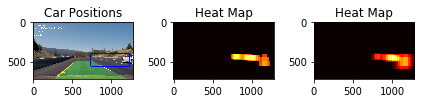

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0166.jpg


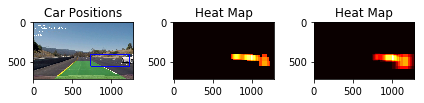

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0167.jpg


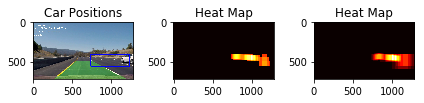

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0168.jpg


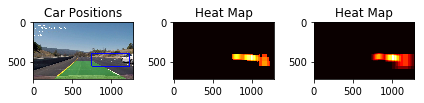

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0169.jpg


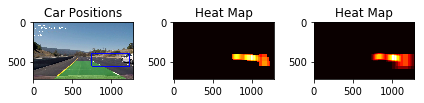

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0170.jpg


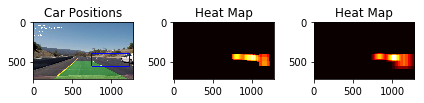

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0171.jpg


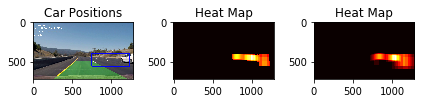

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0172.jpg


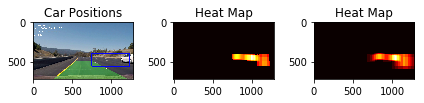

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0173.jpg


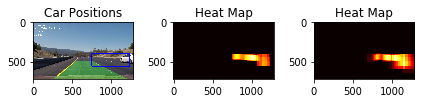

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0174.jpg


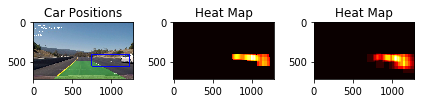

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0175.jpg


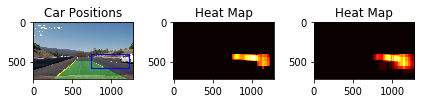

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0176.jpg


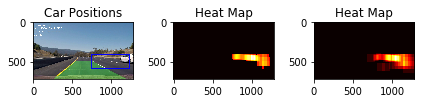

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0177.jpg


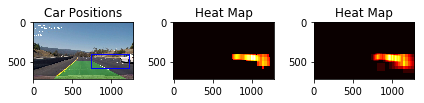

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0178.jpg


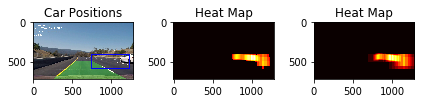

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0179.jpg


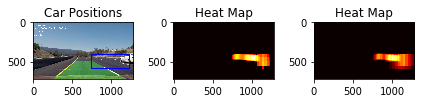

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0180.jpg


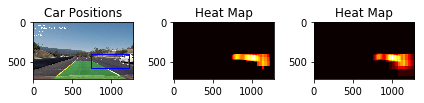

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0181.jpg


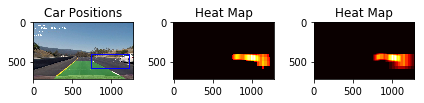

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0182.jpg


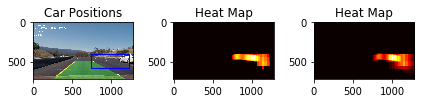

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0183.jpg


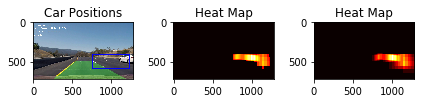

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0184.jpg


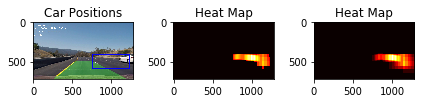

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0185.jpg


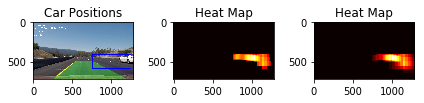

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0186.jpg


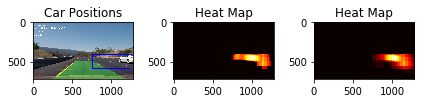

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0187.jpg


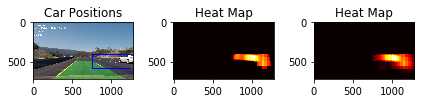

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0188.jpg


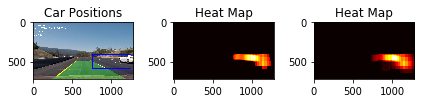

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0189.jpg


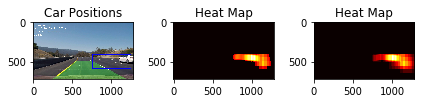

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0190.jpg


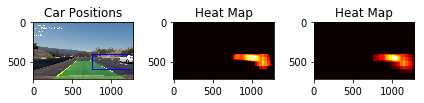

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0191.jpg


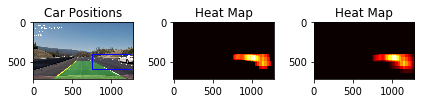

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0192.jpg


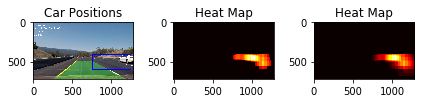

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0193.jpg


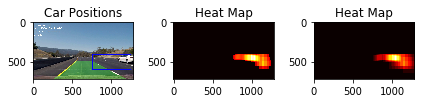

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0194.jpg


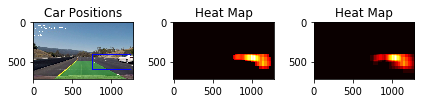

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0195.jpg


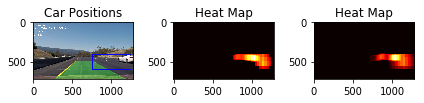

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0196.jpg


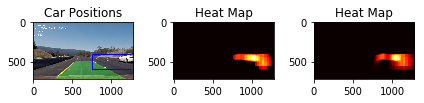

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0197.jpg


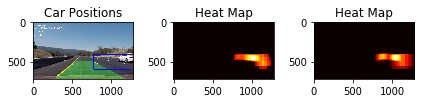

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0198.jpg


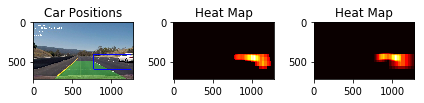

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0199.jpg


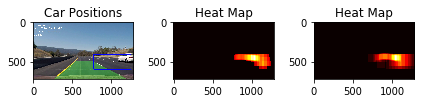

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0200.jpg


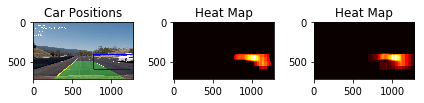

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0201.jpg


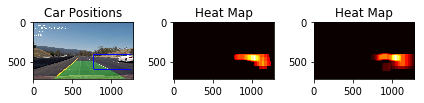

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0202.jpg


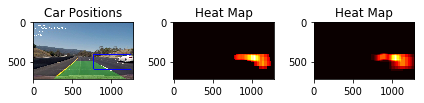

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0203.jpg


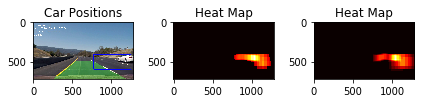

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0204.jpg


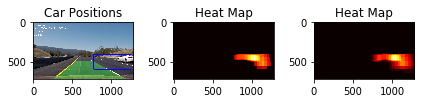

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0205.jpg


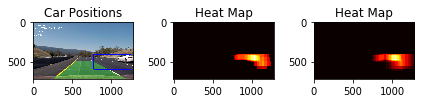

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0206.jpg


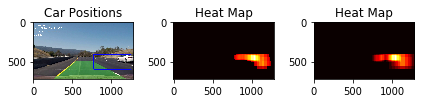

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0207.jpg


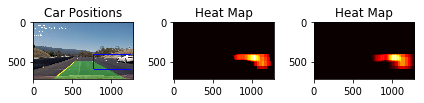

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0208.jpg


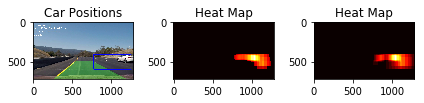

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0209.jpg


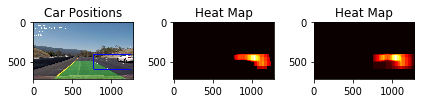

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0210.jpg


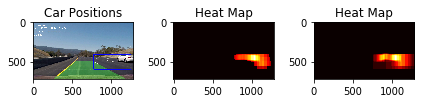

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0211.jpg


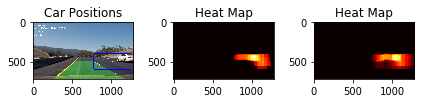

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0212.jpg


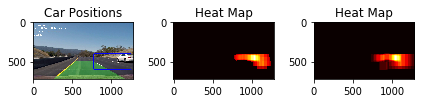

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0213.jpg


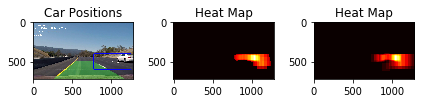

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0214.jpg


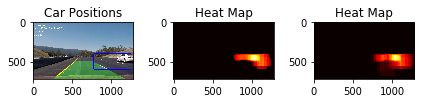

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0215.jpg


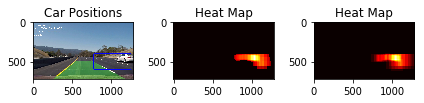

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0216.jpg


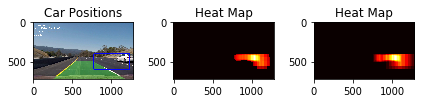

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0217.jpg


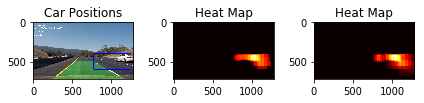

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0218.jpg


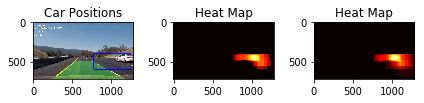

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0219.jpg


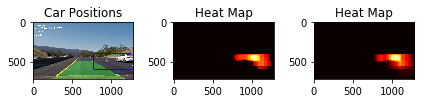

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0220.jpg


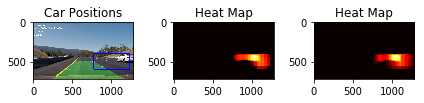

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0221.jpg


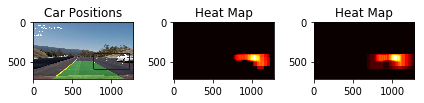

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0222.jpg


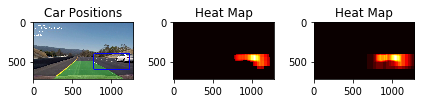

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0223.jpg


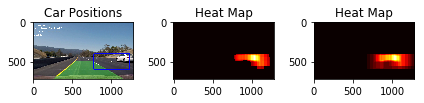

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0224.jpg


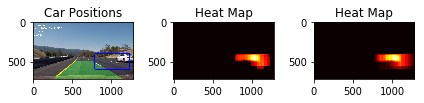

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0225.jpg


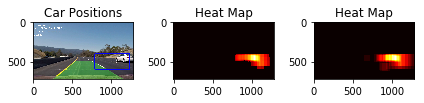

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0226.jpg


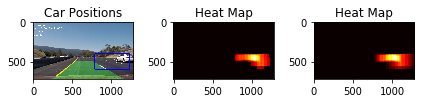

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0227.jpg


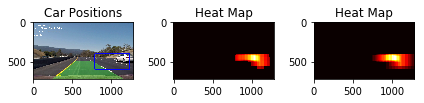

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0228.jpg


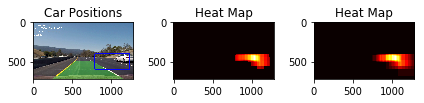

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0229.jpg


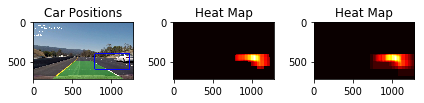

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0230.jpg


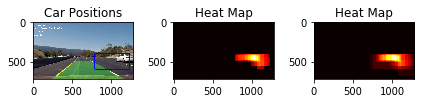

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0231.jpg


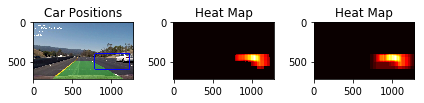

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0232.jpg


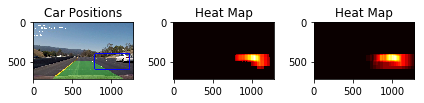

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0233.jpg


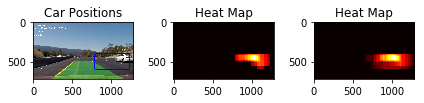

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0234.jpg


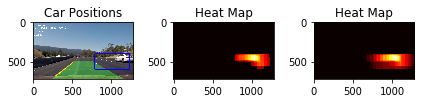

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0235.jpg


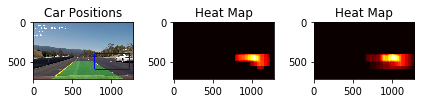

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0236.jpg


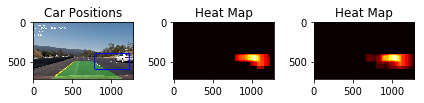

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0237.jpg


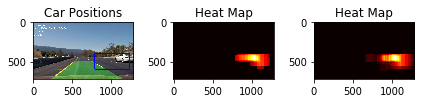

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0238.jpg


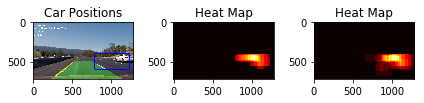

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0239.jpg


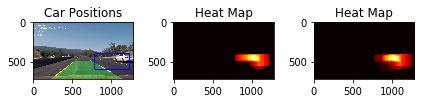

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0240.jpg


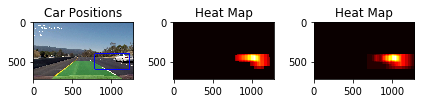

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0241.jpg


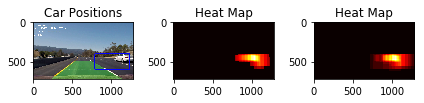

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0242.jpg


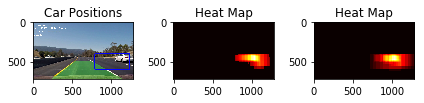

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0243.jpg


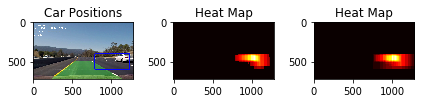

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0244.jpg


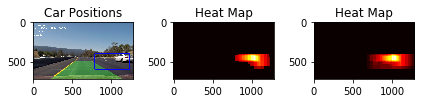

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0245.jpg


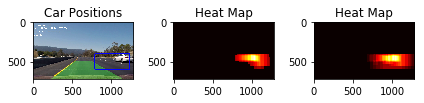

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0246.jpg


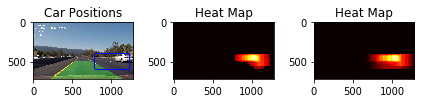

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0247.jpg


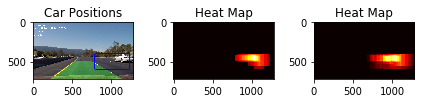

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0248.jpg


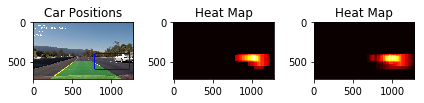

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0249.jpg


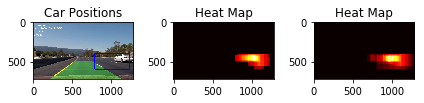

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0250.jpg


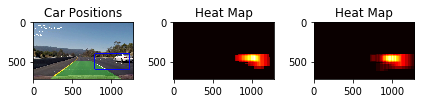

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0251.jpg


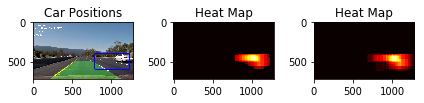

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0252.jpg


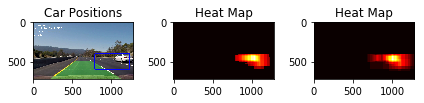

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0253.jpg


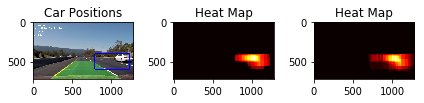

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0254.jpg


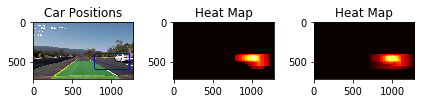

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0255.jpg


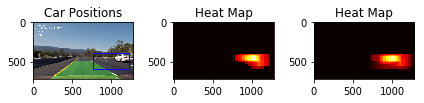

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0256.jpg


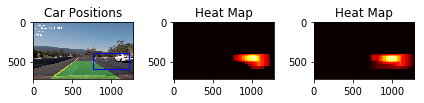

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0257.jpg


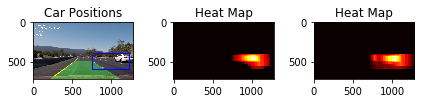

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0258.jpg


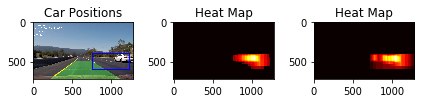

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0259.jpg


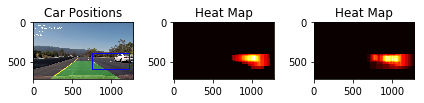

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0260.jpg


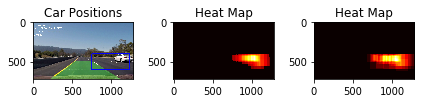

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0261.jpg


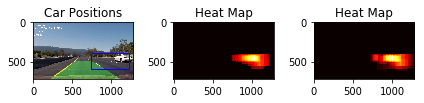

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0262.jpg


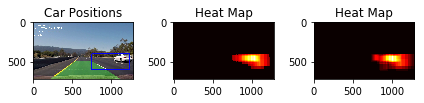

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0263.jpg


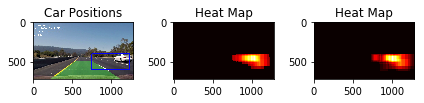

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0264.jpg


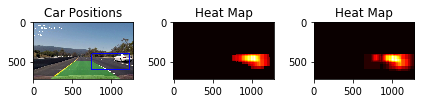

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0265.jpg


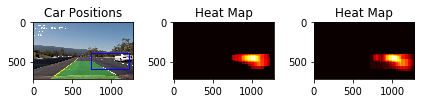

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0266.jpg


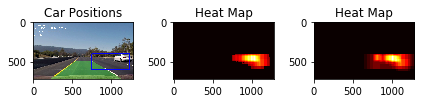

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0267.jpg


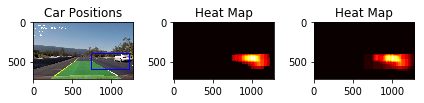

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0268.jpg


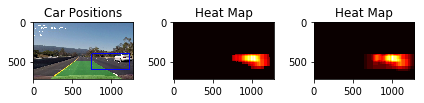

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0269.jpg


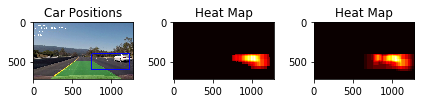

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0270.jpg


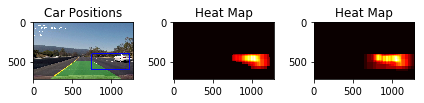

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0271.jpg


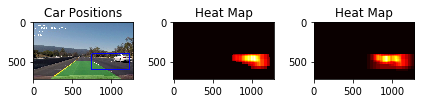

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0272.jpg


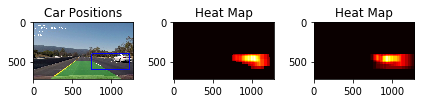

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0273.jpg


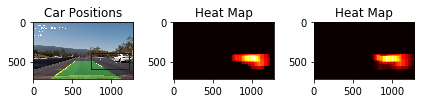

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0274.jpg


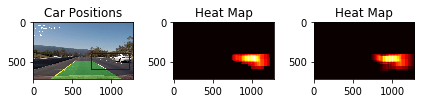

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0275.jpg


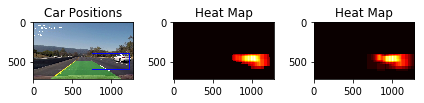

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0276.jpg


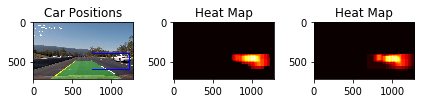

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0277.jpg


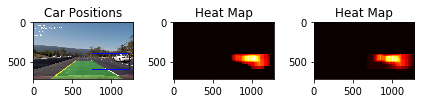

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0278.jpg


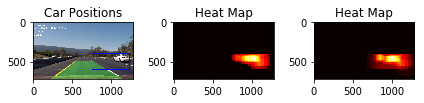

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0279.jpg


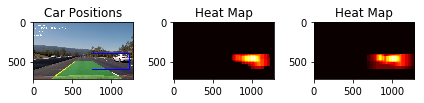

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0280.jpg


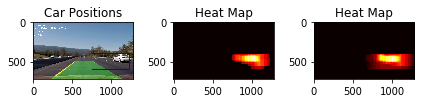

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0281.jpg


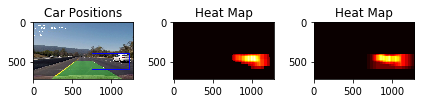

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0282.jpg


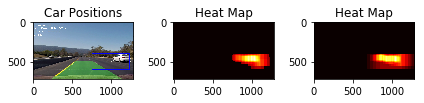

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0283.jpg


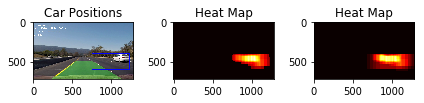

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0284.jpg


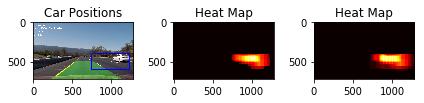

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0285.jpg


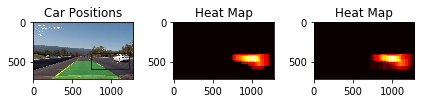

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0286.jpg


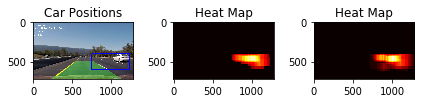

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0287.jpg


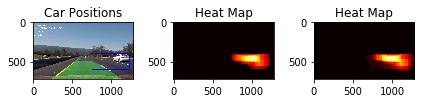

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0288.jpg


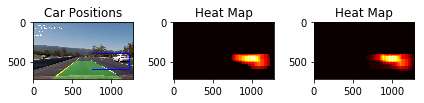

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0289.jpg


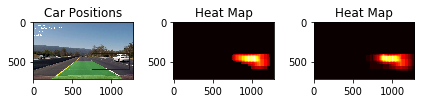

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0290.jpg


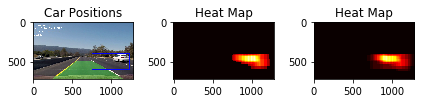

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0291.jpg


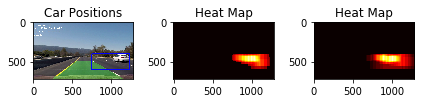

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0292.jpg


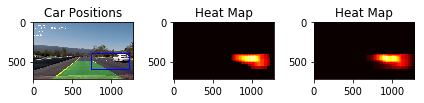

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0293.jpg


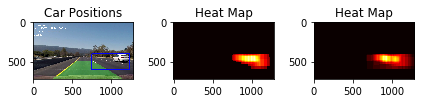

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0294.jpg


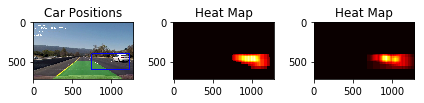

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0295.jpg


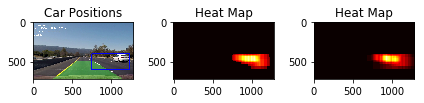

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0296.jpg


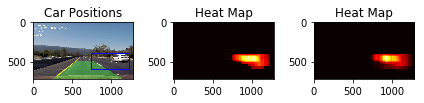

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0297.jpg


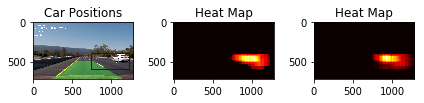

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0298.jpg


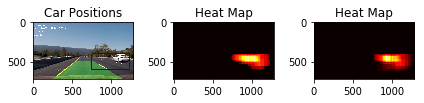

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0299.jpg


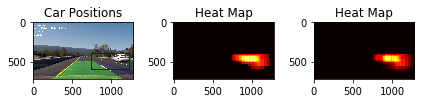

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0300.jpg


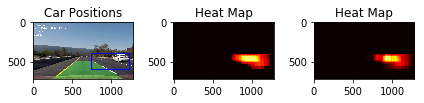

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0301.jpg


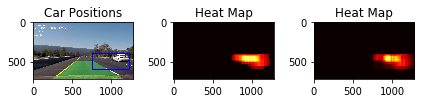

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0302.jpg


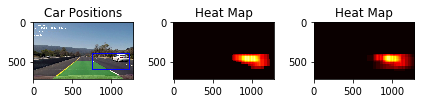

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0303.jpg


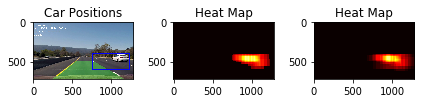

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0304.jpg


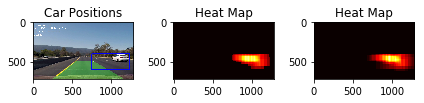

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0305.jpg


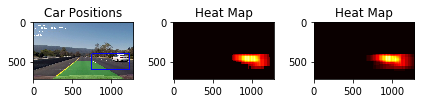

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0306.jpg


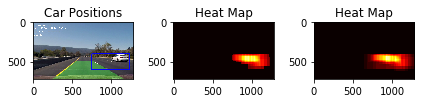

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0307.jpg


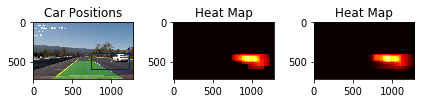

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0308.jpg


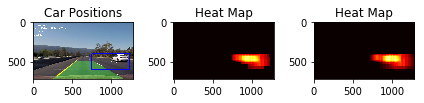

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0309.jpg


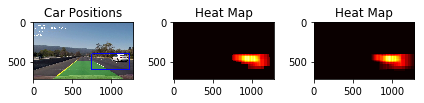

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0310.jpg


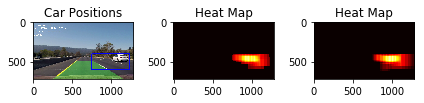

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0311.jpg


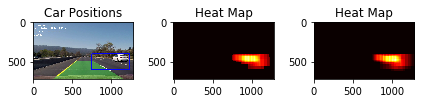

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0312.jpg


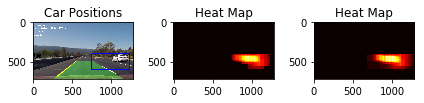

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0313.jpg


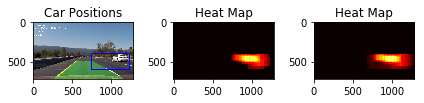

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0314.jpg


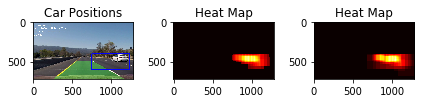

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0315.jpg


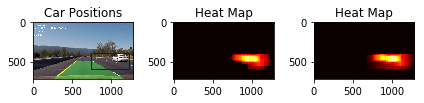

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0316.jpg


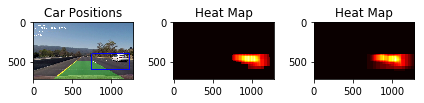

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0317.jpg


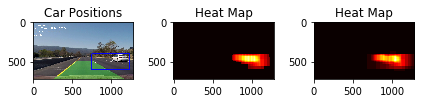

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0318.jpg


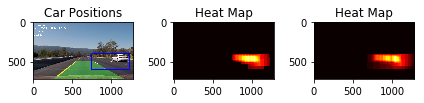

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0319.jpg


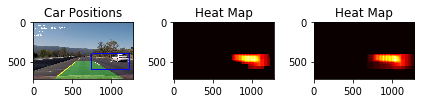

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0320.jpg


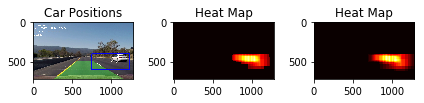

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0321.jpg


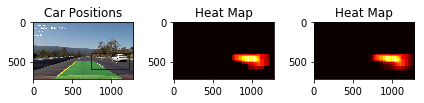

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0322.jpg


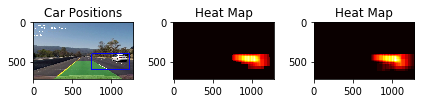

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0323.jpg


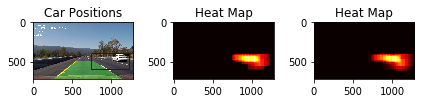

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0324.jpg


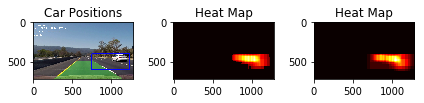

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0325.jpg


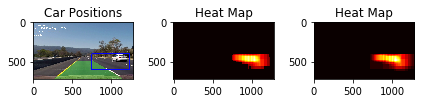

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0326.jpg


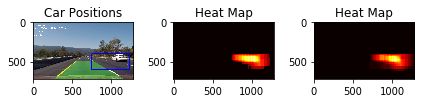

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0327.jpg


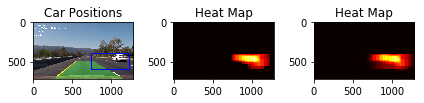

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0328.jpg


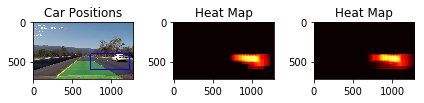

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0329.jpg


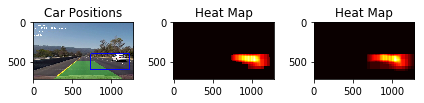

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0330.jpg


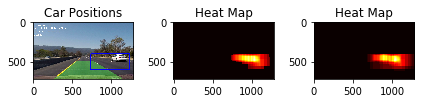

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0331.jpg


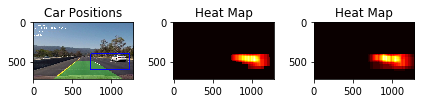

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0332.jpg


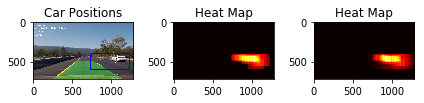

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0333.jpg


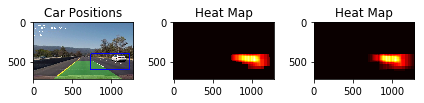

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0334.jpg


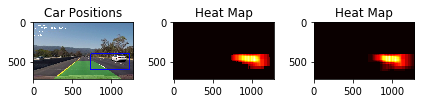

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0335.jpg


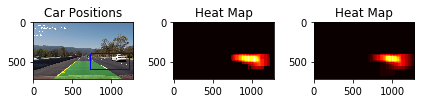

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0336.jpg


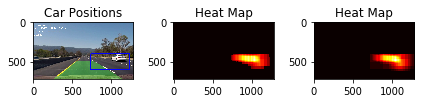

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0337.jpg


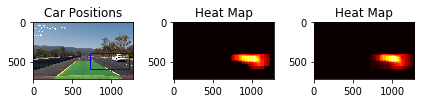

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0338.jpg


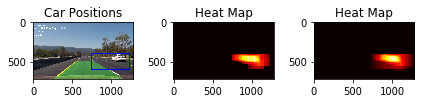

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0339.jpg


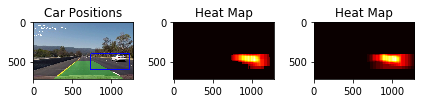

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0340.jpg


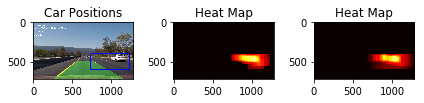

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0341.jpg


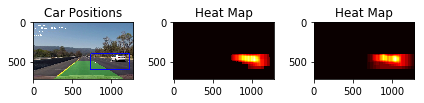

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0342.jpg


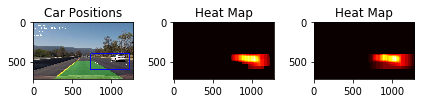

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0343.jpg


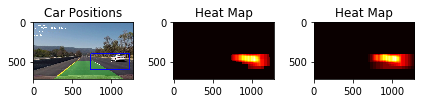

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0344.jpg


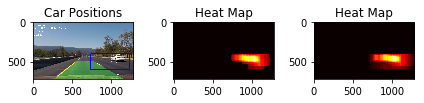

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0345.jpg


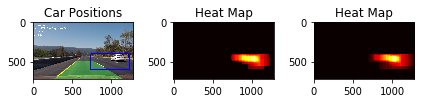

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0346.jpg


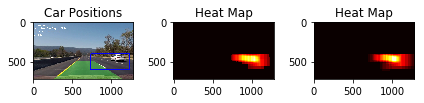

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0347.jpg


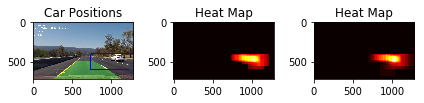

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0348.jpg


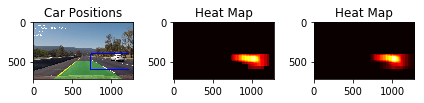

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0349.jpg


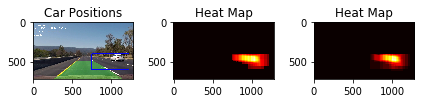

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0350.jpg


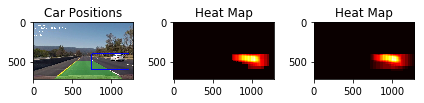

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0351.jpg


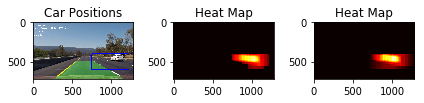

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0352.jpg


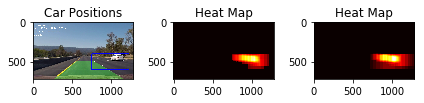

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0353.jpg


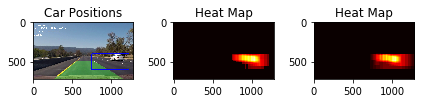

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0354.jpg


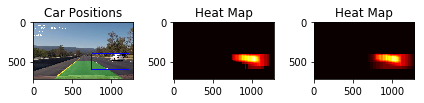

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0355.jpg


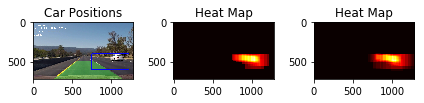

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0356.jpg


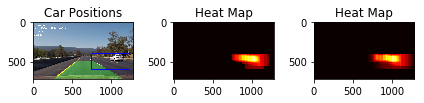

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0357.jpg


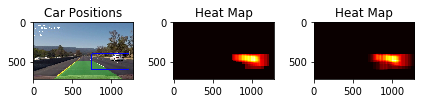

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0358.jpg


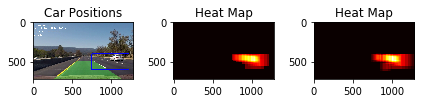

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0359.jpg


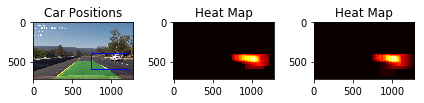

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0360.jpg


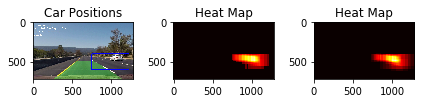

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0361.jpg


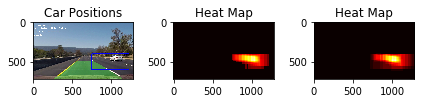

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0362.jpg


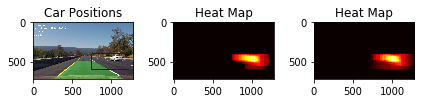

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0363.jpg


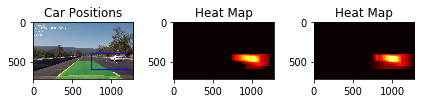

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0364.jpg


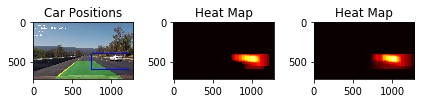

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0365.jpg


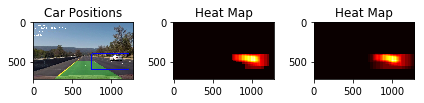

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0366.jpg


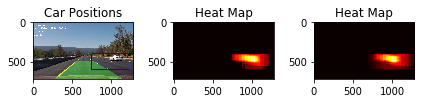

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0367.jpg


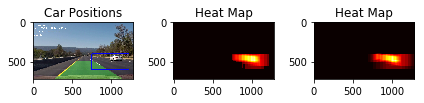

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0368.jpg


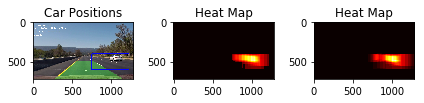

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0369.jpg


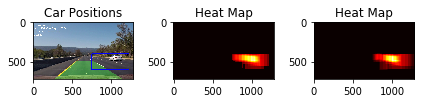

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0370.jpg


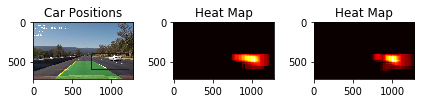

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0371.jpg


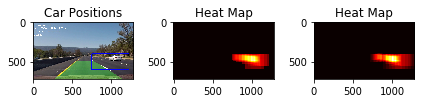

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0372.jpg


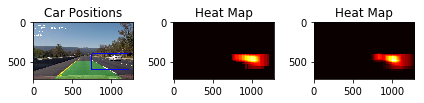

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0373.jpg


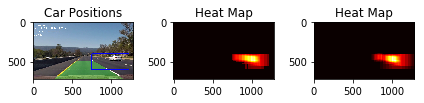

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0374.jpg


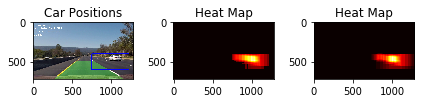

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0375.jpg


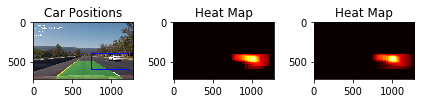

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0376.jpg


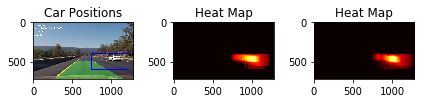

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0377.jpg


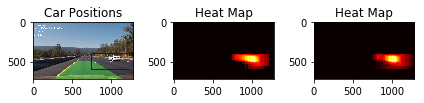

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0378.jpg


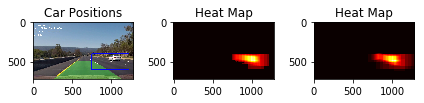

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0379.jpg


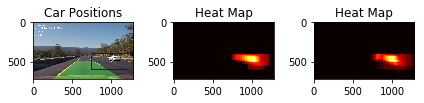

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0380.jpg


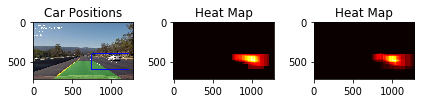

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0381.jpg


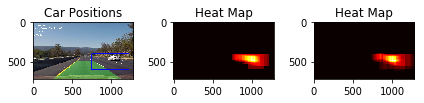

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0382.jpg


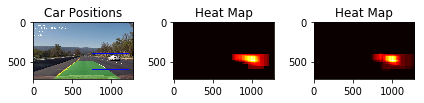

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0383.jpg


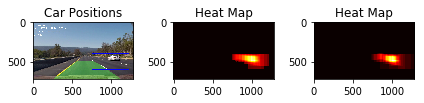

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0384.jpg


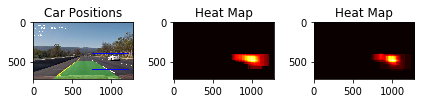

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0385.jpg


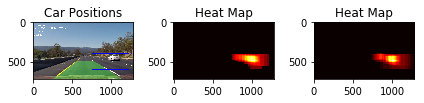

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0386.jpg


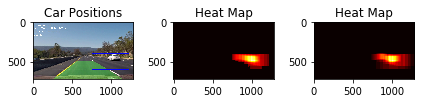

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0387.jpg


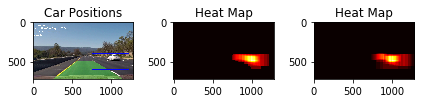

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0388.jpg


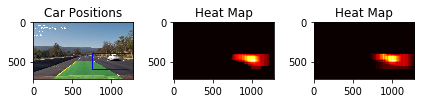

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0389.jpg


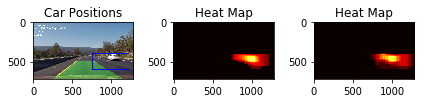

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0390.jpg


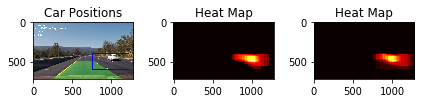

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0391.jpg


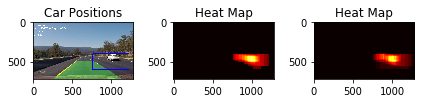

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0392.jpg


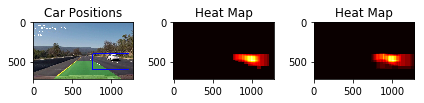

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0393.jpg


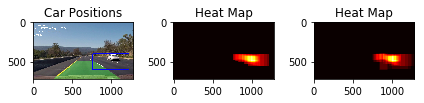

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0394.jpg


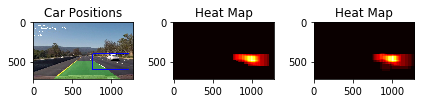

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0395.jpg


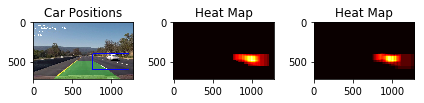

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0396.jpg


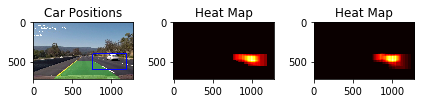

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0397.jpg


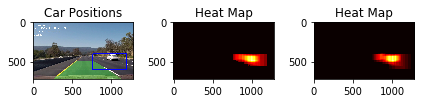

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0398.jpg


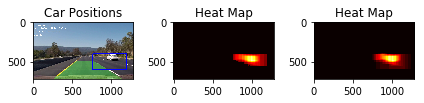

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0399.jpg


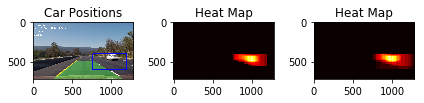

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0400.jpg


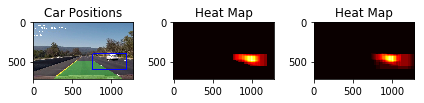

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0401.jpg


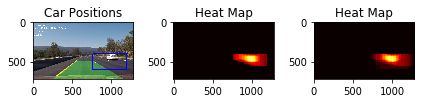

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0402.jpg


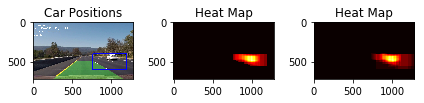

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0403.jpg


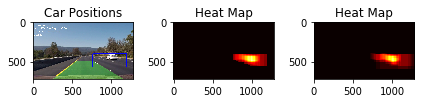

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0404.jpg


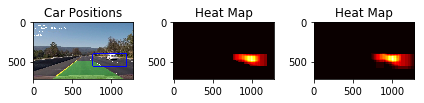

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0405.jpg


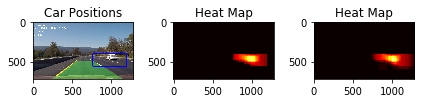

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0406.jpg


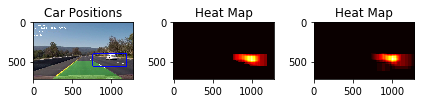

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0407.jpg


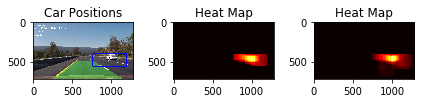

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0408.jpg


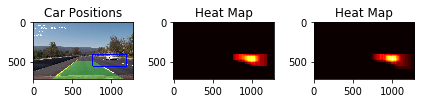

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0409.jpg


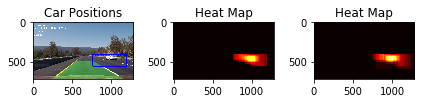

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0410.jpg


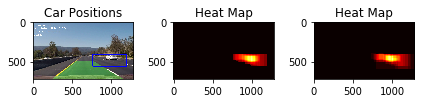

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0411.jpg


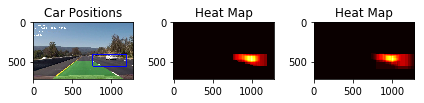

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0412.jpg


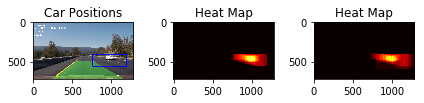

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0413.jpg


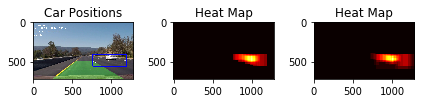

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0414.jpg


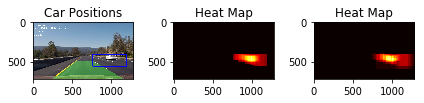

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0415.jpg


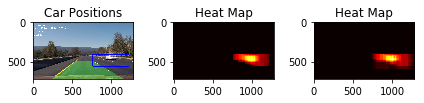

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0416.jpg


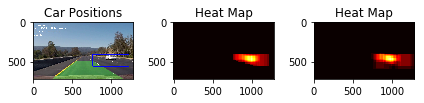

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0417.jpg


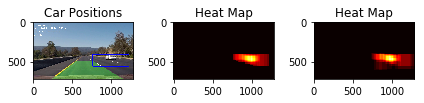

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0418.jpg


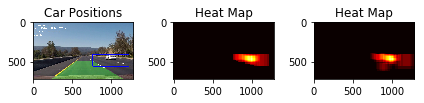

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0419.jpg


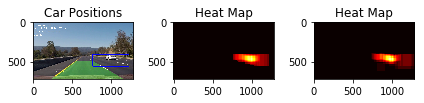

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0420.jpg


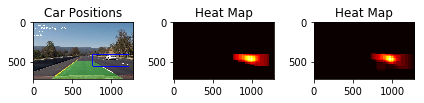

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0421.jpg


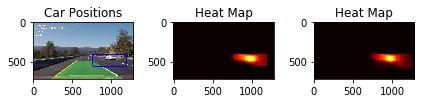

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0422.jpg


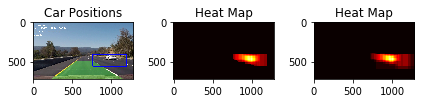

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0423.jpg


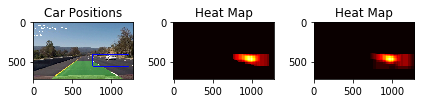

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0424.jpg


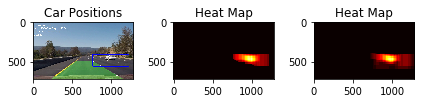

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0425.jpg


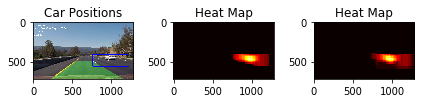

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0426.jpg


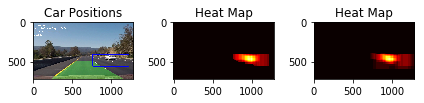

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0427.jpg


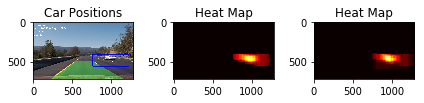

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0428.jpg


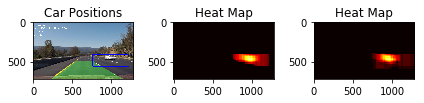

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0429.jpg


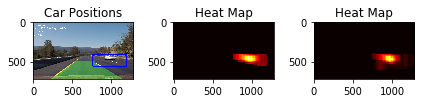

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0430.jpg


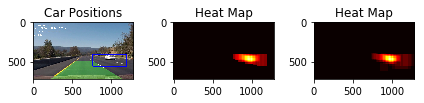

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0431.jpg


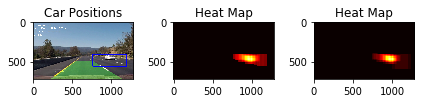

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0432.jpg


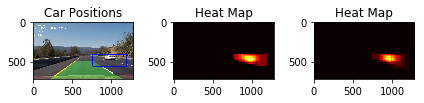

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0433.jpg


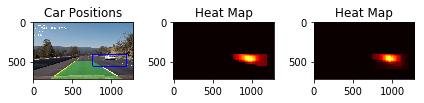

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0434.jpg


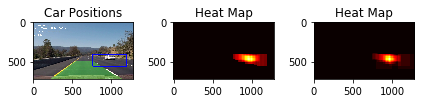

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0435.jpg


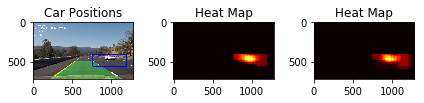

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0436.jpg


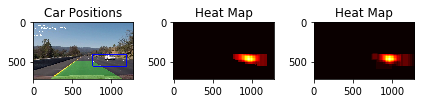

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0437.jpg


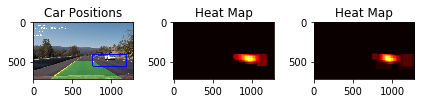

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0438.jpg


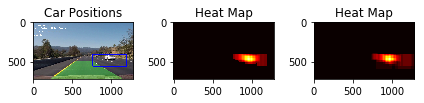

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0439.jpg


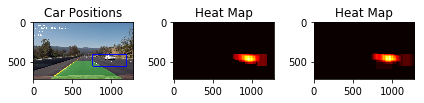

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0440.jpg


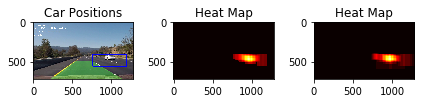

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0441.jpg


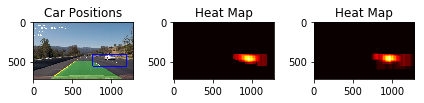

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0442.jpg


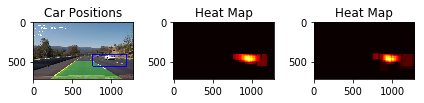

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0443.jpg


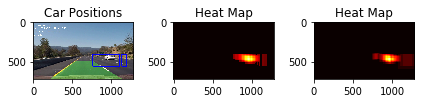

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0444.jpg


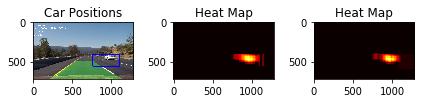

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0445.jpg


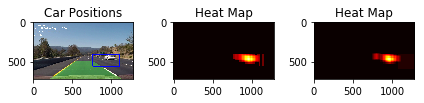

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0446.jpg


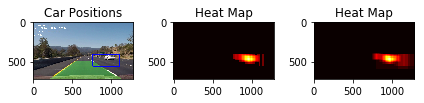

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0447.jpg


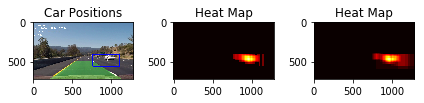

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0448.jpg


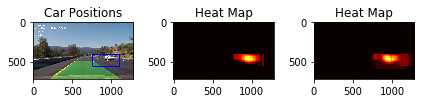

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0449.jpg


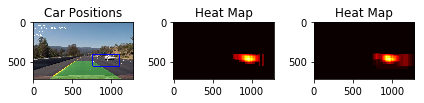

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0450.jpg


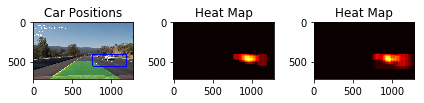

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0451.jpg


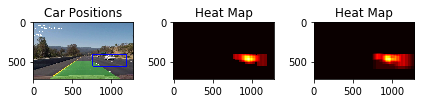

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0452.jpg


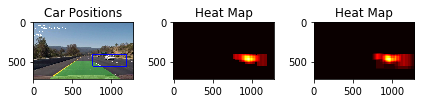

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0453.jpg


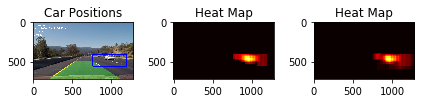

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0454.jpg


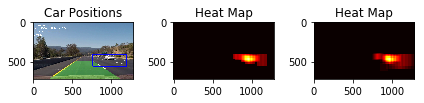

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0455.jpg


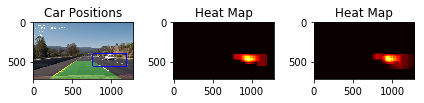

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0456.jpg


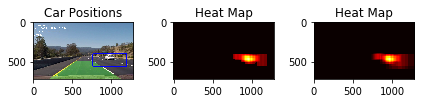

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0457.jpg


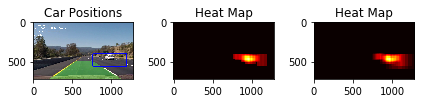

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0458.jpg


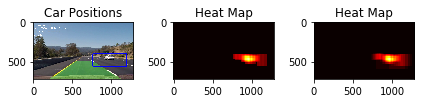

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0459.jpg


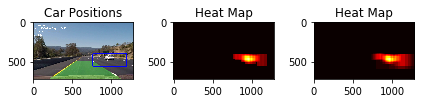

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0460.jpg


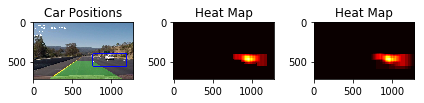

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0461.jpg


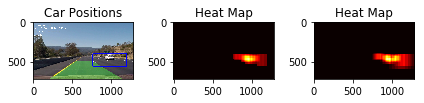

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0462.jpg


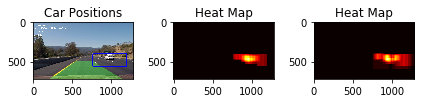

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0463.jpg


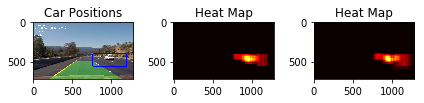

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0464.jpg


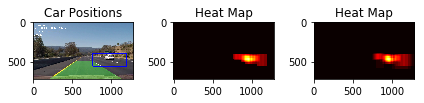

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0465.jpg


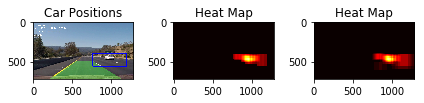

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0466.jpg


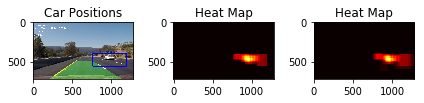

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0467.jpg


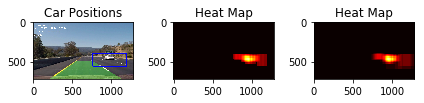

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0468.jpg


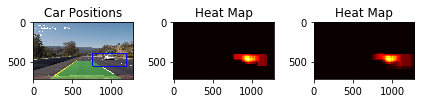

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0469.jpg


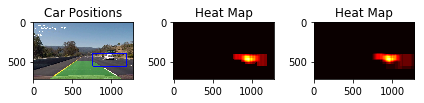

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0470.jpg


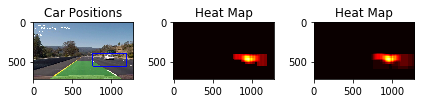

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0471.jpg


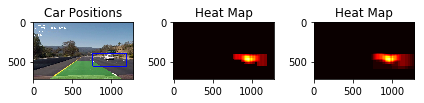

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0472.jpg


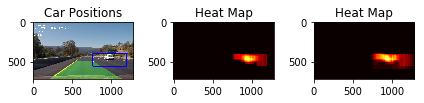

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0473.jpg


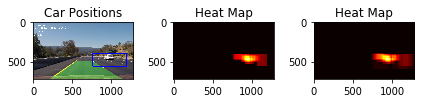

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0474.jpg


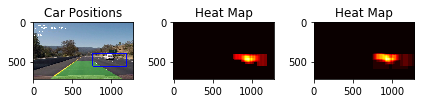

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0475.jpg


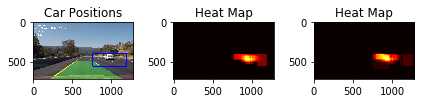

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0476.jpg


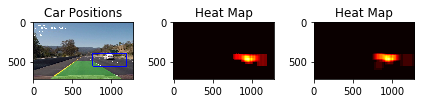

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0477.jpg


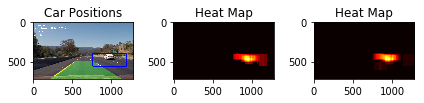

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0478.jpg


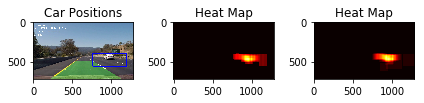

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0479.jpg


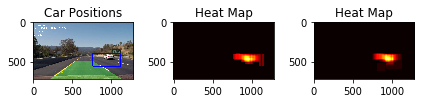

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0480.jpg


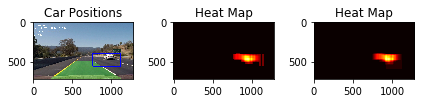

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0481.jpg


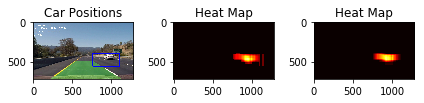

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0482.jpg


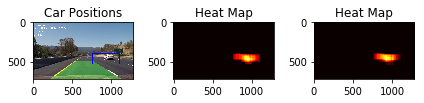

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0483.jpg


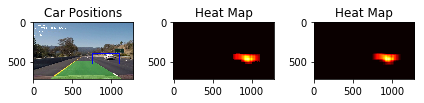

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0484.jpg


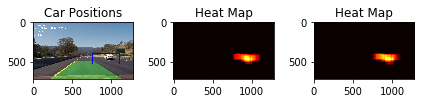

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0485.jpg


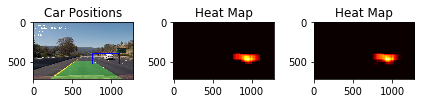

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0486.jpg


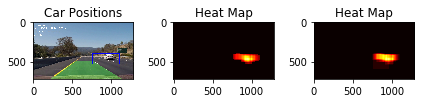

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0487.jpg


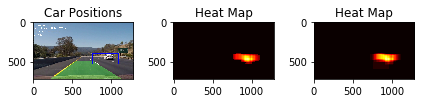

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0488.jpg


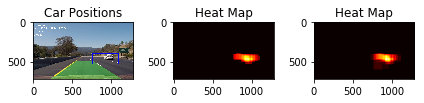

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0489.jpg


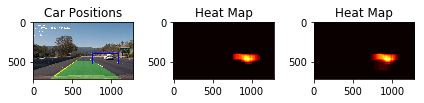

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0490.jpg


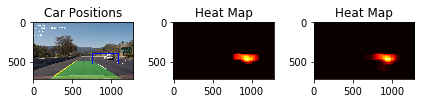

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0491.jpg


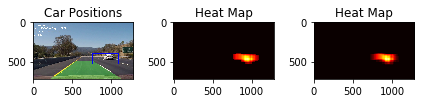

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0492.jpg


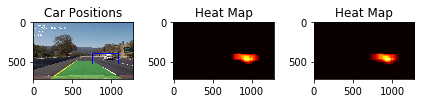

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0493.jpg


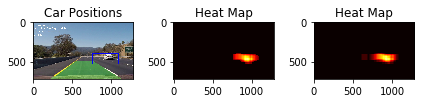

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0494.jpg


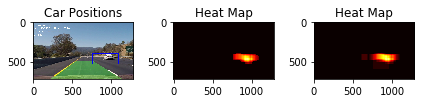

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0495.jpg


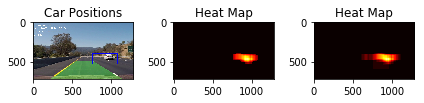

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0496.jpg


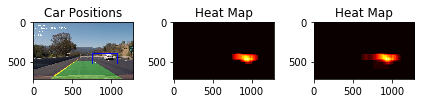

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0497.jpg


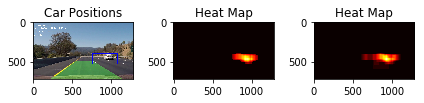

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0498.jpg


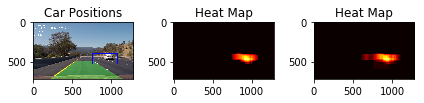

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0499.jpg


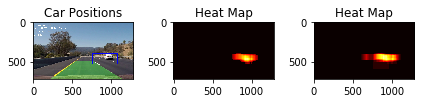

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0500.jpg


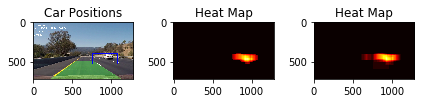

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0501.jpg


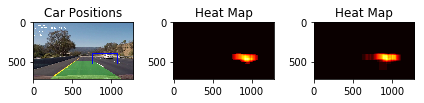

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0502.jpg


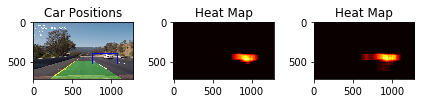

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0503.jpg


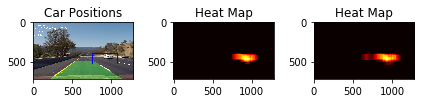

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0504.jpg


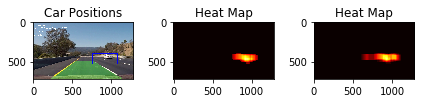

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0505.jpg


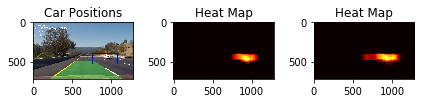

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0506.jpg


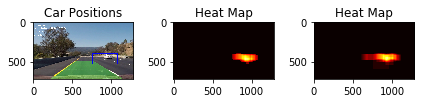

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0507.jpg


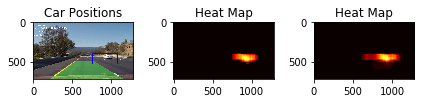

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0508.jpg


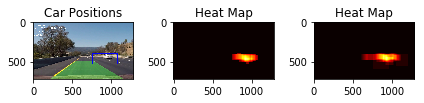

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0509.jpg


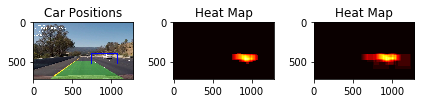

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0510.jpg


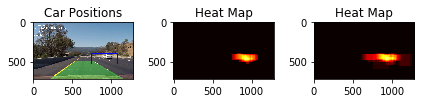

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0511.jpg


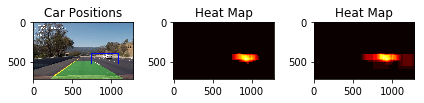

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0512.jpg


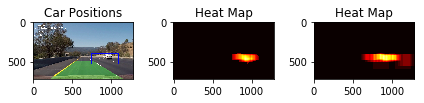

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0513.jpg


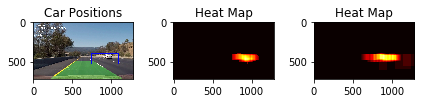

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0514.jpg


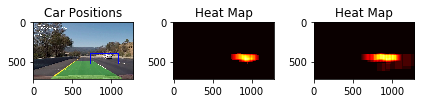

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0515.jpg


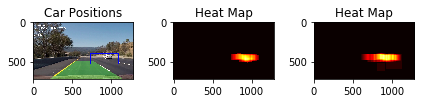

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0516.jpg


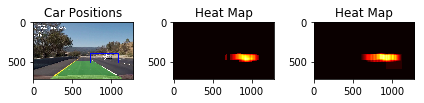

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0517.jpg


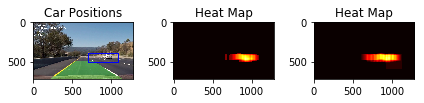

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0518.jpg


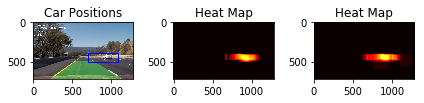

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0519.jpg


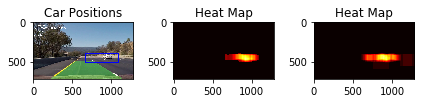

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0520.jpg


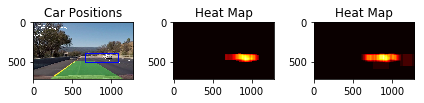

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0521.jpg


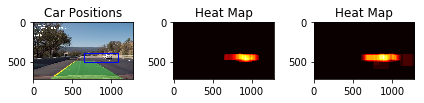

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0522.jpg


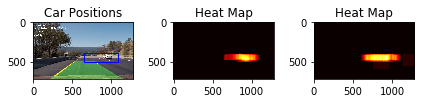

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0523.jpg


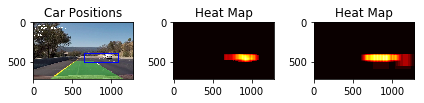

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0524.jpg


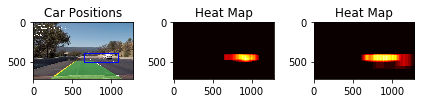

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0525.jpg


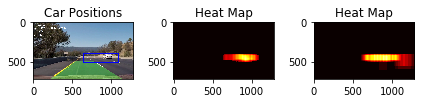

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0526.jpg


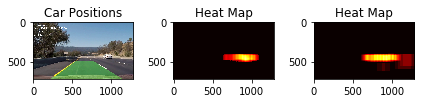

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0527.jpg


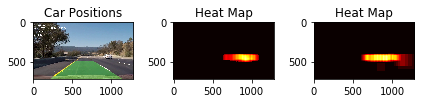

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0528.jpg


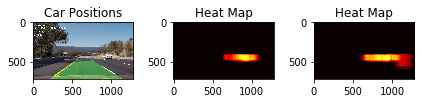

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0529.jpg


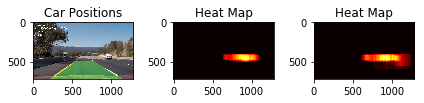

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0530.jpg


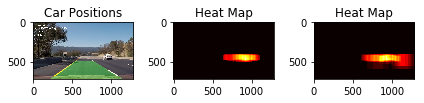

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0531.jpg


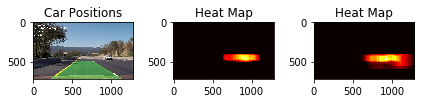

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0532.jpg


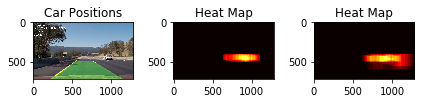

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0533.jpg


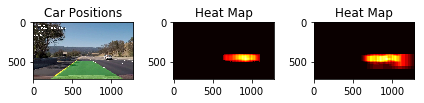

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0534.jpg


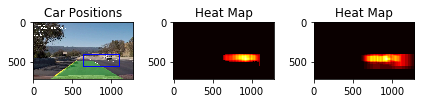

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0535.jpg


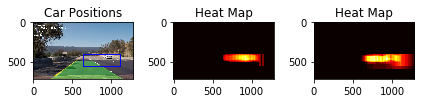

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0536.jpg


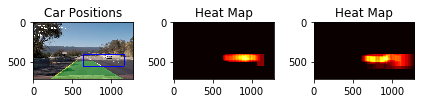

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0537.jpg


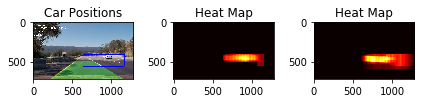

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0538.jpg


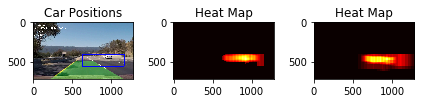

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0539.jpg


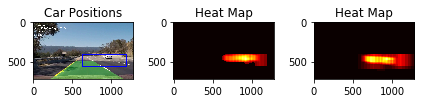

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0540.jpg


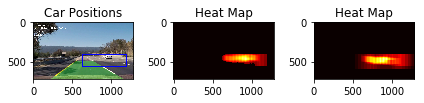

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0541.jpg


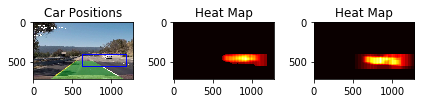

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0542.jpg


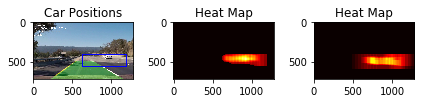

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0543.jpg


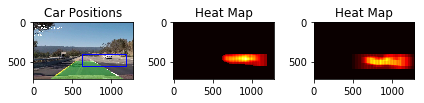

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0544.jpg


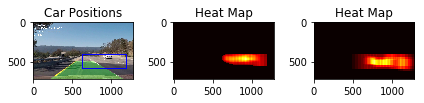

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0545.jpg


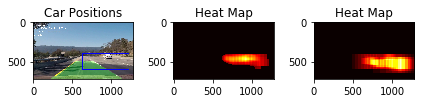

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0546.jpg


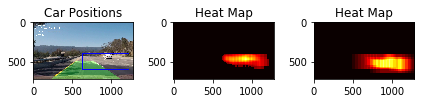

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0547.jpg


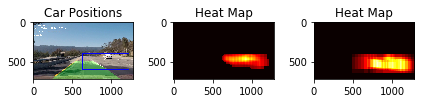

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0548.jpg


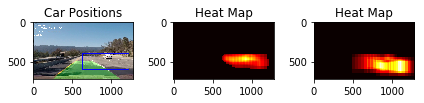

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0549.jpg


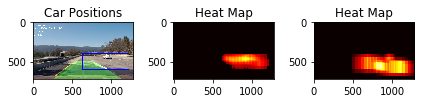

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0550.jpg


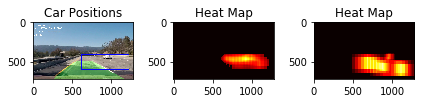

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0551.jpg


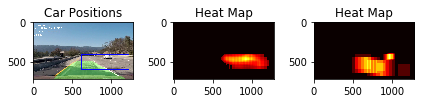

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0552.jpg


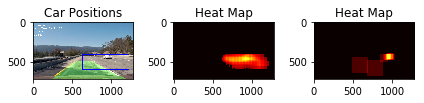

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0553.jpg


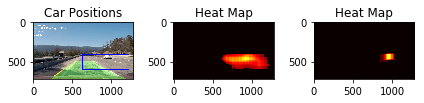

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0554.jpg


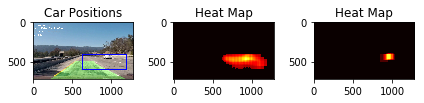

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0555.jpg


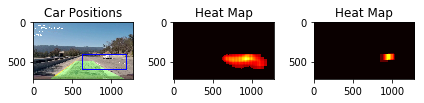

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0556.jpg


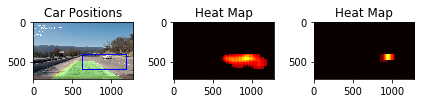

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0557.jpg


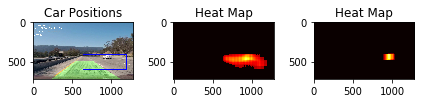

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0558.jpg


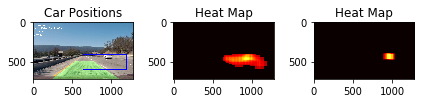

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0559.jpg


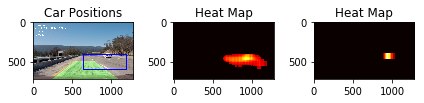

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0560.jpg


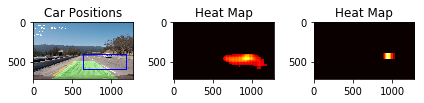

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0561.jpg


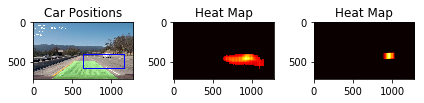

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0562.jpg


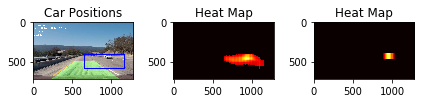

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0563.jpg


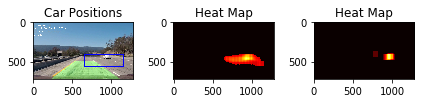

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0564.jpg


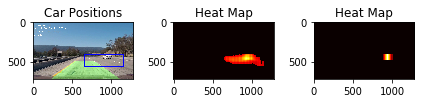

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0565.jpg


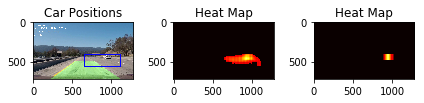

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0566.jpg


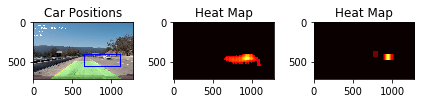

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0567.jpg


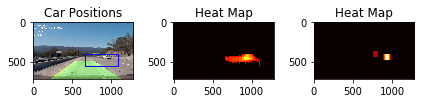

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0568.jpg


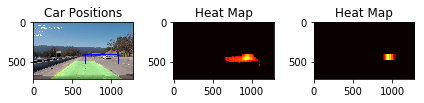

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0569.jpg


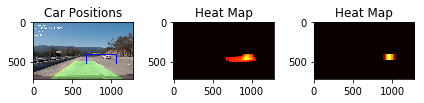

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0570.jpg


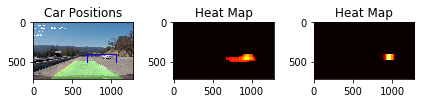

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0571.jpg


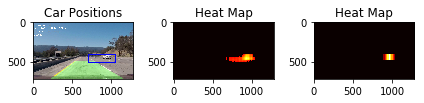

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0572.jpg


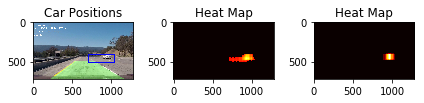

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0573.jpg


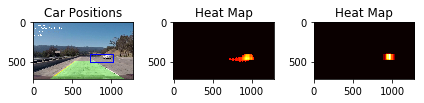

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0574.jpg


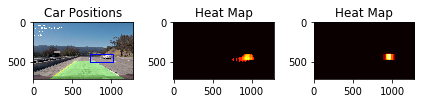

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0575.jpg


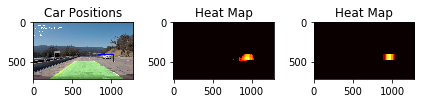

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0576.jpg


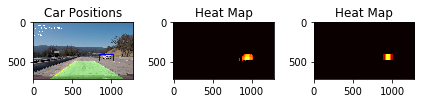

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0577.jpg


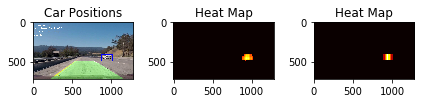

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0578.jpg


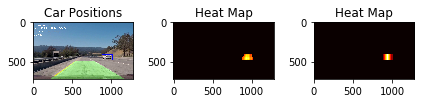

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0579.jpg


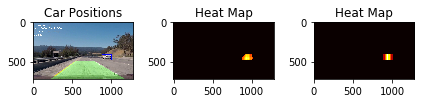

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0580.jpg


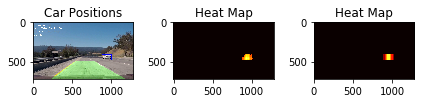

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0581.jpg


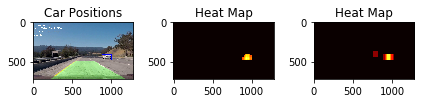

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0582.jpg


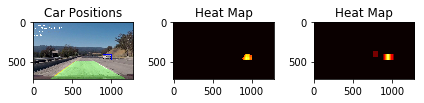

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0583.jpg


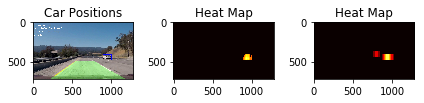

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0584.jpg


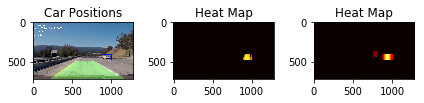

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0585.jpg


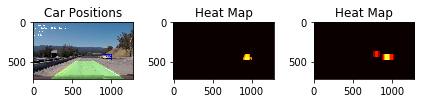

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0586.jpg


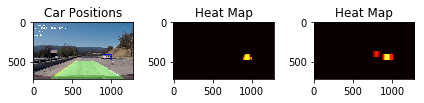

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0587.jpg


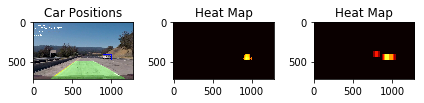

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0588.jpg


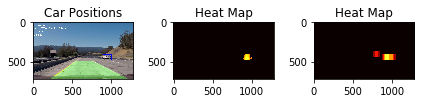

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0589.jpg


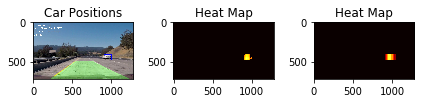

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0590.jpg


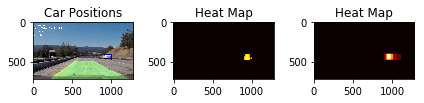

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0591.jpg


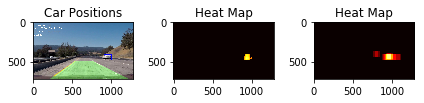

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0592.jpg


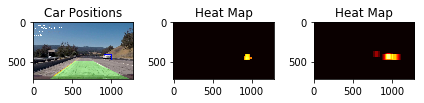

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0593.jpg


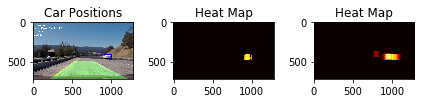

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0594.jpg


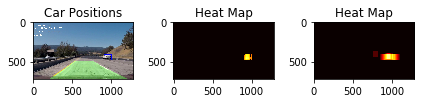

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0595.jpg


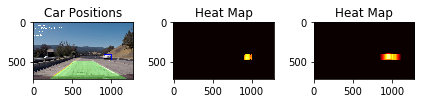

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0596.jpg


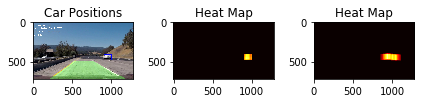

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0597.jpg


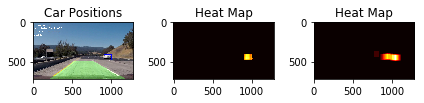

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0598.jpg


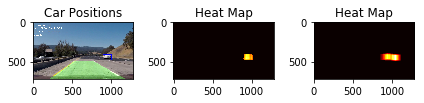

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0599.jpg


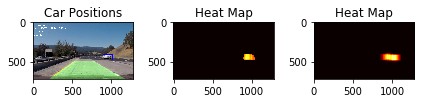

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0600.jpg


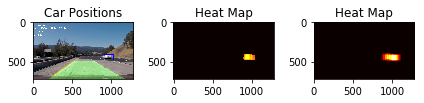

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0601.jpg


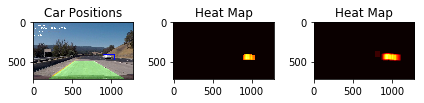

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0602.jpg


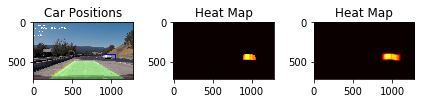

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0603.jpg


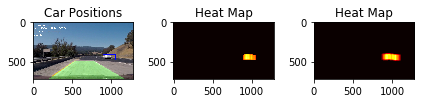

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0604.jpg


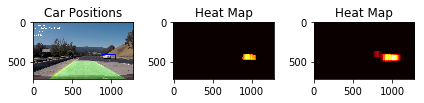

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0605.jpg


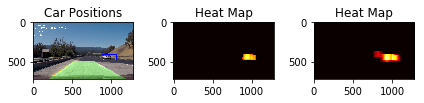

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0606.jpg


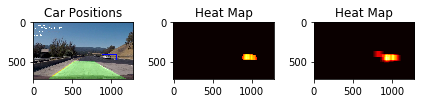

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0607.jpg


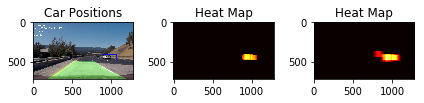

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0608.jpg


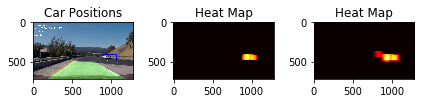

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0609.jpg


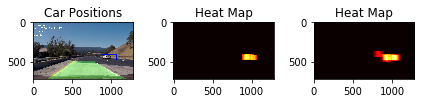

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0610.jpg


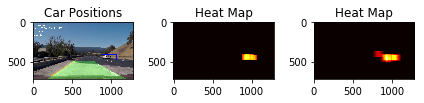

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0611.jpg


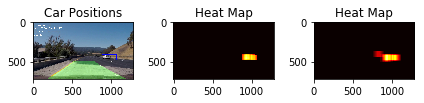

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0612.jpg


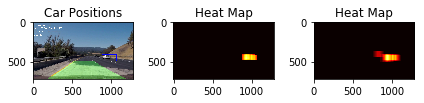

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0613.jpg


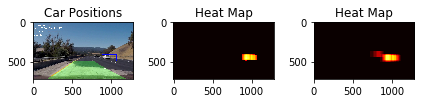

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0614.jpg


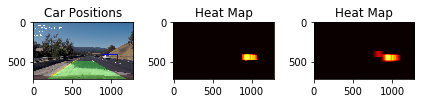

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0615.jpg


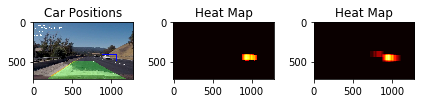

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0616.jpg


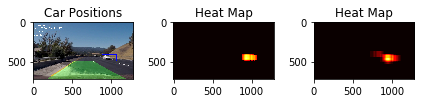

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0617.jpg


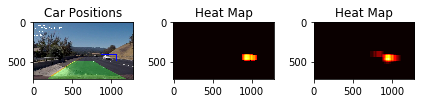

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0618.jpg


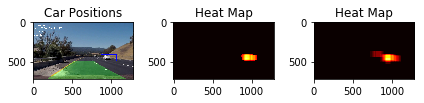

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0619.jpg


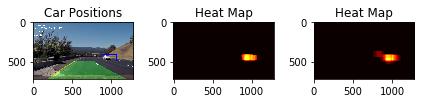

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0620.jpg


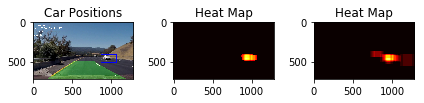

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0621.jpg


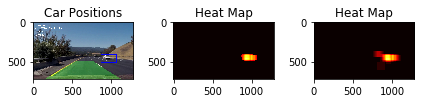

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0622.jpg


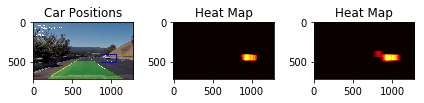

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0623.jpg


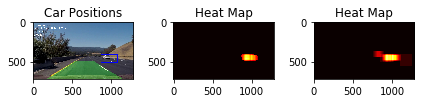

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0624.jpg


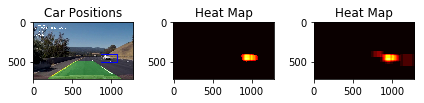

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0625.jpg


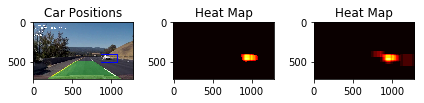

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0626.jpg


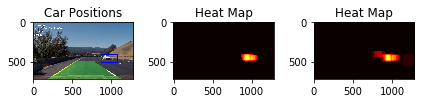

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0627.jpg


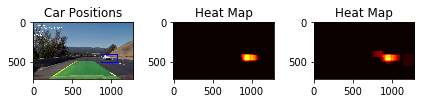

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0628.jpg


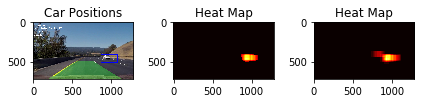

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0629.jpg


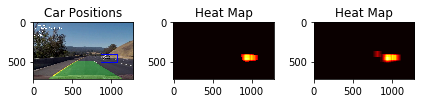

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0630.jpg


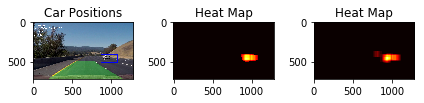

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0631.jpg


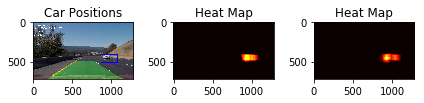

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0632.jpg


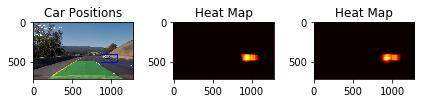

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0633.jpg


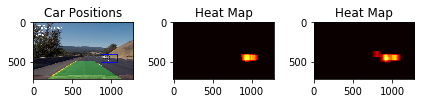

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0634.jpg


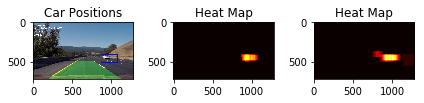

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0635.jpg


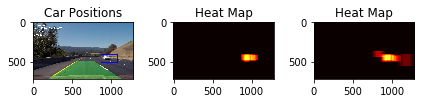

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0636.jpg


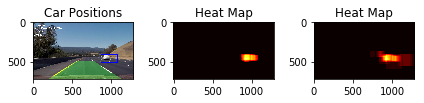

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0637.jpg


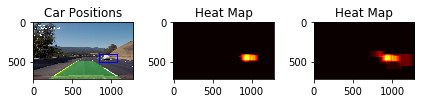

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0638.jpg


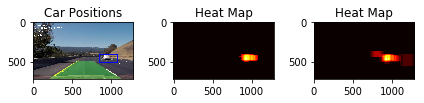

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0639.jpg


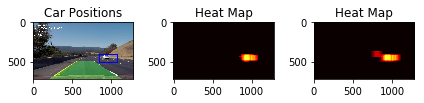

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0640.jpg


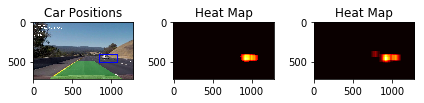

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0641.jpg


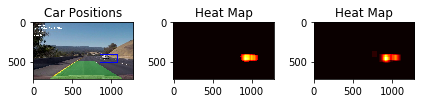

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0642.jpg


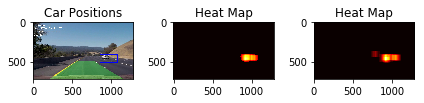

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0643.jpg


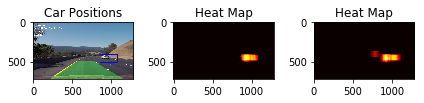

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0644.jpg


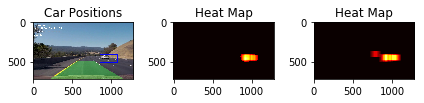

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0645.jpg


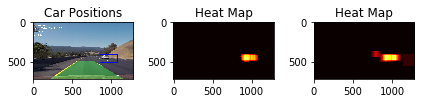

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0646.jpg


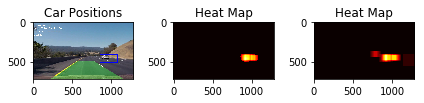

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0647.jpg


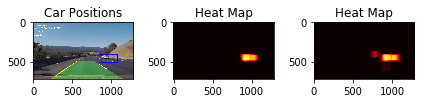

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0648.jpg


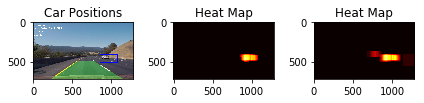

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0649.jpg


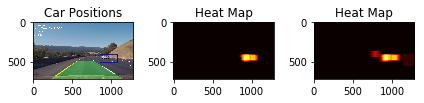

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0650.jpg


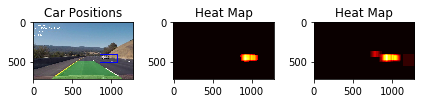

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0651.jpg


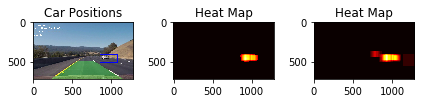

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0652.jpg


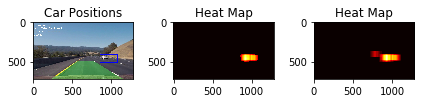

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0653.jpg


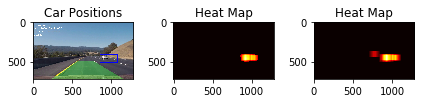

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0654.jpg


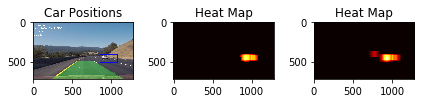

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0655.jpg


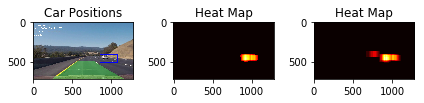

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0656.jpg


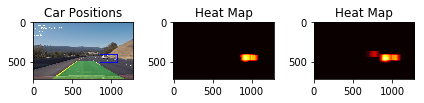

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0657.jpg


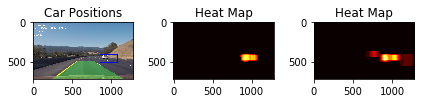

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0658.jpg


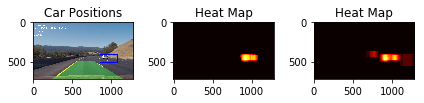

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0659.jpg


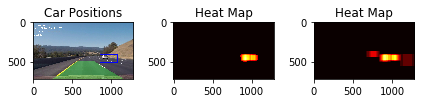

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0660.jpg


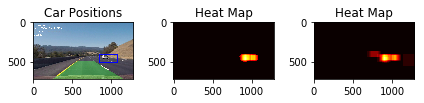

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0661.jpg


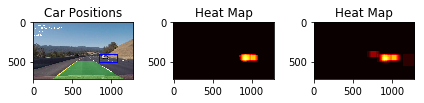

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0662.jpg


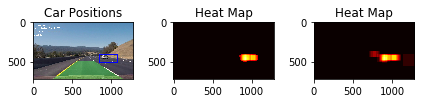

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0663.jpg


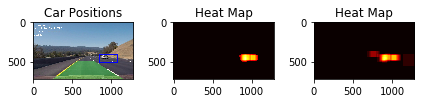

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0664.jpg


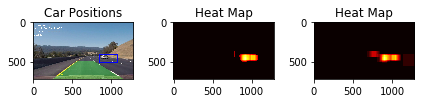

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0665.jpg


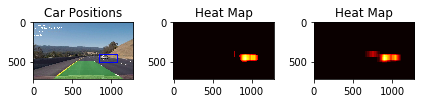

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0666.jpg


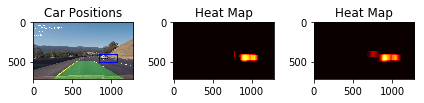

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0667.jpg


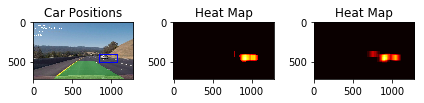

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0668.jpg


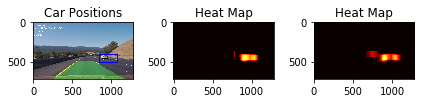

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0669.jpg


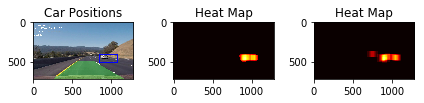

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0670.jpg


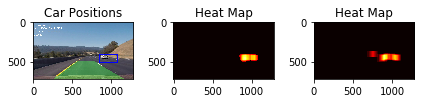

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0671.jpg


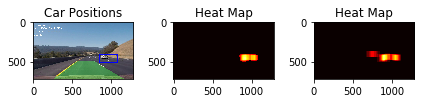

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0672.jpg


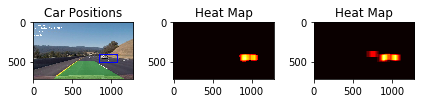

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0673.jpg


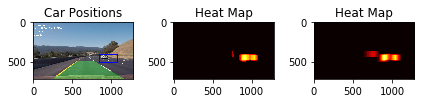

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0674.jpg


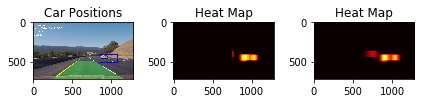

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0675.jpg


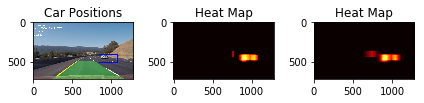

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0676.jpg


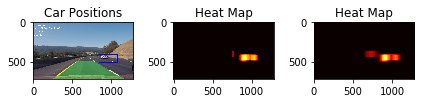

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0677.jpg


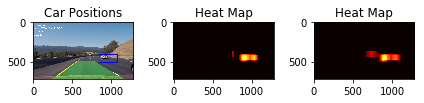

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0678.jpg


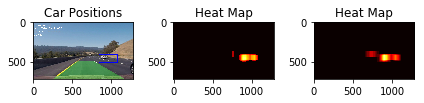

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0679.jpg


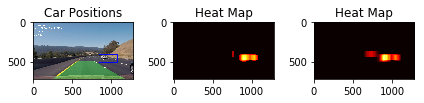

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0680.jpg


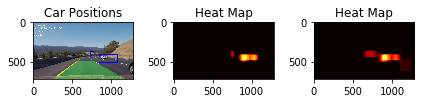

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0681.jpg


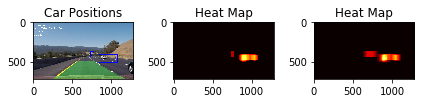

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0682.jpg


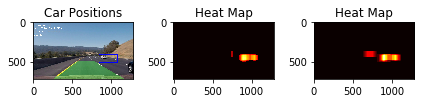

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0683.jpg


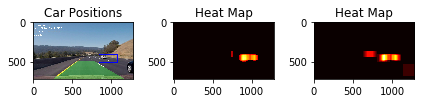

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0684.jpg


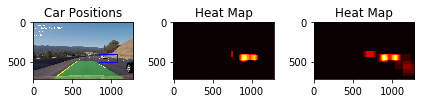

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0685.jpg


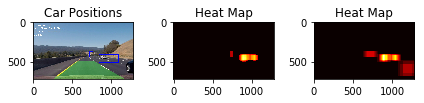

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0686.jpg


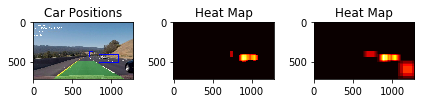

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0687.jpg


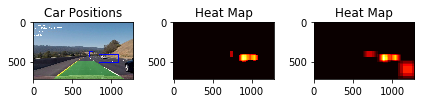

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0688.jpg


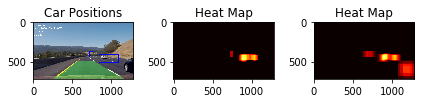

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0689.jpg


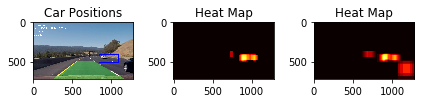

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0690.jpg


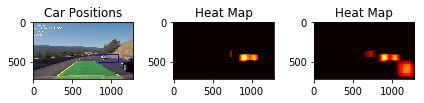

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0691.jpg


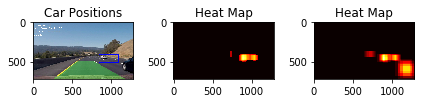

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0692.jpg


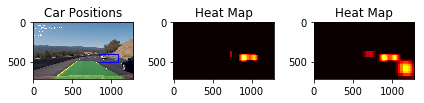

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0693.jpg


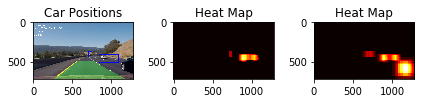

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0694.jpg


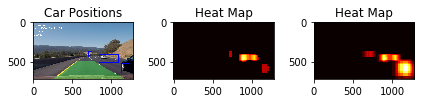

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0695.jpg


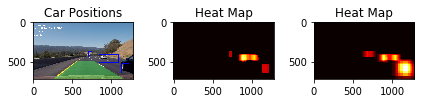

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0696.jpg


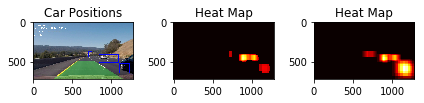

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0697.jpg


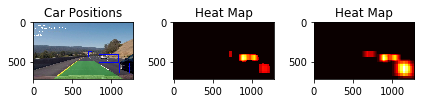

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0698.jpg


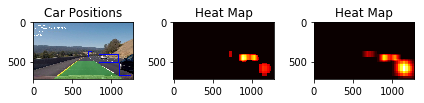

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0699.jpg


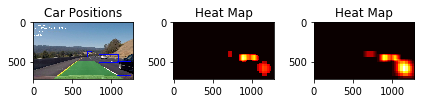

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0700.jpg


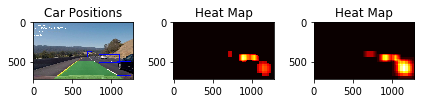

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0701.jpg


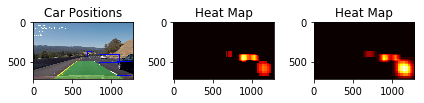

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0702.jpg


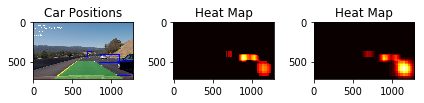

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0703.jpg


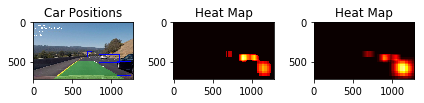

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0704.jpg


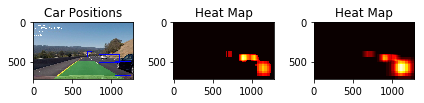

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0705.jpg


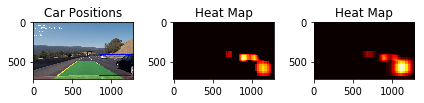

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0706.jpg


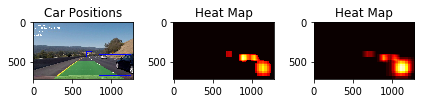

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0707.jpg


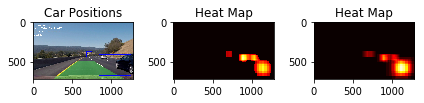

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0708.jpg


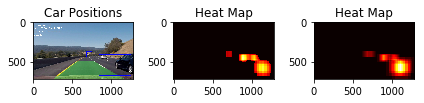

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0709.jpg


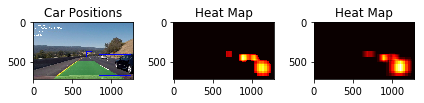

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0710.jpg


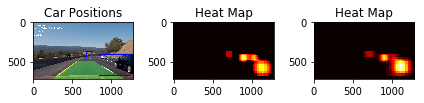

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0711.jpg


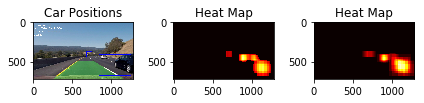

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0712.jpg


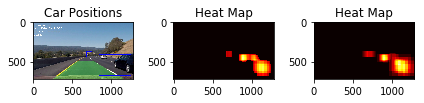

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0713.jpg


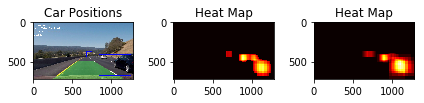

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0714.jpg


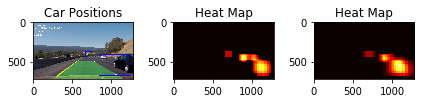

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0715.jpg


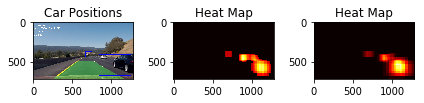

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0716.jpg


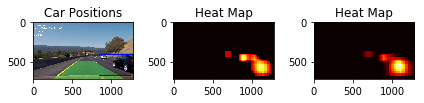

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0717.jpg


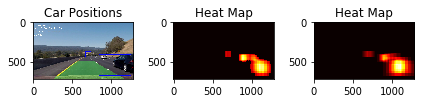

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0718.jpg


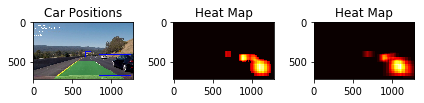

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0719.jpg


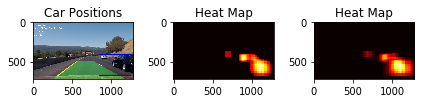

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0720.jpg


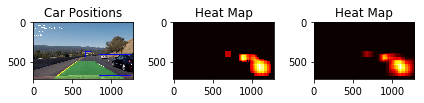

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0721.jpg


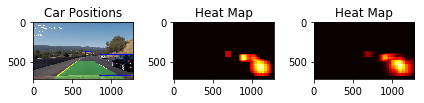

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0722.jpg


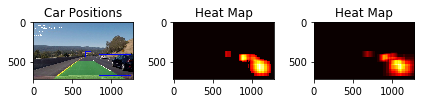

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0723.jpg


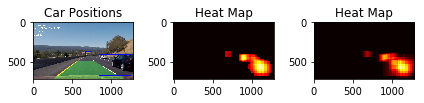

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0724.jpg


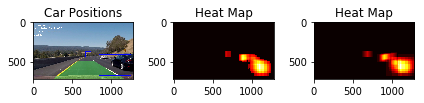

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0725.jpg


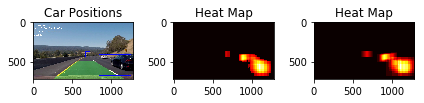

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0726.jpg


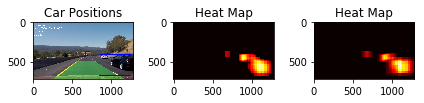

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0727.jpg


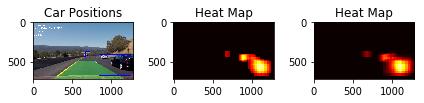

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0728.jpg


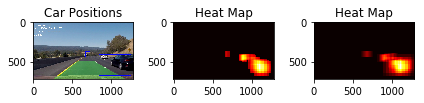

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0729.jpg


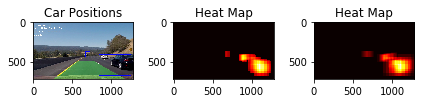

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0730.jpg


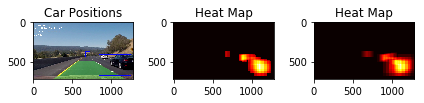

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0731.jpg


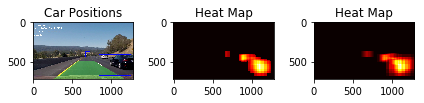

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0732.jpg


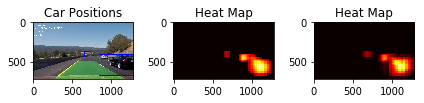

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0733.jpg


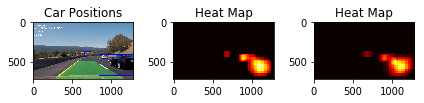

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0734.jpg


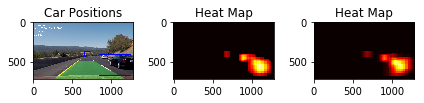

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0735.jpg


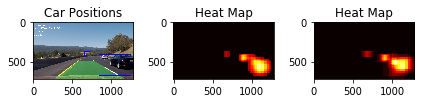

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0736.jpg


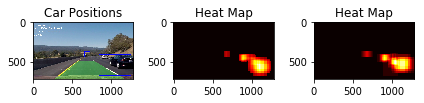

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0737.jpg


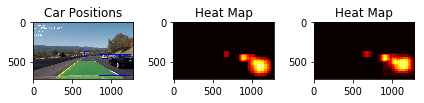

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0738.jpg


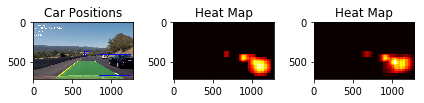

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0739.jpg


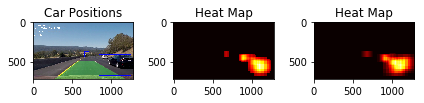

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0740.jpg


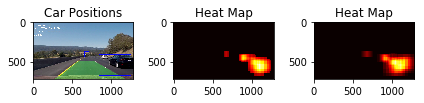

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0741.jpg


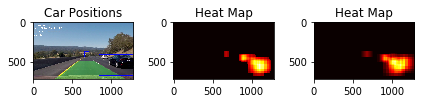

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0742.jpg


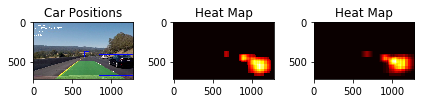

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0743.jpg


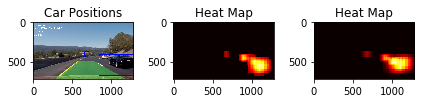

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0744.jpg


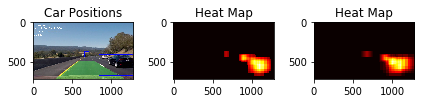

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0745.jpg


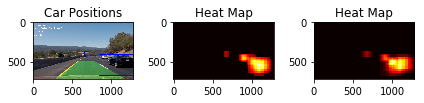

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0746.jpg


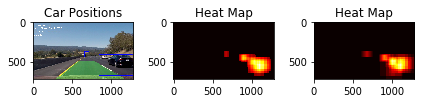

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0747.jpg


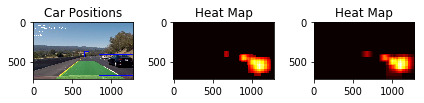

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0748.jpg


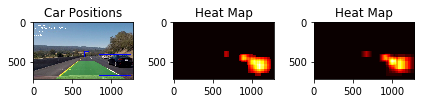

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0749.jpg


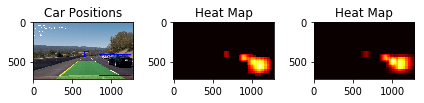

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0750.jpg


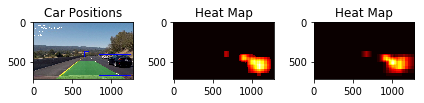

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0751.jpg


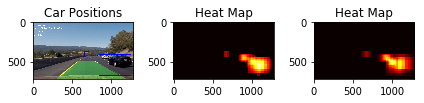

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0752.jpg


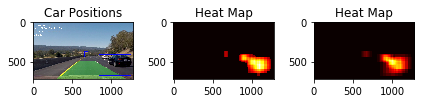

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0753.jpg


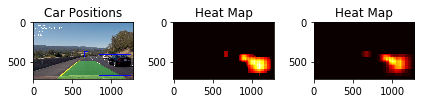

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0754.jpg


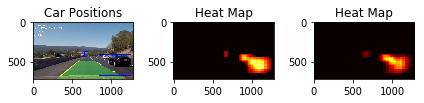

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0755.jpg


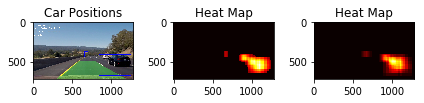

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0756.jpg


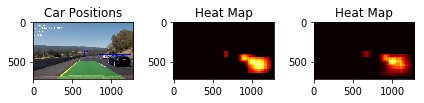

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0757.jpg


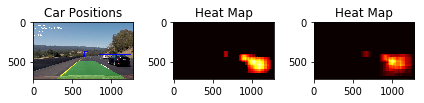

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0758.jpg


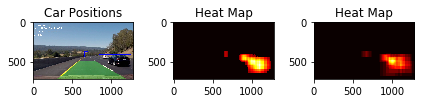

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0759.jpg


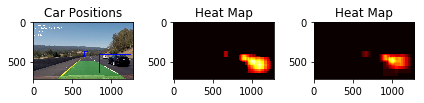

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0760.jpg


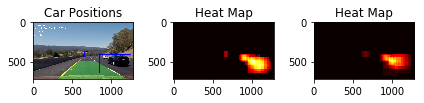

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0761.jpg


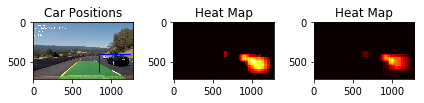

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0762.jpg


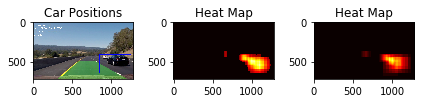

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0763.jpg


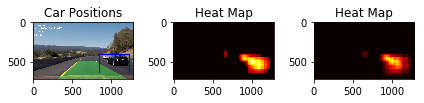

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0764.jpg


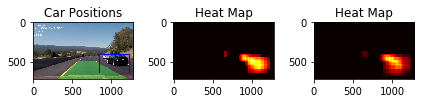

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0765.jpg


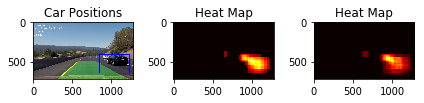

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0766.jpg


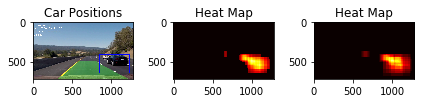

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0767.jpg


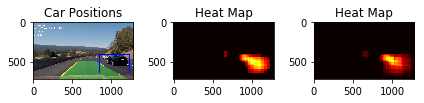

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0768.jpg


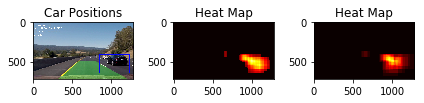

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0769.jpg


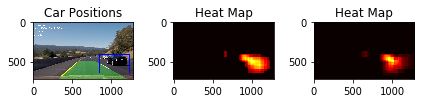

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0770.jpg


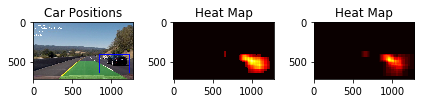

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0771.jpg


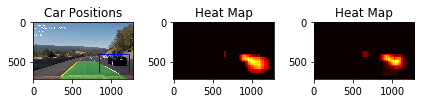

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0772.jpg


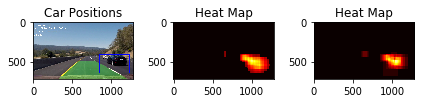

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0773.jpg


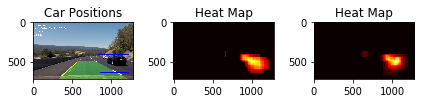

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0774.jpg


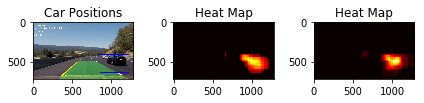

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0775.jpg


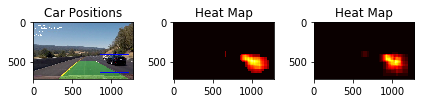

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0776.jpg


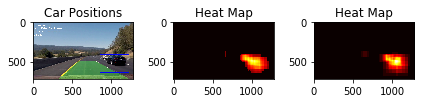

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0777.jpg


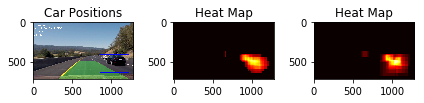

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0778.jpg


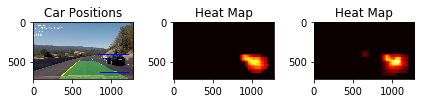

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0779.jpg


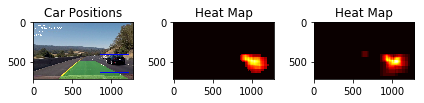

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0780.jpg


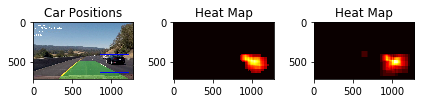

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0781.jpg


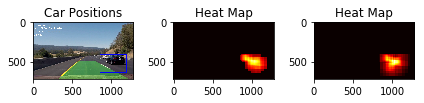

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0782.jpg


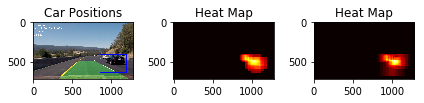

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0783.jpg


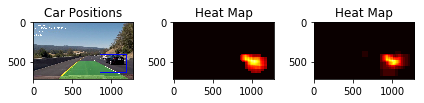

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0784.jpg


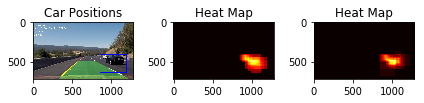

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0785.jpg


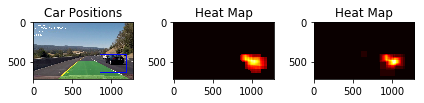

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0786.jpg


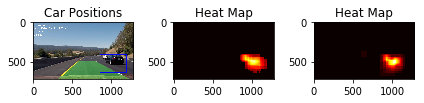

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0787.jpg


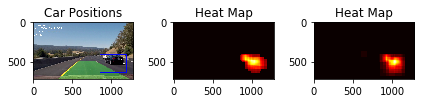

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0788.jpg


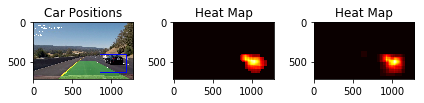

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0789.jpg


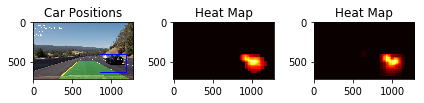

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0790.jpg


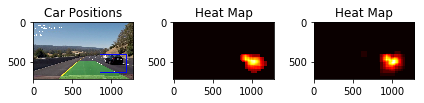

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0791.jpg


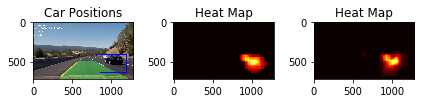

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0792.jpg


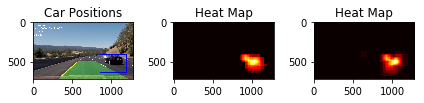

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0793.jpg


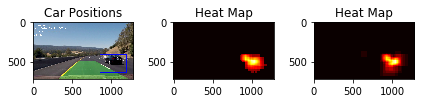

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0794.jpg


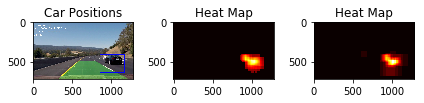

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0795.jpg


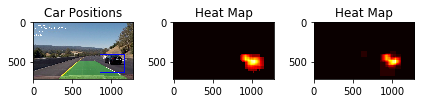

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0796.jpg


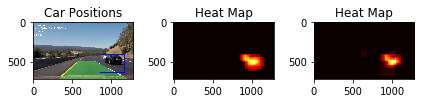

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0797.jpg


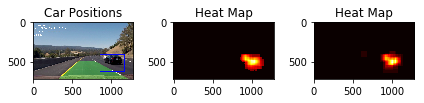

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0798.jpg


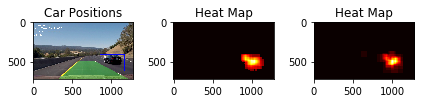

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0799.jpg


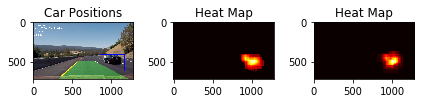

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0800.jpg


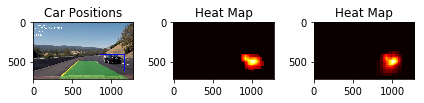

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0801.jpg


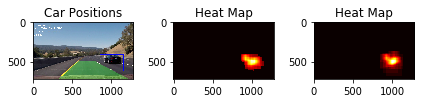

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0802.jpg


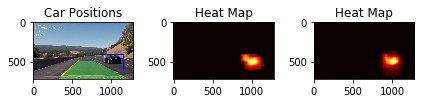

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0803.jpg


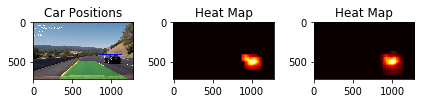

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0804.jpg


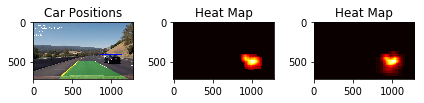

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0805.jpg


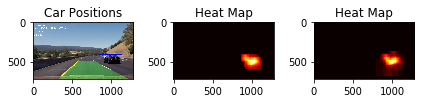

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0806.jpg


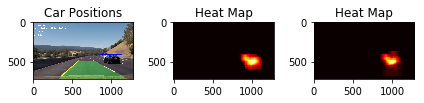

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0807.jpg


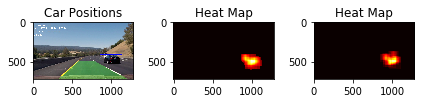

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0808.jpg


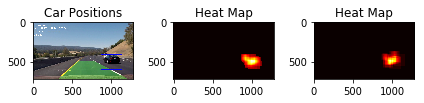

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0809.jpg


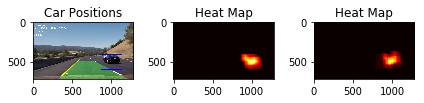

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0810.jpg


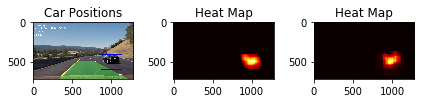

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0811.jpg


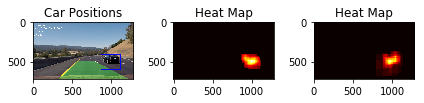

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0812.jpg


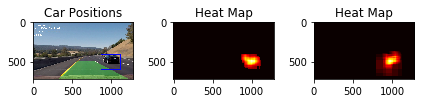

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0813.jpg


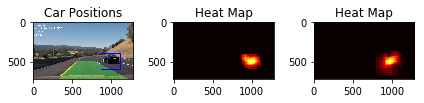

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0814.jpg


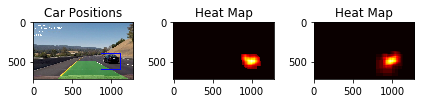

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0815.jpg


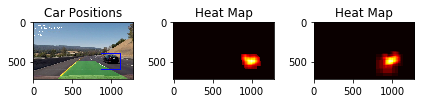

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0816.jpg


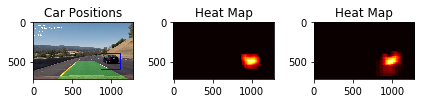

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0817.jpg


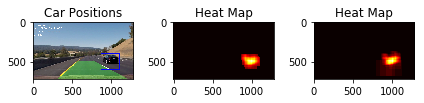

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0818.jpg


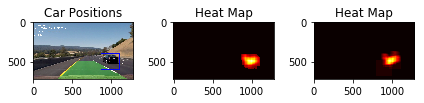

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0819.jpg


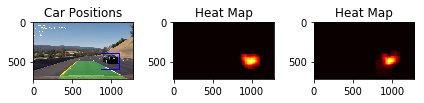

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0820.jpg


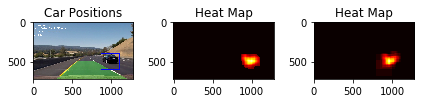

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0821.jpg


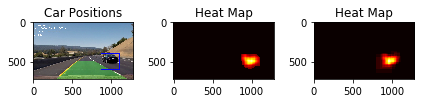

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0822.jpg


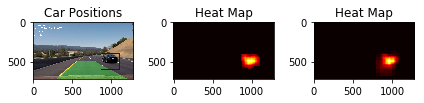

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0823.jpg


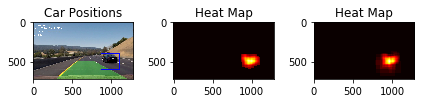

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0824.jpg


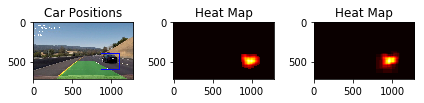

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0825.jpg


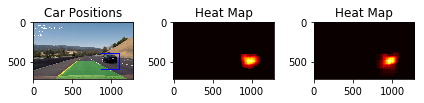

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0826.jpg


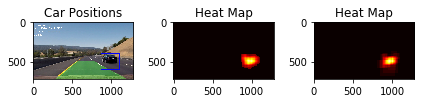

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0827.jpg


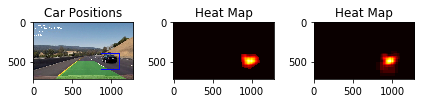

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0828.jpg


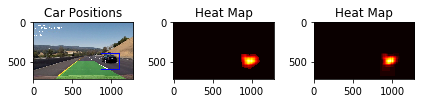

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0829.jpg


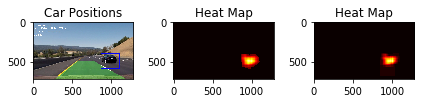

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0830.jpg


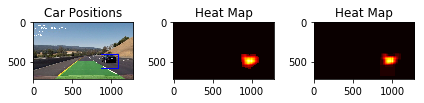

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0831.jpg


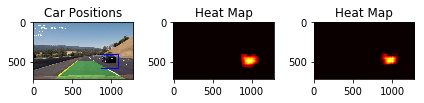

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0832.jpg


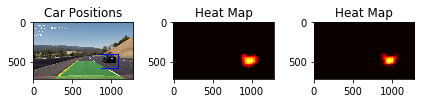

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0833.jpg


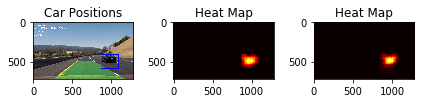

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0834.jpg


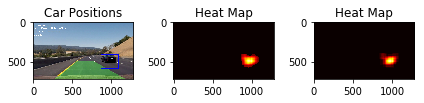

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0835.jpg


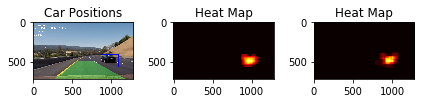

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0836.jpg


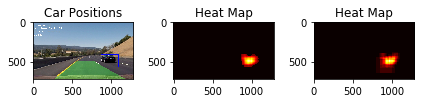

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0837.jpg


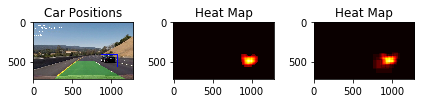

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0838.jpg


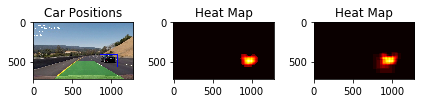

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0839.jpg


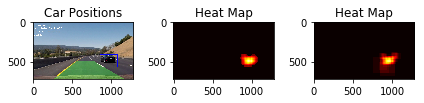

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0840.jpg


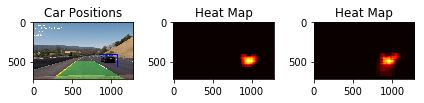

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0841.jpg


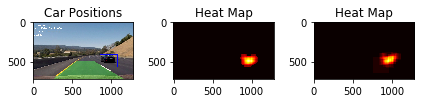

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0842.jpg


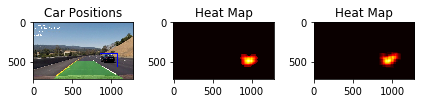

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0843.jpg


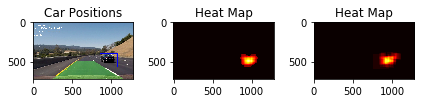

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0844.jpg


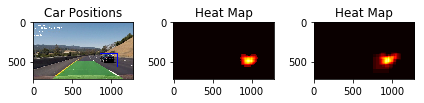

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0845.jpg


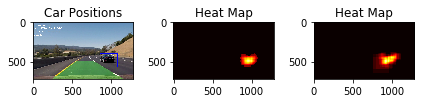

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0846.jpg


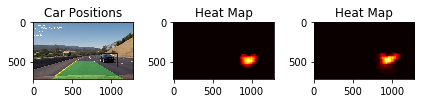

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0847.jpg


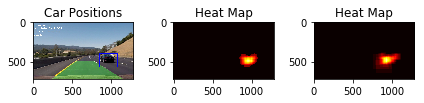

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0848.jpg


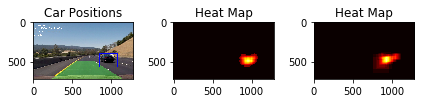

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0849.jpg


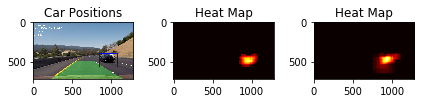

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0850.jpg


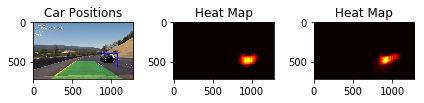

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0851.jpg


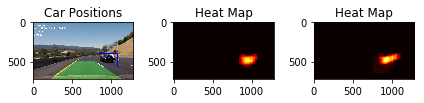

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0852.jpg


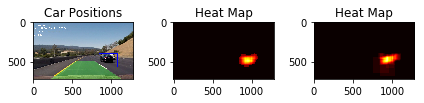

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0853.jpg


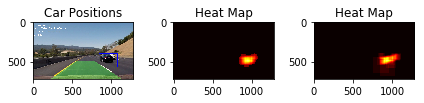

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0854.jpg


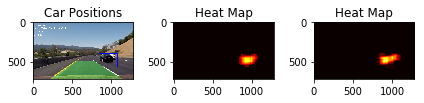

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0855.jpg


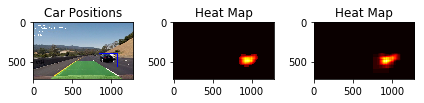

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0856.jpg


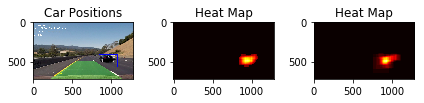

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0857.jpg


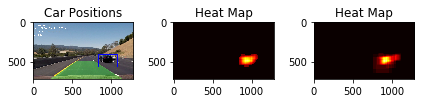

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0858.jpg


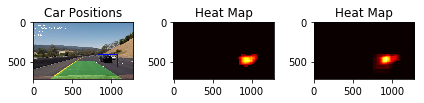

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0859.jpg


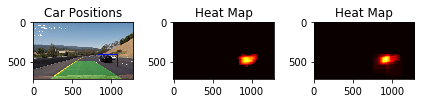

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0860.jpg


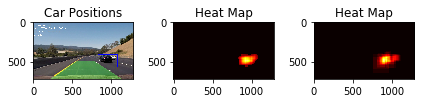

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0861.jpg


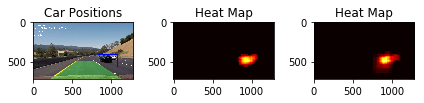

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0862.jpg


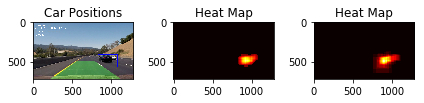

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0863.jpg


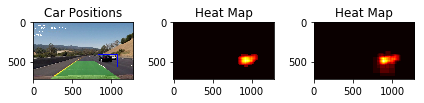

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0864.jpg


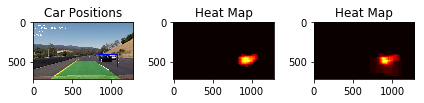

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0865.jpg


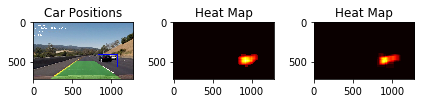

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0866.jpg


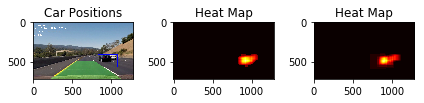

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0867.jpg


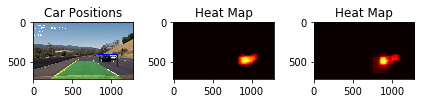

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0868.jpg


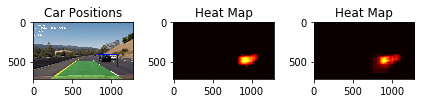

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0869.jpg


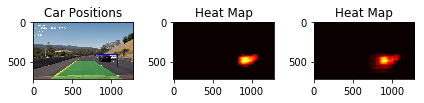

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0870.jpg


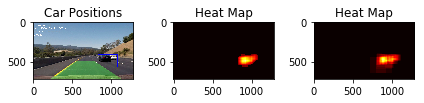

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0871.jpg


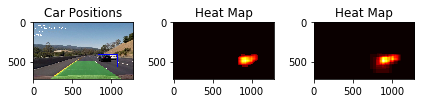

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0872.jpg


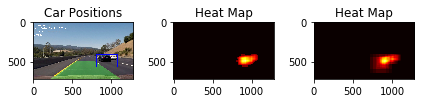

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0873.jpg


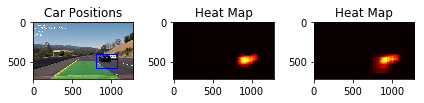

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0874.jpg


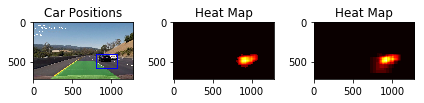

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0875.jpg


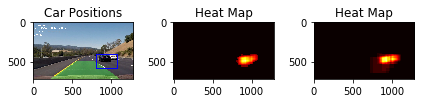

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0876.jpg


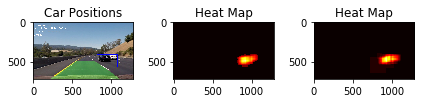

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0877.jpg


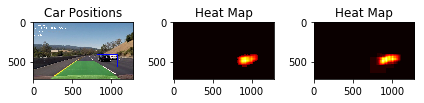

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0878.jpg


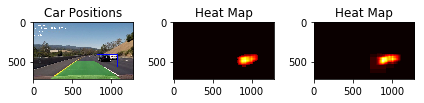

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0879.jpg


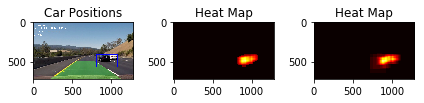

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0880.jpg


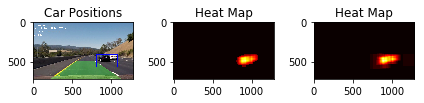

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0881.jpg


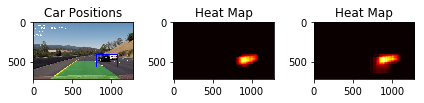

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0882.jpg


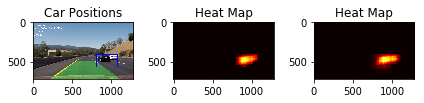

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0883.jpg


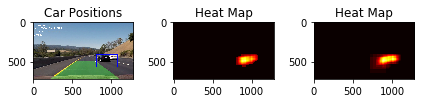

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0884.jpg


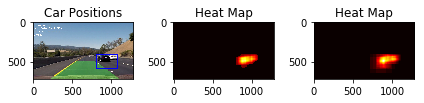

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0885.jpg


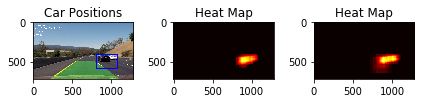

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0886.jpg


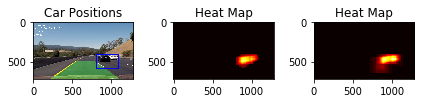

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0887.jpg


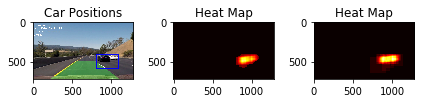

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0888.jpg


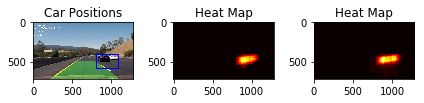

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0889.jpg


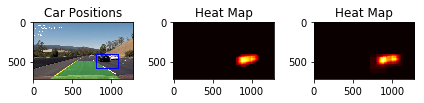

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0890.jpg


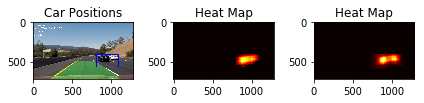

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0891.jpg


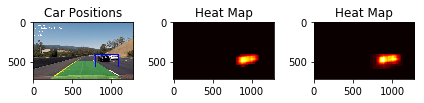

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0892.jpg


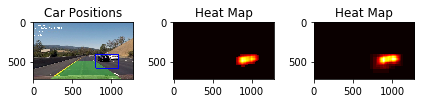

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0893.jpg


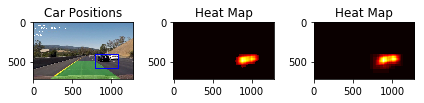

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0894.jpg


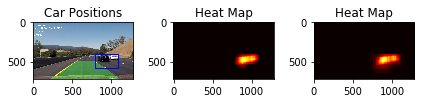

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0895.jpg


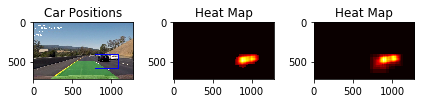

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0896.jpg


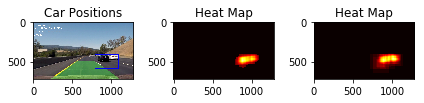

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0897.jpg


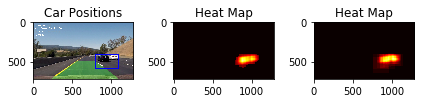

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0898.jpg


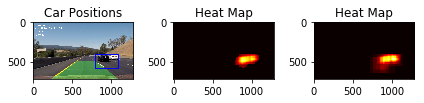

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0899.jpg


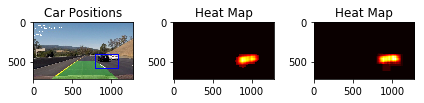

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0900.jpg


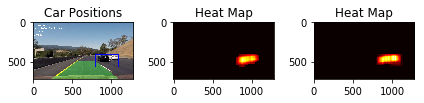

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0901.jpg


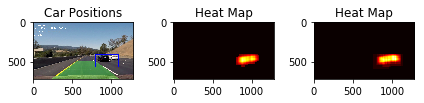

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0902.jpg


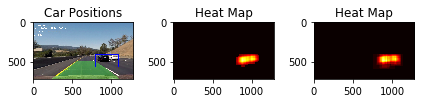

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0903.jpg


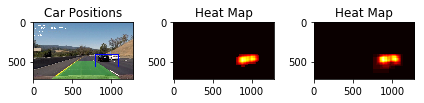

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0904.jpg


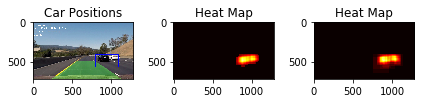

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0905.jpg


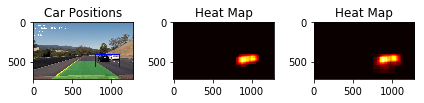

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0906.jpg


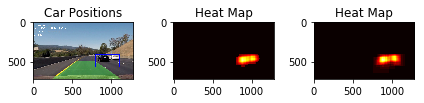

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0907.jpg


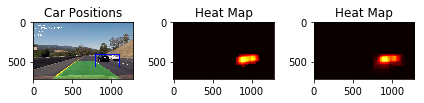

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0908.jpg


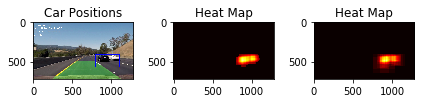

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0909.jpg


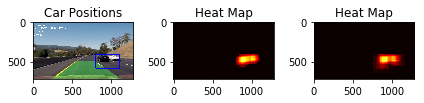

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0910.jpg


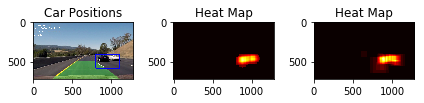

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0911.jpg


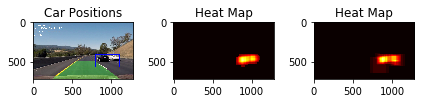

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0912.jpg


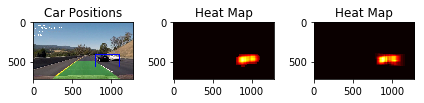

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0913.jpg


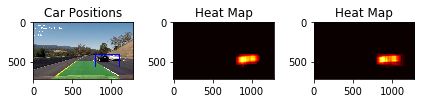

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0914.jpg


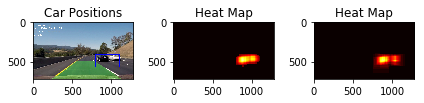

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0915.jpg


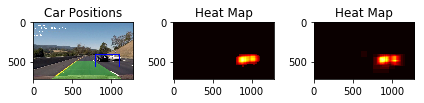

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0916.jpg


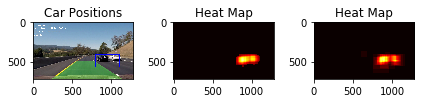

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0917.jpg


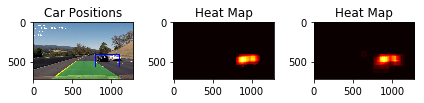

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0918.jpg


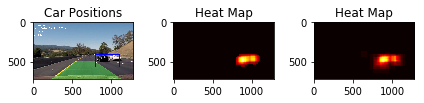

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0919.jpg


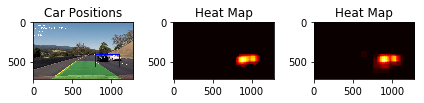

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0920.jpg


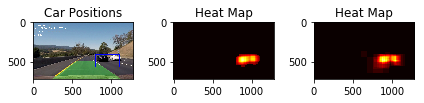

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0921.jpg


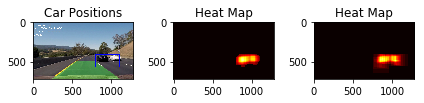

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0922.jpg


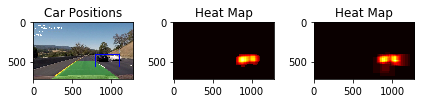

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0923.jpg


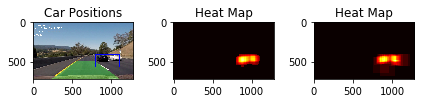

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0924.jpg


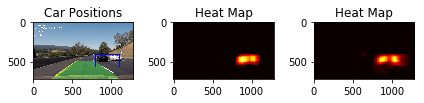

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0925.jpg


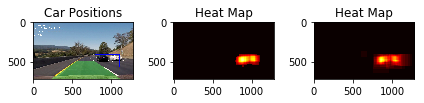

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0926.jpg


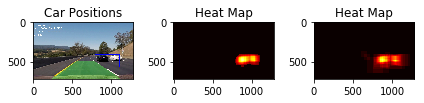

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0927.jpg


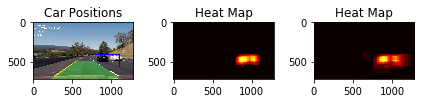

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0928.jpg


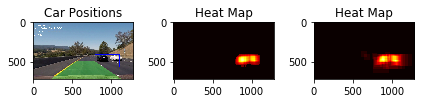

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0929.jpg


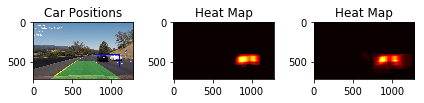

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0930.jpg


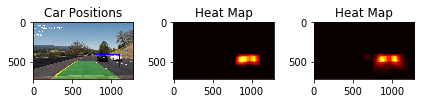

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0931.jpg


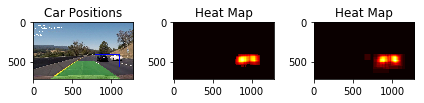

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0932.jpg


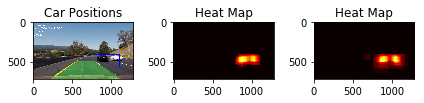

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0933.jpg


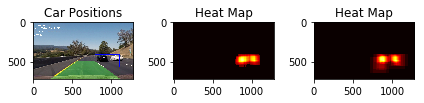

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0934.jpg


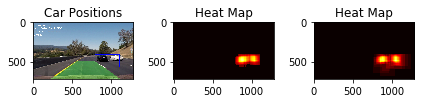

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0935.jpg


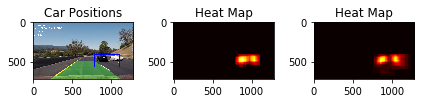

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0936.jpg


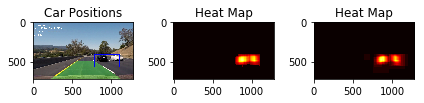

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0937.jpg


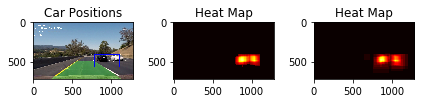

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0938.jpg


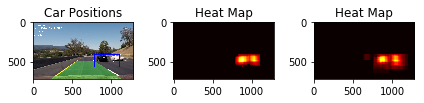

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0939.jpg


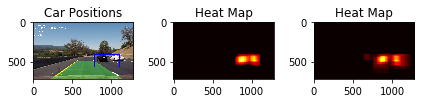

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0940.jpg


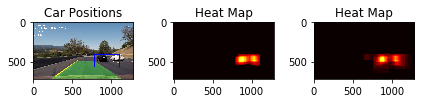

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0941.jpg


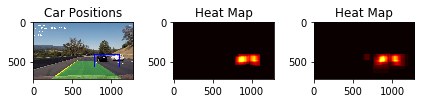

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0942.jpg


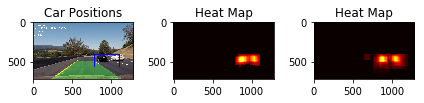

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0943.jpg


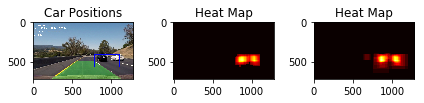

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0944.jpg


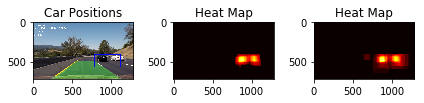

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0945.jpg


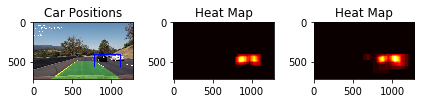

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0946.jpg


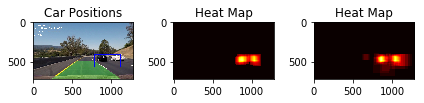

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0947.jpg


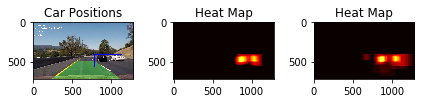

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0948.jpg


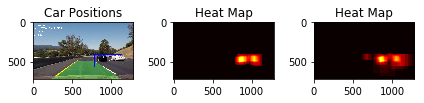

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0949.jpg


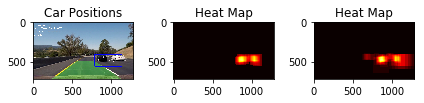

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0950.jpg


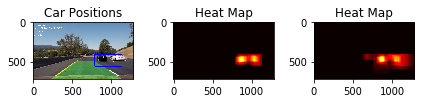

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0951.jpg


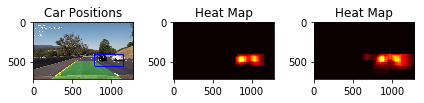

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0952.jpg


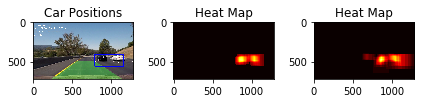

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0953.jpg


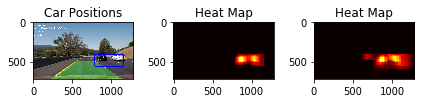

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0954.jpg


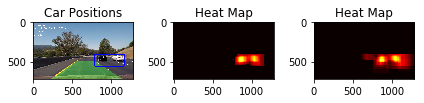

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0955.jpg


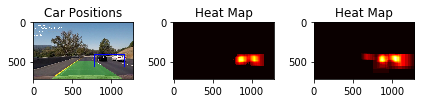

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0956.jpg


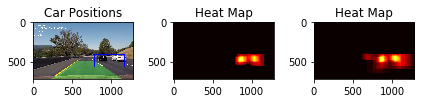

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0957.jpg


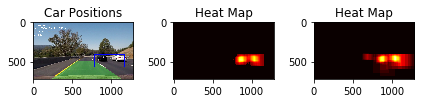

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0958.jpg


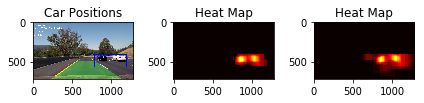

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0959.jpg


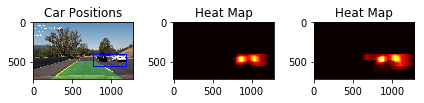

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0960.jpg


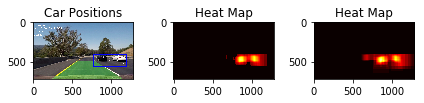

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0961.jpg


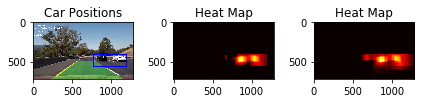

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0962.jpg


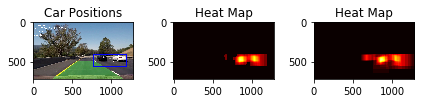

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0963.jpg


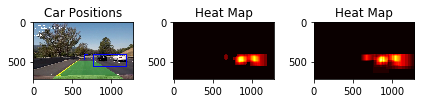

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0964.jpg


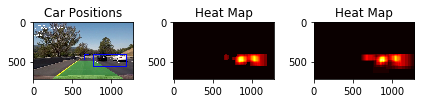

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0965.jpg


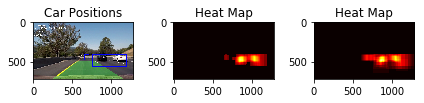

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0966.jpg


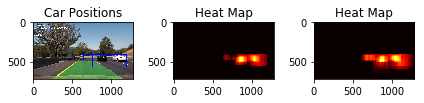

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0967.jpg


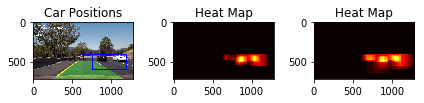

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0968.jpg


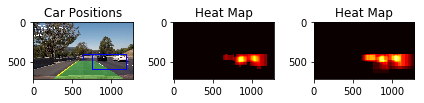

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0969.jpg


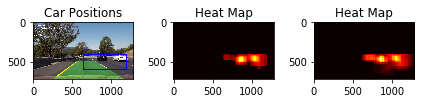

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0970.jpg


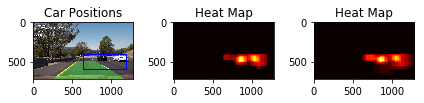

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0971.jpg


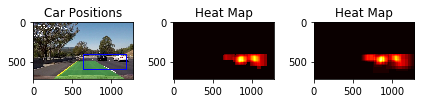

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0972.jpg


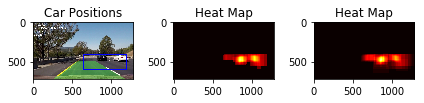

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0973.jpg


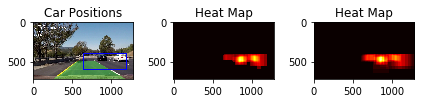

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0974.jpg


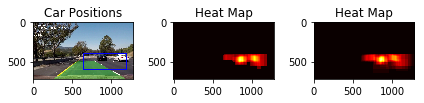

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0975.jpg


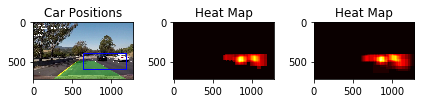

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0976.jpg


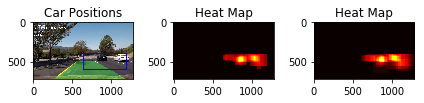

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0977.jpg


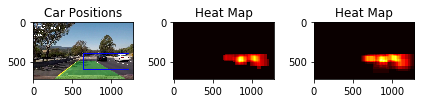

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0978.jpg


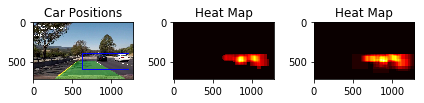

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0979.jpg


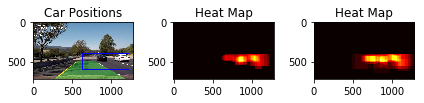

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0980.jpg


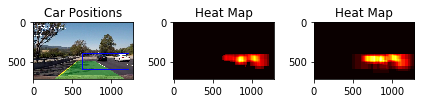

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0981.jpg


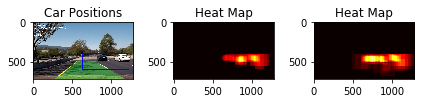

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0982.jpg


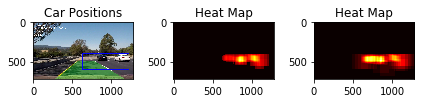

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0983.jpg


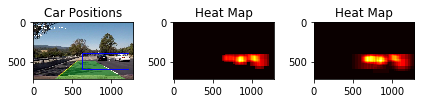

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0984.jpg


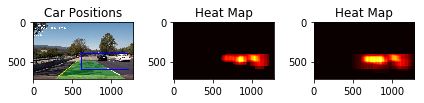

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0985.jpg


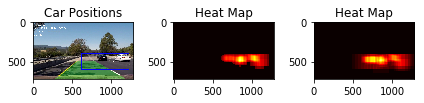

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0986.jpg


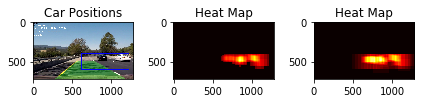

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0987.jpg


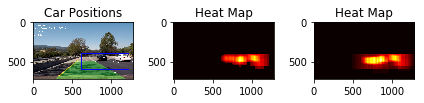

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0988.jpg


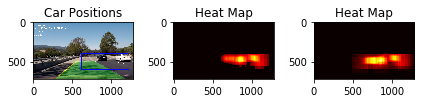

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0989.jpg


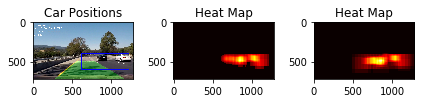

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0990.jpg


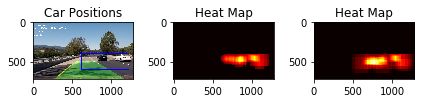

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0991.jpg


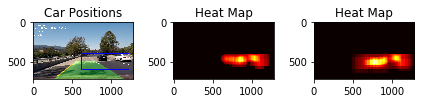

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0992.jpg


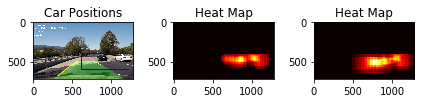

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0993.jpg


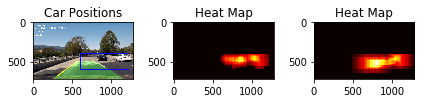

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0994.jpg


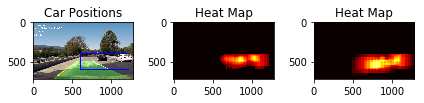

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0995.jpg


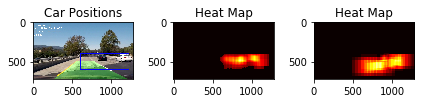

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0996.jpg


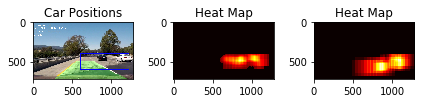

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0997.jpg


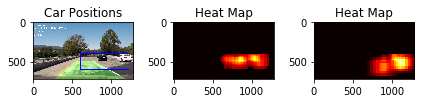

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0998.jpg


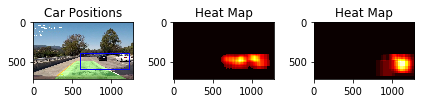

../CarND-Advanced-Lane-Lines-master/output_images\input_frame0999.jpg


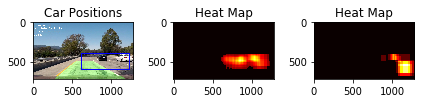

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1000.jpg


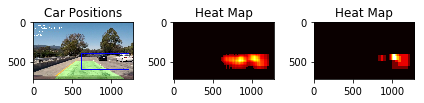

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1001.jpg


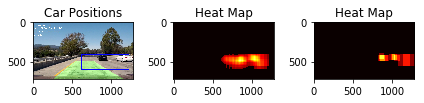

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1002.jpg


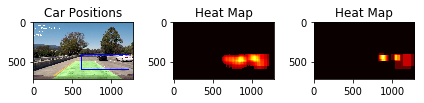

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1003.jpg


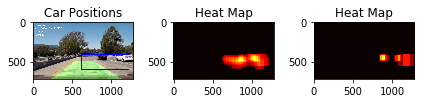

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1004.jpg


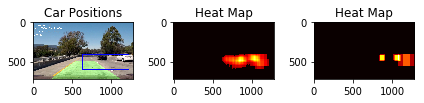

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1005.jpg


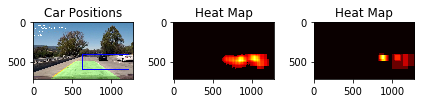

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1006.jpg


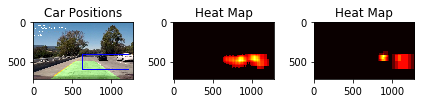

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1007.jpg


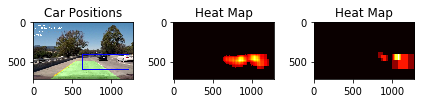

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1008.jpg


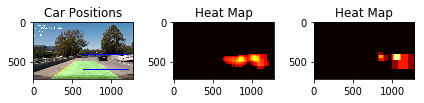

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1009.jpg


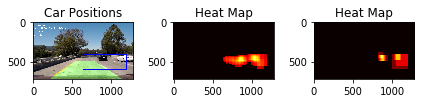

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1010.jpg


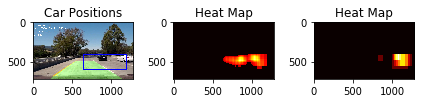

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1011.jpg


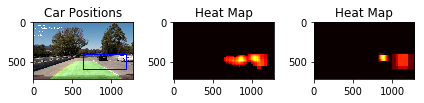

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1012.jpg


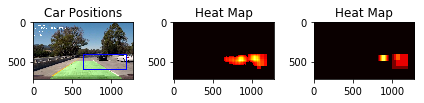

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1013.jpg


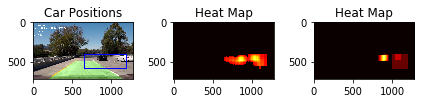

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1014.jpg


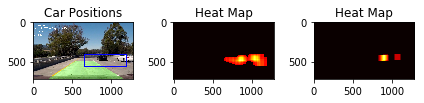

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1015.jpg


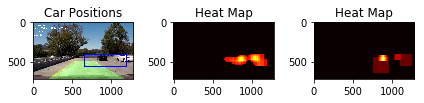

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1016.jpg


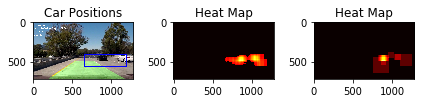

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1017.jpg


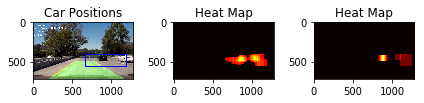

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1018.jpg


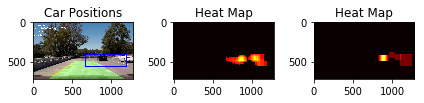

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1019.jpg


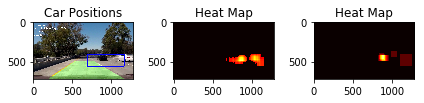

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1020.jpg


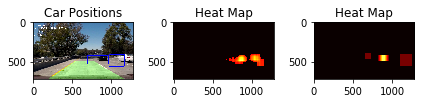

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1021.jpg


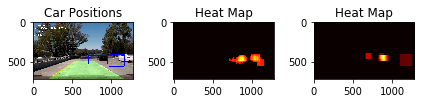

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1022.jpg


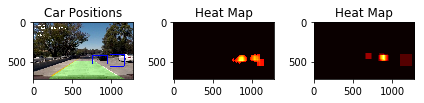

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1023.jpg


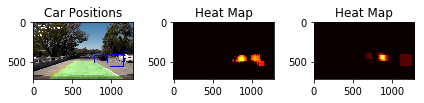

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1024.jpg


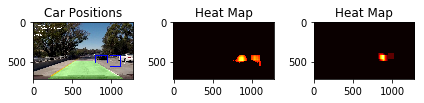

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1025.jpg


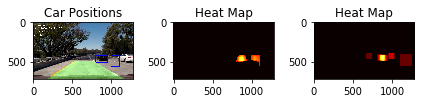

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1026.jpg


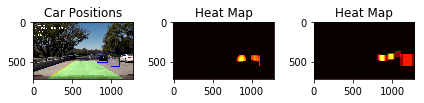

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1027.jpg


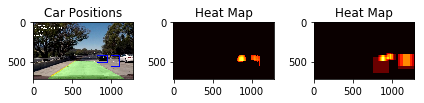

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1028.jpg


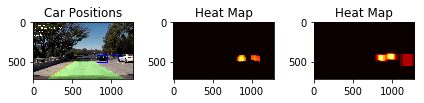

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1029.jpg


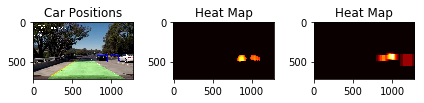

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1030.jpg


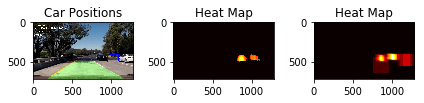

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1031.jpg


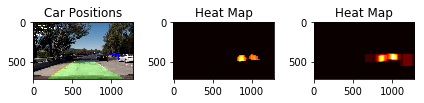

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1032.jpg


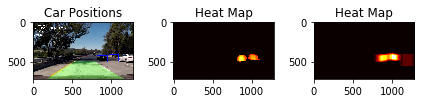

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1033.jpg


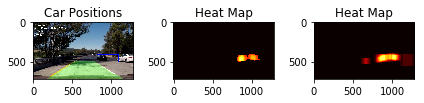

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1034.jpg


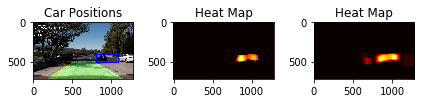

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1035.jpg


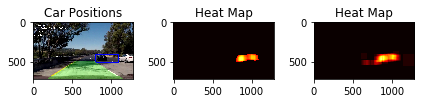

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1036.jpg


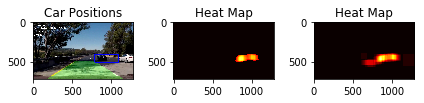

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1037.jpg


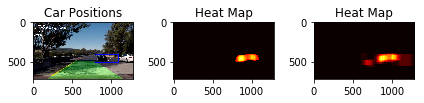

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1038.jpg


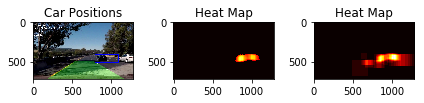

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1039.jpg


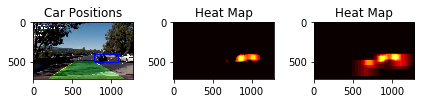

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1040.jpg


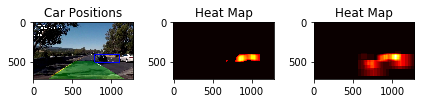

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1041.jpg


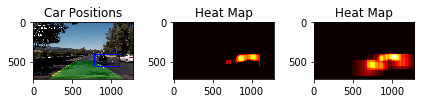

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1042.jpg


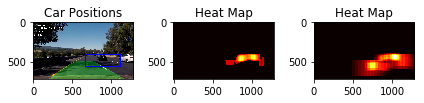

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1043.jpg


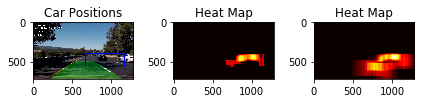

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1044.jpg


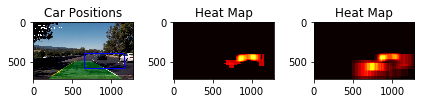

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1045.jpg


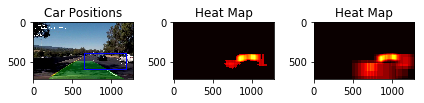

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1046.jpg


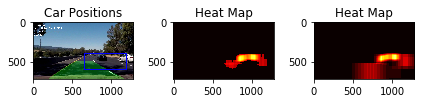

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1047.jpg


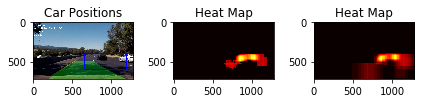

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1048.jpg


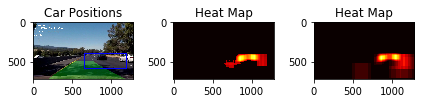

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1049.jpg


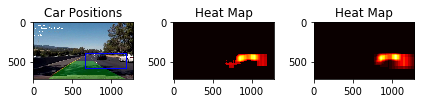

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1050.jpg


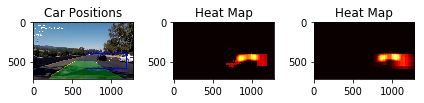

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1051.jpg


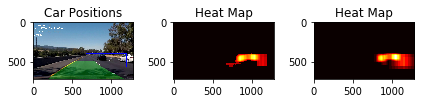

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1052.jpg


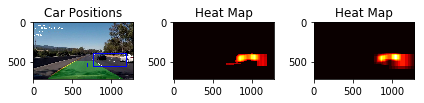

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1053.jpg


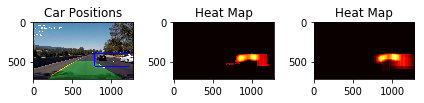

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1054.jpg


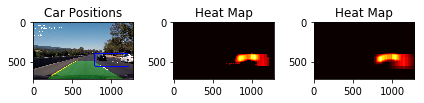

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1055.jpg


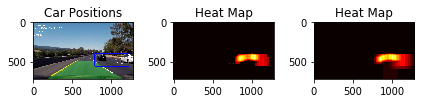

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1056.jpg


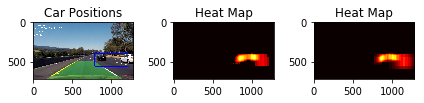

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1057.jpg


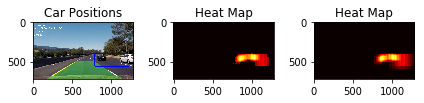

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1058.jpg


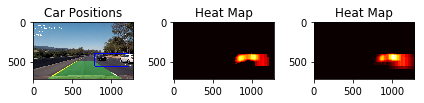

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1059.jpg


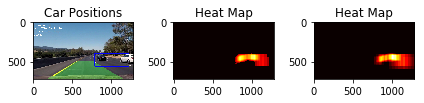

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1060.jpg


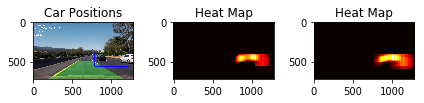

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1061.jpg


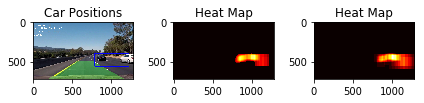

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1062.jpg


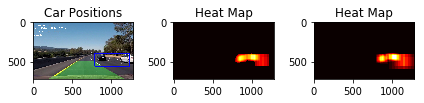

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1063.jpg


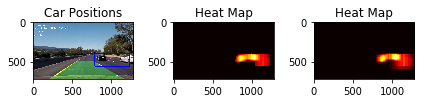

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1064.jpg


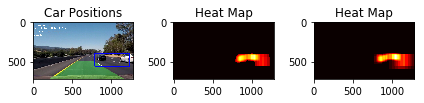

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1065.jpg


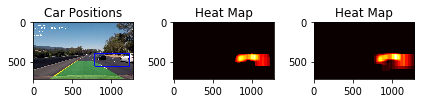

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1066.jpg


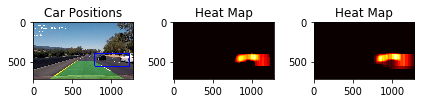

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1067.jpg


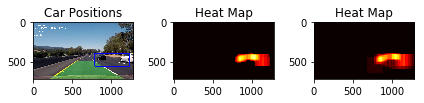

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1068.jpg


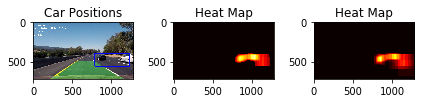

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1069.jpg


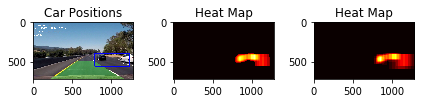

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1070.jpg


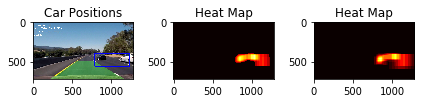

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1071.jpg


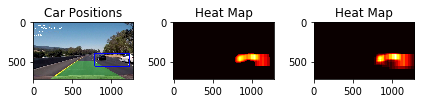

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1072.jpg


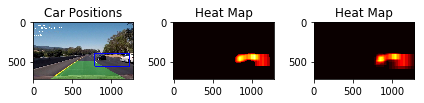

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1073.jpg


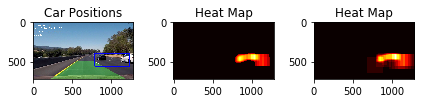

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1074.jpg


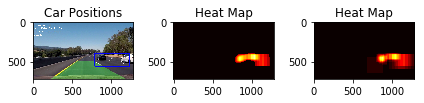

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1075.jpg


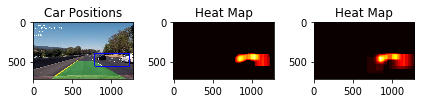

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1076.jpg


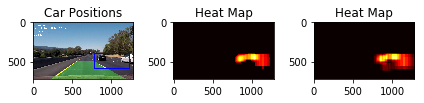

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1077.jpg


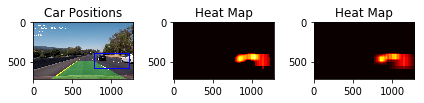

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1078.jpg


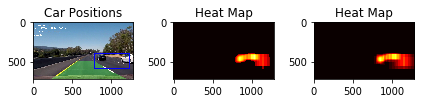

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1079.jpg


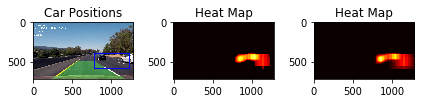

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1080.jpg


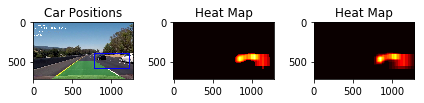

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1081.jpg


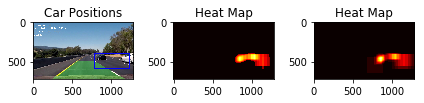

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1082.jpg


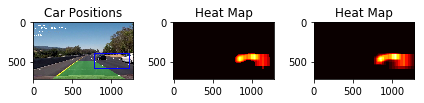

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1083.jpg


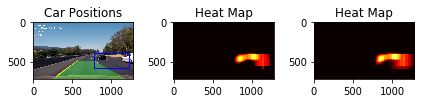

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1084.jpg


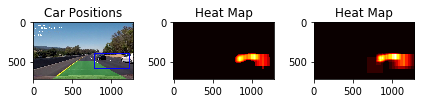

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1085.jpg


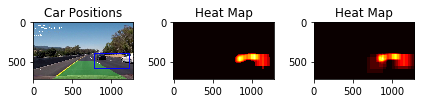

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1086.jpg


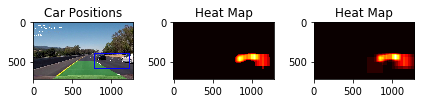

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1087.jpg


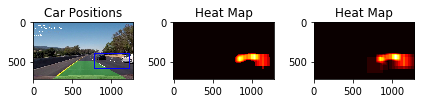

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1088.jpg


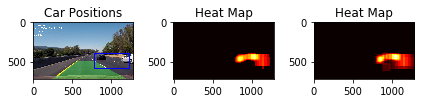

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1089.jpg


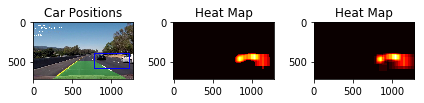

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1090.jpg


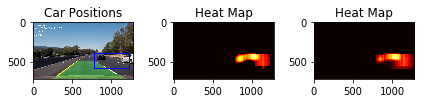

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1091.jpg


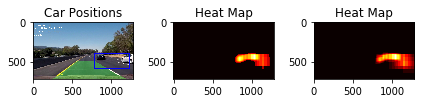

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1092.jpg


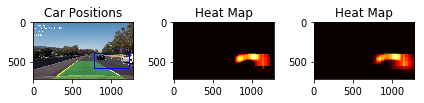

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1093.jpg


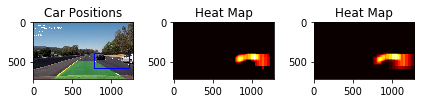

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1094.jpg


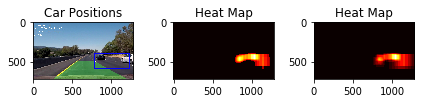

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1095.jpg


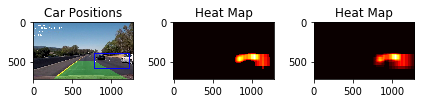

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1096.jpg


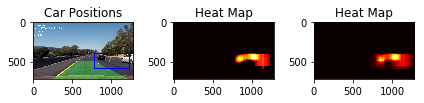

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1097.jpg


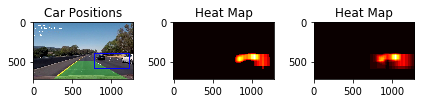

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1098.jpg


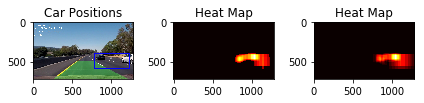

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1099.jpg


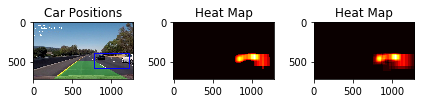

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1100.jpg


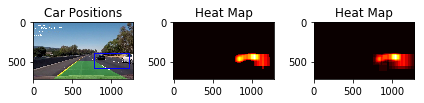

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1101.jpg


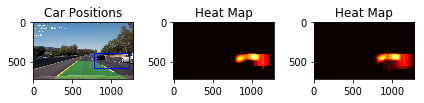

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1102.jpg


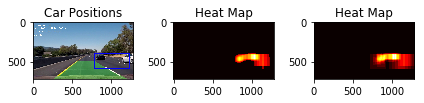

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1103.jpg


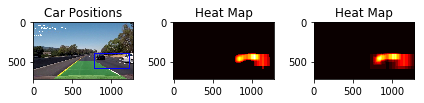

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1104.jpg


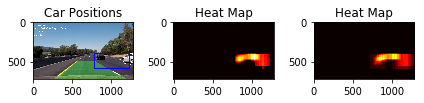

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1105.jpg


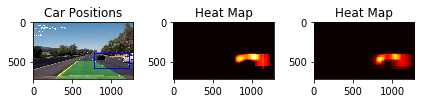

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1106.jpg


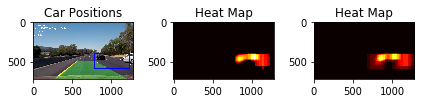

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1107.jpg


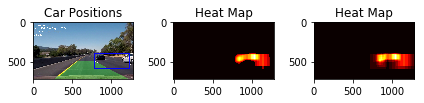

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1108.jpg


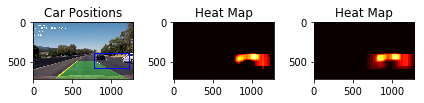

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1109.jpg


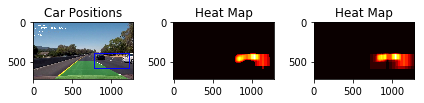

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1110.jpg


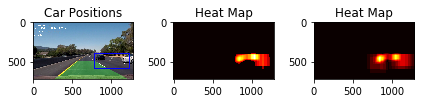

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1111.jpg


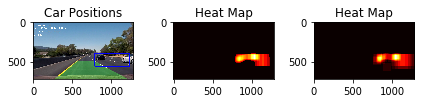

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1112.jpg


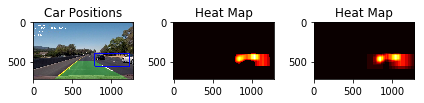

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1113.jpg


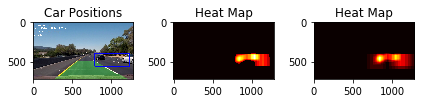

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1114.jpg


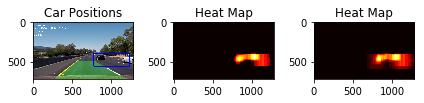

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1115.jpg


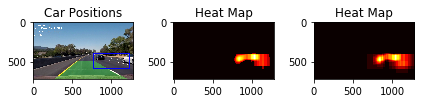

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1116.jpg


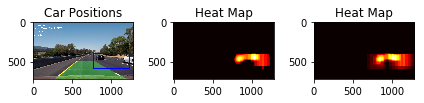

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1117.jpg


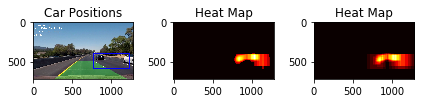

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1118.jpg


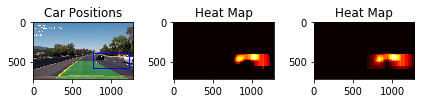

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1119.jpg


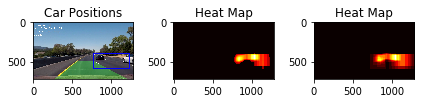

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1120.jpg


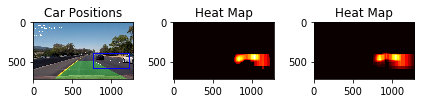

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1121.jpg


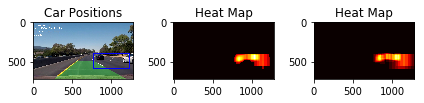

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1122.jpg


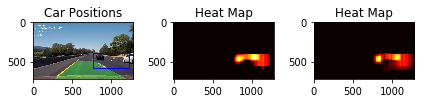

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1123.jpg


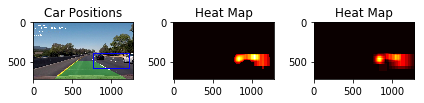

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1124.jpg


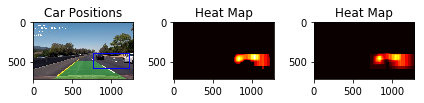

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1125.jpg


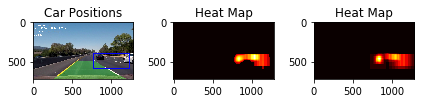

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1126.jpg


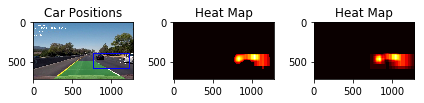

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1127.jpg


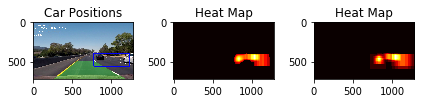

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1128.jpg


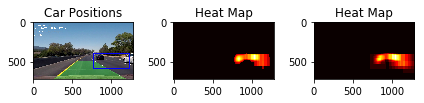

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1129.jpg


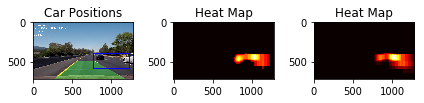

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1130.jpg


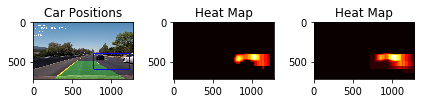

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1131.jpg


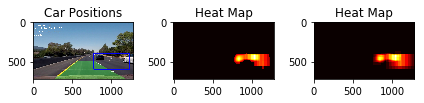

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1132.jpg


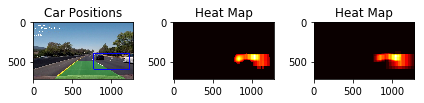

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1133.jpg


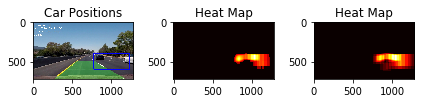

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1134.jpg


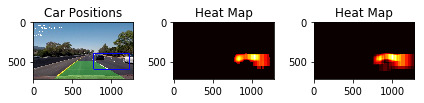

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1135.jpg


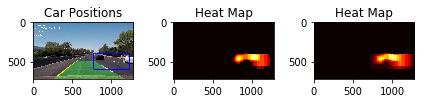

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1136.jpg


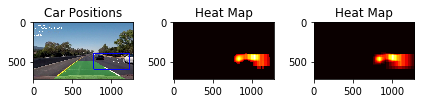

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1137.jpg


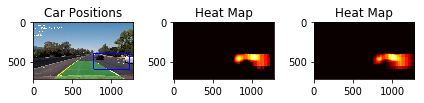

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1138.jpg


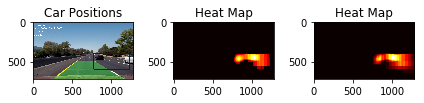

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1139.jpg


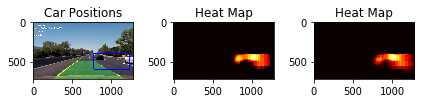

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1140.jpg


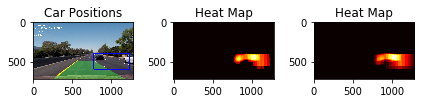

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1141.jpg


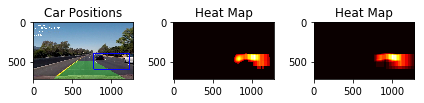

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1142.jpg


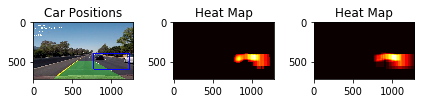

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1143.jpg


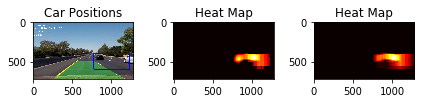

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1144.jpg


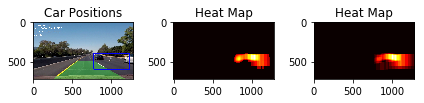

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1145.jpg


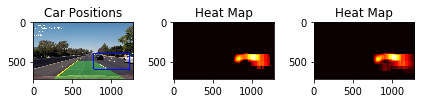

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1146.jpg


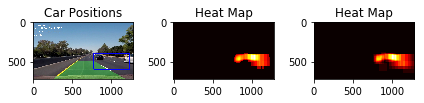

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1147.jpg


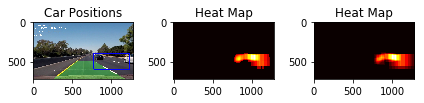

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1148.jpg


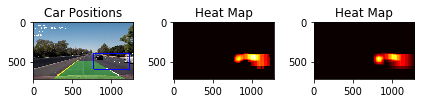

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1149.jpg


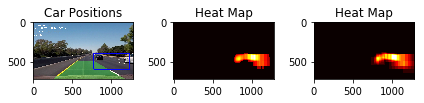

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1150.jpg


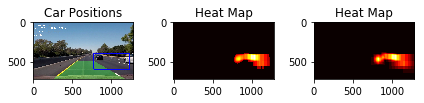

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1151.jpg


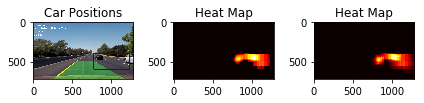

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1152.jpg


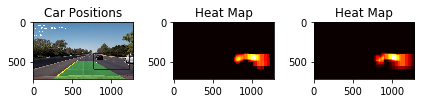

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1153.jpg


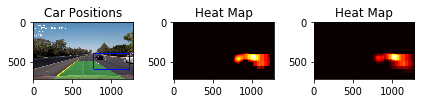

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1154.jpg


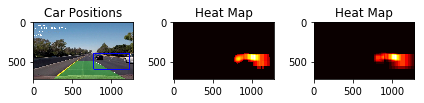

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1155.jpg


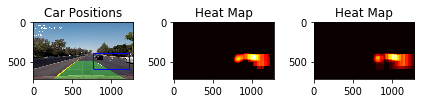

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1156.jpg


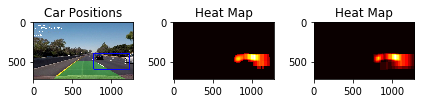

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1157.jpg


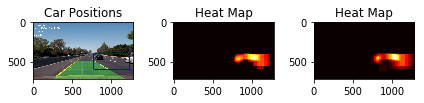

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1158.jpg


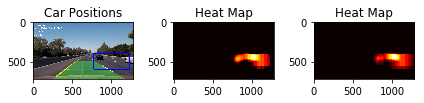

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1159.jpg


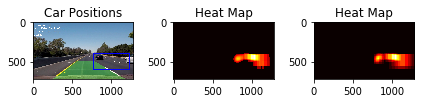

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1160.jpg


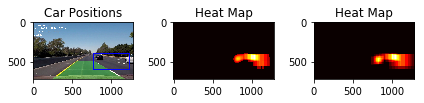

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1161.jpg


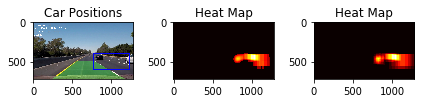

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1162.jpg


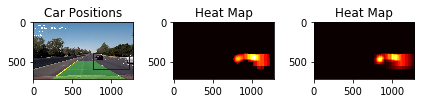

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1163.jpg


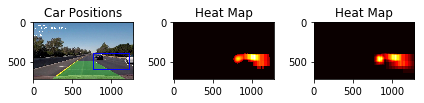

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1164.jpg


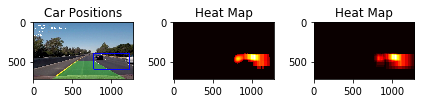

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1165.jpg


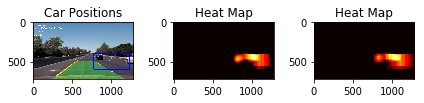

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1166.jpg


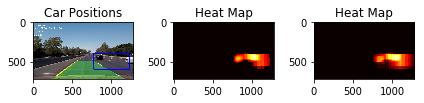

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1167.jpg


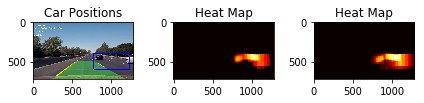

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1168.jpg


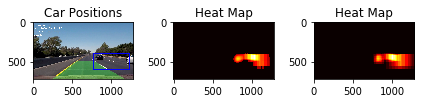

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1169.jpg


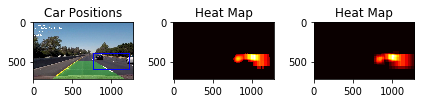

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1170.jpg


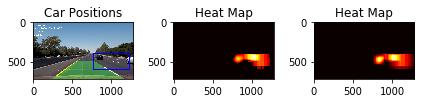

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1171.jpg


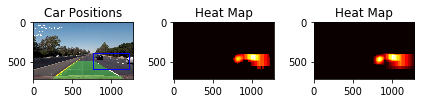

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1172.jpg


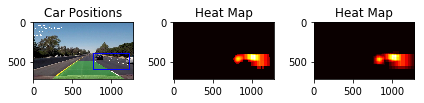

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1173.jpg


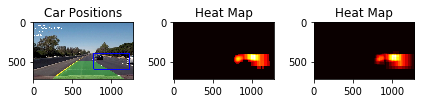

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1174.jpg


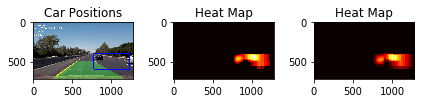

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1175.jpg


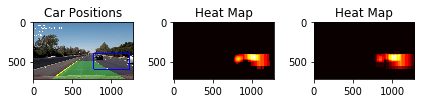

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1176.jpg


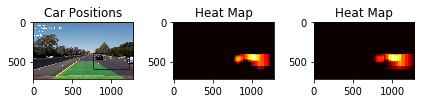

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1177.jpg


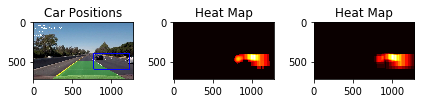

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1178.jpg


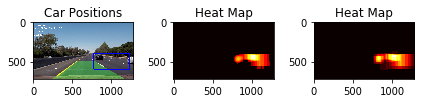

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1179.jpg


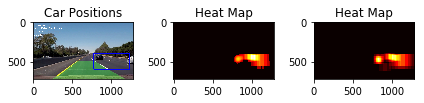

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1180.jpg


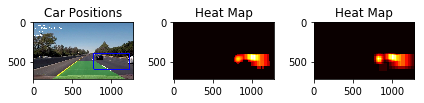

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1181.jpg


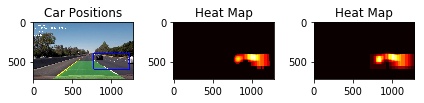

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1182.jpg


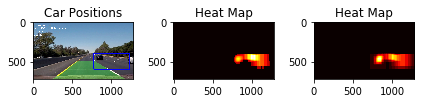

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1183.jpg


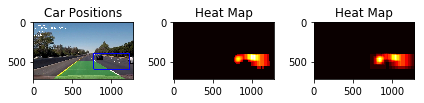

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1184.jpg


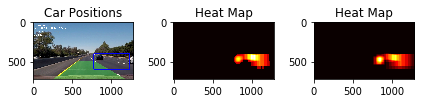

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1185.jpg


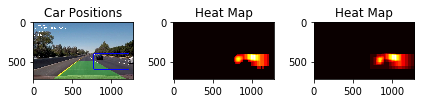

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1186.jpg


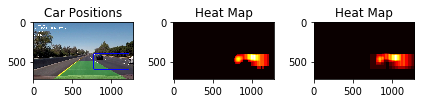

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1187.jpg


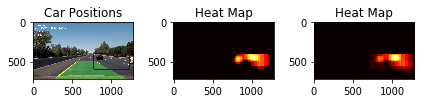

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1188.jpg


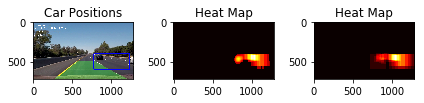

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1189.jpg


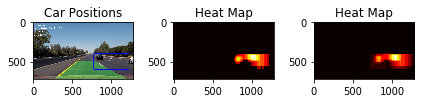

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1190.jpg


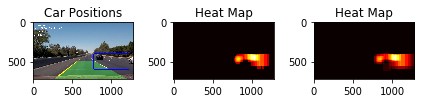

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1191.jpg


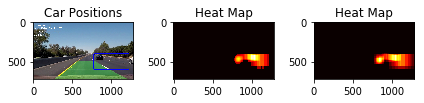

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1192.jpg


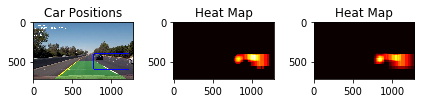

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1193.jpg


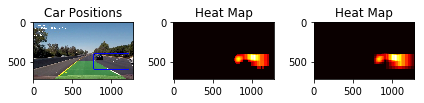

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1194.jpg


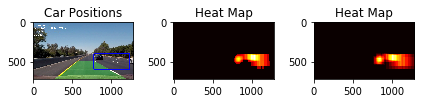

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1195.jpg


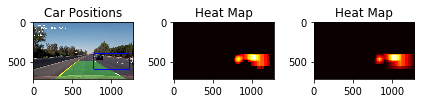

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1196.jpg


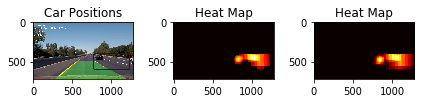

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1197.jpg


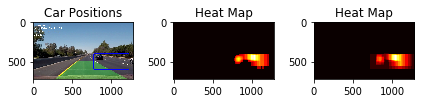

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1198.jpg


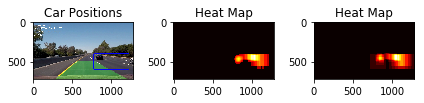

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1199.jpg


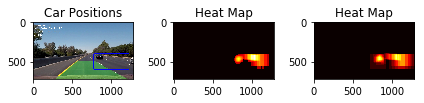

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1200.jpg


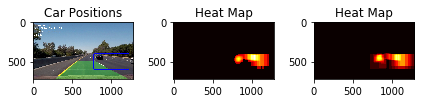

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1201.jpg


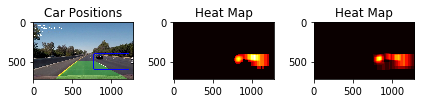

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1202.jpg


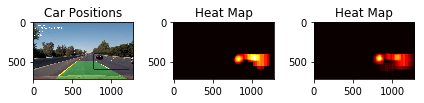

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1203.jpg


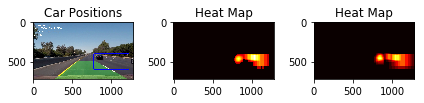

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1204.jpg


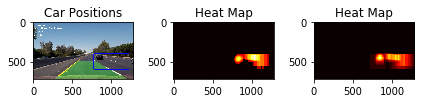

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1205.jpg


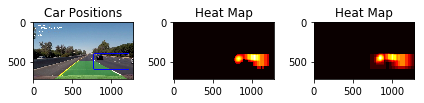

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1206.jpg


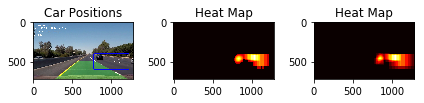

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1207.jpg


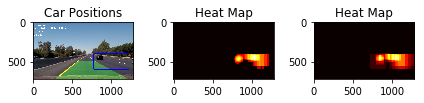

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1208.jpg


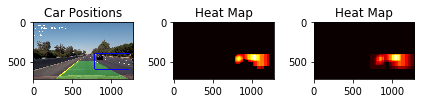

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1209.jpg


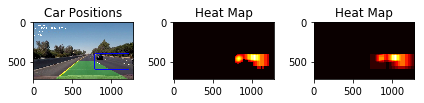

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1210.jpg


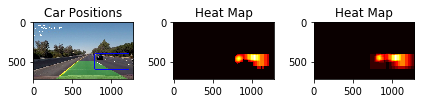

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1211.jpg


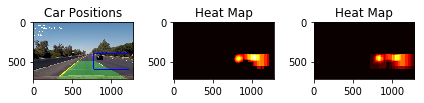

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1212.jpg


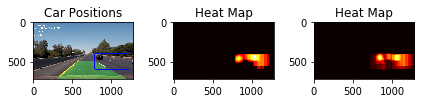

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1213.jpg


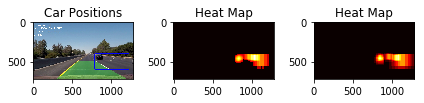

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1214.jpg


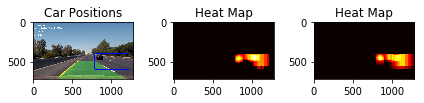

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1215.jpg


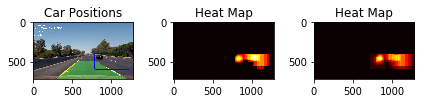

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1216.jpg


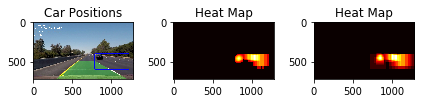

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1217.jpg


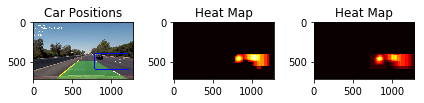

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1218.jpg


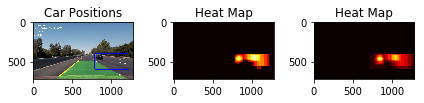

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1219.jpg


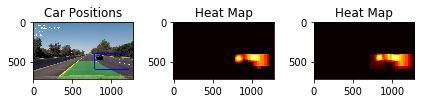

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1220.jpg


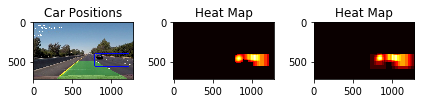

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1221.jpg


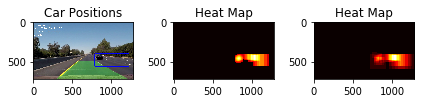

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1222.jpg


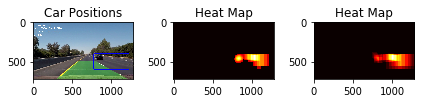

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1223.jpg


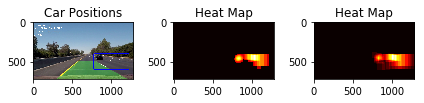

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1224.jpg


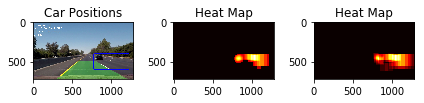

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1225.jpg


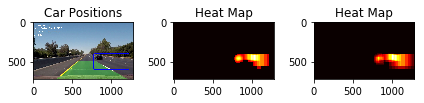

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1226.jpg


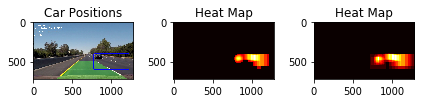

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1227.jpg


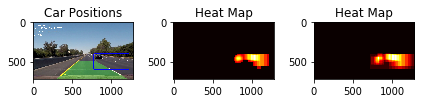

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1228.jpg


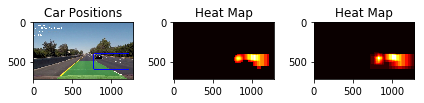

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1229.jpg


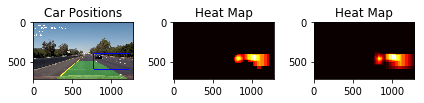

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1230.jpg


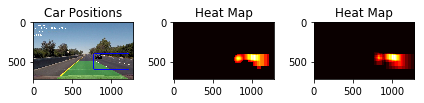

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1231.jpg


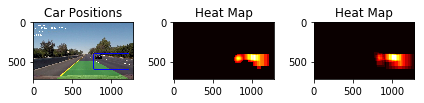

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1232.jpg


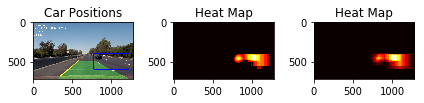

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1233.jpg


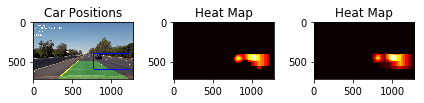

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1234.jpg


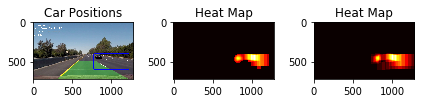

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1235.jpg


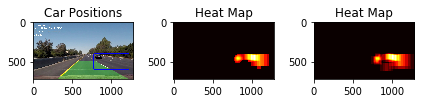

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1236.jpg


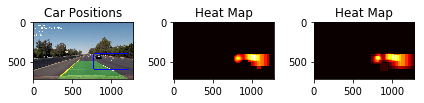

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1237.jpg


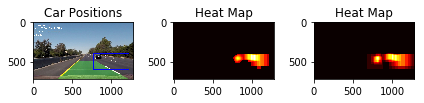

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1238.jpg


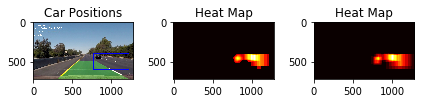

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1239.jpg


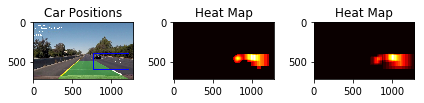

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1240.jpg


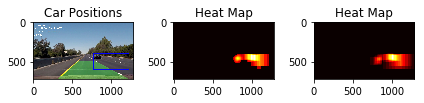

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1241.jpg


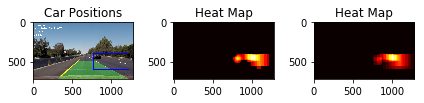

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1242.jpg


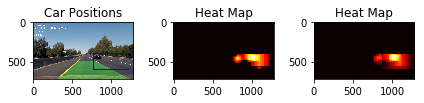

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1243.jpg


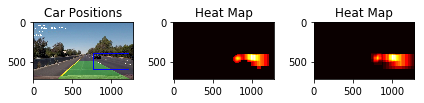

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1244.jpg


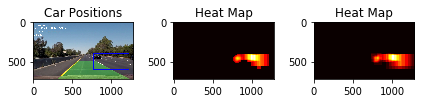

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1245.jpg


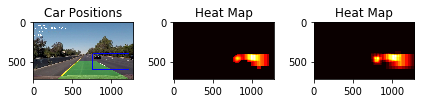

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1246.jpg


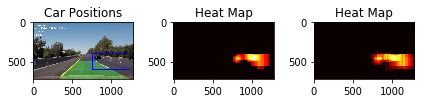

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1247.jpg


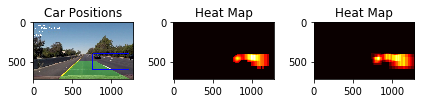

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1248.jpg


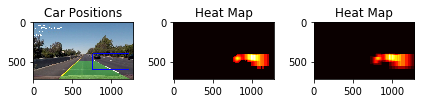

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1249.jpg


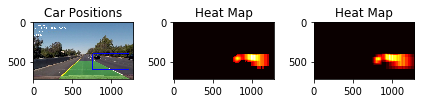

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1250.jpg


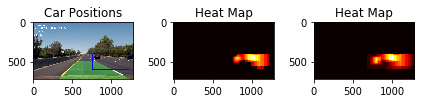

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1251.jpg


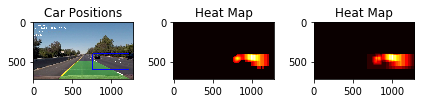

../CarND-Advanced-Lane-Lines-master/output_images\input_frame1252.jpg


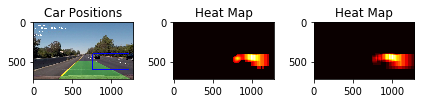

In [113]:
%matplotlib inline
fnames = glob.glob('../CarND-Advanced-Lane-Lines-master/output_images/input_frame****.jpg')
fnames_ld = glob.glob('../CarND-Advanced-Lane-Lines-master/output_images/output_frame****.jpg')

heat_z = np.zeros_like(image[:,:,0]).astype(np.float)
alpha = 0.05

for i, (fname, fname_ld) in enumerate(zip(fnames, fnames_ld)):
    print(fname)

    if i > -1: 
        image = mpimg.imread(fname)

        heat = np.zeros_like(image[:,:,0]).astype(np.float)

        box_fm1, box_fm2 = find_cars(image, windows)   

        # Add heat to each box in box list
        heat = add_heat(heat,box_fm1)

        # Apply threshold to help remove false positives
    #     heat = apply_threshold(heat,6)

        heat_z = alpha*heat + (1-alpha)*heat_z

        heat_cp = np.copy(heat_z)

        # Visualize the heatmap when displaying    
        heatmap = np.clip(heat_cp, 0, 255)

        # Find final boxes from heatmap using label function
        labels = label(apply_threshold(heatmap,4))
        draw_img = draw_labeled_bboxes(np.copy(mpimg.imread(fname_ld)), labels)

        fig = plt.figure()
        plt.subplot(131)
        plt.imshow(draw_img)
        plt.title('Car Positions')
        plt.subplot(132)
        plt.imshow(heatmap, cmap='hot')
        plt.title('Heat Map')
        plt.subplot(133)
        plt.imshow(np.clip(heat, 0, 255), cmap='hot')
        plt.title('Heat Map')
        fig.tight_layout()
        plt.show()
    #     input("Press Enter to continue...")



        cv2.imwrite("./output_images/output_frame%04d.jpg" % i, cv2.cvtColor(draw_img, cv2.COLOR_BGR2RGB))     # save frame as JPEG file

In [ ]:
import imageio
fileList = sorted(glob.glob('./output_images/output_frame*.jpg'))
writer = imageio.get_writer('project_video_out.mp4', fps=20)

for im in fileList:
    writer.append_data(imageio.imread(im))
writer.close()